<a href="https://colab.research.google.com/github/zhus-dika/railways_caclulations/blob/main/regression_arma_models_by_custom_interval.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 🐫 Realize regression model

## 🦀 Download data

### 🪰 Install need packages

In [1]:
! apt install x13as
! pip install pyexcel pyexcel-xls pyexcel-xlsx

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
x13as is already the newest version (1.1-b58-1).
0 upgraded, 0 newly installed, 0 to remove and 29 not upgraded.


### 🐳 Imports

In [2]:
import pandas as pd
import statsmodels.api as sm
import gdown
from datetime import datetime
import copy

from dateutil.relativedelta import relativedelta

import math
import numpy as np

import seaborn as sns

from openpyxl import load_workbook
from statsmodels.stats.outliers_influence import variance_inflation_factor

import matplotlib.pyplot as plt
from tqdm.notebook import tqdm

import itertools
import statsmodels.api as sm

from statsmodels.tsa.x13 import x13_arima_analysis
from statsmodels.tsa.filters.hp_filter import hpfilter

### 🦥 Constants

In [3]:
selected_types = ['Iron', 'Chem', 'Coal', 'Petrol', 'Scrap', 'Chem', 'Fert', 'nFerr']#['Coal', 'Petrol', 'Scrap', 'Chem', 'Fert', 'nFerr', 'Iron', 'Corn']

### 🐻‍❄️ Useful methods

In [4]:
# Functions for sampling over different periods

def get_monthly_data(df, year, month):
    return df.loc[df.index == f"{year}-{month:02d}-01"]

def get_quarterly_data(df, year, quarter):
    return df.loc[df.index.to_period("Q") == f"{year}Q{quarter}"].sum()

def get_semi_annual_data(df, year, half):
    if half == 1:
        return df.loc[df.index.month.isin([1, 2, 3, 4, 5, 6]) & (df.index.year == year)].sum()
    else:
        return df.loc[df.index.month.isin([7, 8, 9, 10, 11, 12]) & (df.index.year == year)].sum()

def get_annual_data(df, year):
    return df.loc[df.index.year == year].sum()

In [5]:
def aggregate_data_by_freq(df, freq='monthly'):
  start = df.index.year[0]
  end = df.index.year[-1]
  dct_aggregated = {i: [] for i in df.columns}
  if freq == 'monthly':
    return df
  elif freq == 'quarterly':

    for key in dct_aggregated.keys():
      for year in range(start, end + 1):
        for quarter in range(1, 5):
            dct_aggregated[key].append(get_quarterly_data(df, year, quarter)[key])

    df_aggregated = pd.DataFrame(dct_aggregated)
    df_aggregated.index = [f"{year}Q{quarter}" for year in range(start, end + 1) for quarter in range(1, 5)]
  elif freq == 'semi-annual':
    for key in dct_aggregated.keys():
      for year in range(start, end + 1):
        for half in range(1, 3):
          dct_aggregated[key].append(get_semi_annual_data(df, year, half)[key])
    df_aggregated = pd.DataFrame(dct_aggregated)
    df_aggregated.index = [f"{year}H{half}" for year in range(start, end + 1) for half in range(1, 3)]
  elif freq == 'annual':
    for key in dct_aggregated.keys():
      for year in range(start, end + 1):
        dct_aggregated[key].append(get_annual_data(df, year)[key])
    df_aggregated = pd.DataFrame(dct_aggregated)
    df_aggregated.index = [f"{year}" for year in range(start, end + 1)]
  return df_aggregated

In [6]:
def construct_serial_data_by_type(type, df, dct_serial):
  serial_dates = {i: [] for i in dct_serial[type]}

  for idx, date in enumerate(df.columns):
    for key, value in serial_dates.items():
      if date == key:
        serial_dates[key].append(1)
      else:
        serial_dates[key].append(0)
  return serial_dates

In [7]:
def convert_quarter_to_datetime(df):
    df = df.copy()
    df.index = pd.to_datetime(
        df.index.str[:4] + "-" + df.index.str[4:].map({"Q1": "03-31", "Q2": "06-30", "Q3": "09-30", "Q4": "12-31"})
    )
    return df

In [8]:
def convert_halfyear_to_datetime(df):
    df = df.copy()
    df.index = pd.to_datetime(
        df.index.str[:4] + "-" + df.index.str[4:].map({"H1": "06-30", "H2": "12-31"})
    )
    return df

In [9]:
def deseasonalize_hp(df, freq='M'):
    """ Удаляет циклическую компоненту HP-фильтром """
    lambda_values = {'M': 129600, 'Q': 1600, '2Q': 100, 'A': 6.25}
    λ = lambda_values.get(freq, 1600)  # По умолчанию берем для квартала

    df_adj = df.copy()
    for col in df.columns:
        try:
            cycle, trend = hpfilter(df[col], lamb=λ)
            df_adj[col] = df[col] - cycle  # Оставляем только тренд
        except Exception as e:
            print(f"Ошибка при обработке {col}: {e}")
    return df_adj


In [10]:
start = 2002
end = 2024

def excel_columns(n):
    columns = []
    for i in range(1, n + 1):
        col = ""
        num = i
        while num > 0:
            num -= 1
            col = chr(65 + (num % 26)) + col
            num //= 26
        columns.append(col)
    return columns

column_names = excel_columns(14 * (end - start + 1))

In [11]:
def fill_transportation_tariffs(table_data, start, end):
  commodities_transportation_tariffs = {datetime.strptime(str(year) + '-' + str(i), '%Y-%m').strftime("%y-%m"): [] for year in range(start, end + 1) for i in range(1, 13)}
  commodities_transportation_tariffs['name'] = []
  name_column = 'A'
  for i in range(1, 82):
    if i % 4 == 0:
      value = table_data[name_column+str(i)].value
      value = value.replace(',', ' ').replace('.', ' ').replace(')', ' ').replace('(', ' ').replace('-', ' ').replace('из ', ' ').replace(' нее:', ' ').replace(' него:', ' ').replace(' них:', ' ').replace("\n", " ").lower()
      name = " ".join(value.split())
      commodities_transportation_tariffs['name'].append(name)

      for column_num in range((end - start + 1) * 12):
        val_volume = table_data[column_names[column_num + 2 + math.floor(column_num / 12)] + str(i + 1)].value
        commodities_transportation_tariffs[datetime.strptime(str(start + math.floor(column_num / 12))  + '-' + str(column_num % 12 + 1), '%Y-%m').strftime("%y-%m")].append(val_volume)
  return commodities_transportation_tariffs

In [12]:
def plot_regression_results(model, df):
  df["fitted"] = model.fittedvalues
  df["residuals"] = model.resid

  # Plot of actual, predicted, and residual values
  fig, ax1 = plt.subplots(figsize=(20, 10))

  # Actual and predicted lines
  ax1.plot(df.index, df["V_SA"], color="red", label="Actual")
  ax1.plot(df.index, df["fitted"], color="green", label="Fitted")

  # Second axis for residuals
  ax2 = ax1.twinx()
  ax2.plot(df.index, df["residuals"], color="blue", label="Residual", alpha=0.7)

  # Add a horizontal line at level 0 for residuals
  ax2.axhline(0, linestyle="--", color="black", linewidth=0.8)

  ax1.legend(loc="upper right")
  ax2.legend(loc="lower right")

  # Axis titles
  ax1.set_xlabel("Date")
  ax1.set_ylabel("Actual & Fitted")
  ax2.set_ylabel("Residuals")


  step = 1#max(10, len(df.columns))  # Количество подписей по X не больше 10

  ax1.set_xticks(df.index[::step])
  ax1.set_xticklabels(df.index[::step], rotation=45, fontsize=11)  # Красиво форматируем

  ax2.set_xticks(df.index[::step])
  ax2.set_xticklabels(df.index[::step], rotation=45, fontsize=11)  # Красиво форматируем
  #ax1.set_xticklabels(ax1.get_xticks(), rotation = 45, fontsize=6)
  plt.title("Actual, Fitted, and Residuals Plot")
  plt.show()

In [13]:
def create_tariff_data(df):
  df_tariff = copy.deepcopy(df)
  # calculate tariffs
  for idx, row in df_tariff.iterrows():
      dt_prev = df_tariff.columns[11]
      for num, dt in enumerate(df_tariff.columns[12:]):

        val = row[dt]

        if val == 0:
          df_tariff.loc[idx, dt] = df_tariff.loc[idx, dt_prev]

        else:
          df_tariff.loc[idx, dt] = (1.0 + val / 100.0) * df_tariff.loc[idx, dt_prev]
        dt_prev = dt
  df_tariff_indexed = copy.deepcopy(df_tariff)
  # calculate indices for tariffs
  for idx, row in df_tariff.iterrows():
    for num, dt in enumerate(df_tariff.columns[12:]):
      dt_prev_year = df_tariff.columns[num]
      df_tariff_indexed.loc[idx, dt] = df_tariff.loc[idx, dt] / df_tariff.loc[idx, dt_prev_year]
  return df_tariff_indexed

## 🐟 Read data

### 🐺 Getting volumes data

In [14]:
url = "https://drive.google.com/uc?id=1sTB0h1oSMJIKQxXkdIbcihlg2BJraPbV"
volumes = 'volumes_2002-2024.xlsx'
gdown.download(url, volumes, quiet=False);

df_volumes = pd.read_excel(volumes, index_col='type')

Downloading...
From: https://drive.google.com/uc?id=1sTB0h1oSMJIKQxXkdIbcihlg2BJraPbV
To: /content/volumes_2002-2024.xlsx
100%|██████████| 98.9k/98.9k [00:00<00:00, 36.9MB/s]


In [15]:
df_volumes_by_type = df_volumes.groupby(by='type').sum().drop(columns=['name'])
df_volumes_by_type.sample(5)

,1_2002,2_2002,3_2002,4_2002,5_2002,6_2002,7_2002,8_2002,9_2002,10_2002,...,3_2024,4_2024,5_2024,6_2024,7_2024,8_2024,9_2024,10_2024,11_2024,12_2024
type,,,,,,,,,,,,,,,,,,,,,
Chem,1935.0,1012.0,734.0,2647.0,1055.0,1788.0,1553.0,946.0,1027.0,912.0,...,8455.0,10215.0,10818.0,10581.0,10668.0,12594.0,12597.0,10971.0,10287.0,9972.0
Drinks,42731.0,39743.3,59957.8,62795.4,76710.4,84544.0,95212.6,85758.5,66376.6,63148.6,...,347466.1,341382.2,393951.0,374869.8,407642.2,384535.2,305165.1,296665.0,297650.9,292052.6
Lim,347.9,314.9,356.2,399.4,483.0,490.0,598.2,663.1,561.1,611.1,...,1597.2,1551.8,1437.8,1559.9,1631.3,1723.6,1675.5,1695.2,1765.9,1469.5
Earth,574.8,664.5,809.4,939.4,1106.2,1195.9,1418.6,1333.6,1393.0,1702.5,...,65315.5,100400.1,84678.0,77052.2,99341.2,108005.7,116855.8,118458.2,124841.1,117693.0
nFerr,264848.0,241364.0,253442.0,262762.0,265939.0,257762.0,265212.0,282856.0,271700.0,266316.0,...,303955.0,292337.0,295382.0,282042.0,290906.0,294562.0,287356.0,276083.0,276168.0,317713.0


🦐 Change date format

In [16]:
df_volumes_by_type = df_volumes_by_type.T

df_volumes_by_type.index = pd.to_datetime(df_volumes_by_type.index.str.replace("_", "-"), format="%m-%Y")

df_volumes_by_type.sample(7)

type,Black,Cement,Chem,Coal,Coke,ColOre,Corn,Drinks,Earth,Fert,Iron,Lim,Oil,Petrol,Scrap,Wheat,nFerr
2012-07-01,487381.0,745.2,4222.0,8317.2,216.3,7786.7,1072.066667,241584.5,3510.8,163302.8,4477.0,940.8,5680.6,966.2,169191.0,322433.0,304660.0
2007-12-01,566832.0,187.1,4540.0,10349.2,194.6,6326.1,1678.150000,118142.0,5473.2,89155.9,4314.1,1102.1,4851.4,1045.6,271142.0,245951.0,279333.0
2002-04-01,460612.0,174.8,2647.0,4195.0,216.2,5726.0,1329.991667,62795.4,939.4,73261.3,3012.2,399.4,3373.6,660.6,315348.0,140429.0,262762.0
2017-03-01,562282.0,582.4,5361.0,9532.9,269.6,13006.3,1715.425000,197547.0,5676.3,275795.6,3459.8,1250.3,6241.6,1041.8,252083.0,379192.0,330235.0
2008-11-01,314613.0,226.5,4197.0,9976.1,141.6,6029.1,1298.183333,98650.4,4420.2,121528.3,1939.0,1099.7,4905.2,953.2,161308.0,319594.0,268686.0
2014-05-01,503014.0,864.0,7297.0,6557.9,235.5,8114.3,1430.183333,251742.1,3609.8,222302.0,4393.1,1119.6,5538.4,1189.1,236755.0,284794.0,284342.0
2022-12-01,450442.0,463.3,8108.0,10844.5,201.8,17396.3,1835.875000,312273.9,25279.2,257088.8,3835.8,1395.6,6887.5,1320.4,226589.0,320491.0,259638.0


In [17]:
df_volumes_all = {
    'monthly': aggregate_data_by_freq(df_volumes_by_type, freq='monthly'),
    'quarterly': aggregate_data_by_freq(df_volumes_by_type, freq='quarterly'),
    'semi-annual': aggregate_data_by_freq(df_volumes_by_type, freq='semi-annual'),
    'annual': aggregate_data_by_freq(df_volumes_by_type, freq='annual')
              }

In [18]:
df_volumes_all['quarterly'].head(7)

,Black,Cement,Chem,Coal,Coke,ColOre,Corn,Drinks,Earth,Fert,Iron,Lim,Oil,Petrol,Scrap,Wheat,nFerr
2002Q1,1506459.0,270.9,3681.0,18277.3,649.9,15539.3,3989.975,142432.1,2048.7,219032.7,7716.6,1019.0,9749.1,1690.7,965107.0,387240.0,759654.0
2002Q2,1455732.0,607.2,5490.0,12581.3,656.3,17094.0,3989.975,224049.8,3241.5,204014.3,8544.9,1372.4,10003.6,1802.8,971214.0,433062.0,786463.0
2002Q3,1512640.0,793.0,3526.0,19938.8,653.7,17737.8,3989.975,247347.7,4145.2,211237.8,8387.1,1822.4,10938.4,1850.3,985063.0,460447.0,819768.0
2002Q4,1623596.0,458.3,3668.0,22426.0,662.7,17911.0,3989.975,178362.2,4170.4,211965.5,8871.2,1795.1,11282.1,2113.5,1045193.0,562743.0,814856.0
2003Q1,1562516.0,292.8,3180.0,22756.0,646.4,16628.1,3694.350,147120.0,2813.7,202134.2,8783.9,1209.4,10854.8,2038.4,1015674.0,501928.0,754643.0
2003Q2,1570505.0,731.3,3243.0,17573.4,657.0,17619.2,3694.350,249361.8,4465.5,227438.7,9622.2,1536.9,11206.1,2400.5,1001248.0,526039.0,773710.0
2003Q3,1660035.0,963.0,2976.0,18526.0,663.8,17641.3,3694.350,291687.5,5349.1,238715.6,10830.5,1840.4,10960.4,2156.3,1079830.0,463430.0,786725.0


🐹 Plot volumes

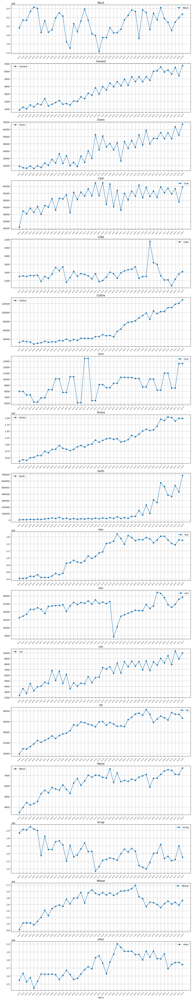

In [19]:
df = df_volumes_all['semi-annual']

fig, axes = plt.subplots(df.shape[1], 1, figsize=(15, 1.8 * len(df)), sharex=False)

for ax, cargo in zip(axes, df.columns):
    ax.plot(df.index, df[cargo], marker="o", label=cargo)
    ax.set_title(cargo)
    ax.grid()
    ax.legend()

    step = 1#max(1, len(df_transportation_volumes.columns))  # Количество подписей по X не больше 10
    ax.set_xticks(df.index[::step])
    ax.set_xticklabels(df.index[::step], rotation=45, fontsize=5)  # Красиво форматируем

plt.xlabel("Дата")
plt.show()

### 🐤 Getting transportation volumes data

In [20]:
url = "https://drive.google.com/uc?id=1ghvXtQCnF6Er9bdcjqXTeXk0TLX7LOVY"
transportation_volumes = 'transportation_volumes_2002_2024.xlsx'
gdown.download(url, transportation_volumes, quiet=False);


df_transportation_volumes = pd.read_excel(transportation_volumes, index_col='type')

Downloading...
From: https://drive.google.com/uc?id=1ghvXtQCnF6Er9bdcjqXTeXk0TLX7LOVY
To: /content/transportation_volumes_2002_2024.xlsx
100%|██████████| 35.8k/35.8k [00:00<00:00, 37.9MB/s]


🦀 Change date format

In [21]:
df_transportation_volumes_by_type = df_transportation_volumes.T

df_transportation_volumes_by_type.index = pd.to_datetime(df_transportation_volumes_by_type.index.str.replace("_", "-"), format="%m-%Y")

df_transportation_volumes_by_type.sample(7)

type,Coal,Iron,Oil,Petrol,Corn,Scrap,Chem,Fert,ColOre,nFerr,Black
2002-03-01,1517.16100,824.25800,985.89300,168.99300,401.05500,44.88500,24.63900,78.32400,146.58400,75.15700,407.20800
2013-02-01,3021.04196,1357.91695,1116.05692,593.67759,380.77273,79.26179,325.18401,48.11818,146.15406,73.25276,291.30157
2005-04-01,2060.54900,1304.57600,790.64000,431.27200,138.84100,221.31900,144.22000,18.62600,141.96800,75.98900,358.56600
2010-08-01,2709.39930,1489.17699,1167.77584,636.56412,366.52189,54.44716,379.21935,20.21952,154.52760,84.48892,397.24008
2003-12-01,2571.39100,1014.03800,804.14000,212.71500,293.52700,59.75000,94.75600,37.27500,154.98000,44.23500,346.49300
2011-12-01,3168.60856,1206.40944,1179.18456,555.77520,951.71914,36.51303,339.82998,35.61393,167.84305,87.60969,418.32932
2015-10-01,2995.41145,573.24475,30.54237,580.12752,541.47097,47.34123,196.09251,34.56073,150.40210,87.84765,314.92693


In [22]:
df_transportation_volumes_all = {
    'monthly': aggregate_data_by_freq(df_transportation_volumes_by_type, freq='monthly'),
    'quarterly': aggregate_data_by_freq(df_transportation_volumes_by_type, freq='quarterly'),
    'semi-annual': aggregate_data_by_freq(df_transportation_volumes_by_type, freq='semi-annual'),
    'annual': aggregate_data_by_freq(df_transportation_volumes_by_type, freq='annual')
              }

In [23]:
df_transportation_volumes_all['annual'].head(7)

,Coal,Iron,Oil,Petrol,Corn,Scrap,Chem,Fert,ColOre,nFerr,Black
2002,24261.411,10974.245,10350.583,2141.872,3774.203,1417.946,356.700,558.051,1828.455,925.873,4809.686
2003,28753.639,12015.870,9558.821,3064.120,5421.862,1407.800,777.278,373.325,1961.290,822.769,4963.075
2004,26268.704,13021.501,10116.151,3706.703,2533.363,1969.216,1304.678,689.179,1955.542,958.213,5744.987
2005,26839.437,11288.867,8499.647,4389.200,1618.414,2260.481,1784.402,348.688,1727.954,874.907,5094.478
2006,30913.478,17072.700,10144.665,4756.418,3876.694,1771.792,2462.219,235.971,1742.504,919.227,4912.324
2007,28445.760,16716.772,9543.114,5719.615,6107.173,1537.773,2732.132,371.130,1889.891,867.627,5319.652
2008,36901.704,15624.363,10816.934,5466.692,5443.858,1685.031,2728.826,652.372,1812.691,999.577,5016.732


🐌 Plot transportation volumes

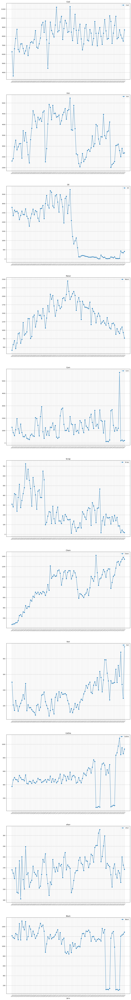

In [24]:
df = df_transportation_volumes_all['quarterly']

fig, axes = plt.subplots(df.shape[1], 1, figsize=(16, 1.4 * len(df)), sharex=False)

for ax, cargo in zip(axes, df.columns):
    ax.plot(df.index, df[cargo], marker="o", label=cargo)
    ax.set_title(cargo)
    ax.grid()
    ax.legend()

    step = 1#max(1, len(df_transportation_volumes.columns))  # Количество подписей по X не больше 10
    ax.set_xticks(df.index[::step])
    ax.set_xticklabels(df.index[::step], rotation=45, fontsize=5)  # Красиво форматируем

plt.xlabel("Дата")
plt.show()

### 🐭 Prepare indexed data

🦭 Volumes data

In [25]:
df_volumes_indexed = copy.deepcopy(df_volumes_all)

In [26]:
for key in df_volumes_indexed.keys():
  for column in df_volumes_indexed[key].columns:
    for date in df_volumes_indexed[key].index:
      if key == 'monthly':
        date_prev = date - relativedelta(years=1)
        year = int(date.year)
      else:
        year = int(date[:4])
        freq_num = ''
        if len(date) > 4:
          freq_num = date[4:]
        date_prev = str(year - 1) + freq_num

      if year == 2002:
        df_volumes_indexed[key].loc[date, column] = 0
      else:
        df_volumes_indexed[key].loc[date, column] = df_volumes_all[key].loc[date, column] / df_volumes_all[key].loc[date_prev, column]

In [27]:
df_volumes_indexed['semi-annual'].sample(5)

,Black,Cement,Chem,Coal,Coke,ColOre,Corn,Drinks,Earth,Fert,Iron,Lim,Oil,Petrol,Scrap,Wheat,nFerr
2021H2,1.038724,1.097330,1.163276,1.053544,0.803694,0.984021,0.816130,1.259374,1.853177,1.132508,1.331325,1.073037,1.084881,1.056803,1.169307,0.906868,0.949885
2007H2,1.130941,1.302445,1.442834,1.004539,1.057977,1.084449,1.219623,1.174794,1.246057,1.069011,1.011683,0.980329,1.004670,0.955302,1.151521,1.075495,0.957750
2007H1,1.112415,1.314479,1.286795,0.951534,1.209891,1.020401,1.219623,1.195881,1.094556,1.260548,1.019158,1.121815,1.002445,1.068557,1.135517,1.230613,0.997063
2002H2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2009H1,0.776470,0.943362,0.756486,0.806872,0.830883,0.992471,1.337157,0.899280,0.685863,1.529864,0.971408,0.790716,1.052500,0.869224,0.990160,1.050053,1.007496


In [28]:
df_volumes_indexed_adjusted = {}

for key in df_volumes_indexed.keys():
  df = copy.deepcopy(df_volumes_indexed[key])
  df_converted = copy.deepcopy(df)

  if key == 'quarterly':
    df_converted = convert_quarter_to_datetime(df)
  elif key == 'semi-annual':
    df_converted = convert_halfyear_to_datetime(df)
  df_volumes_indexed_adjusted[key] = deseasonalize_hp(df_converted, freq=key)

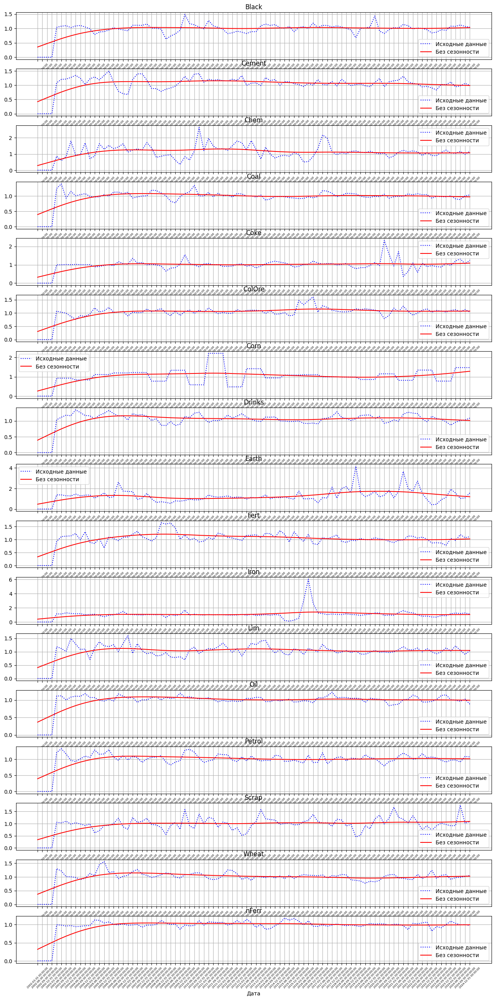

In [29]:
freq = 'quarterly'

fig, axes = plt.subplots(df_volumes_indexed[freq].shape[1], 1, figsize=(16, 1.4 * len(df)), sharex=False)

for ax, cargo in zip(axes, df_volumes_indexed[freq].columns):
    ax.plot(df_volumes_indexed_adjusted[freq].index, df_volumes_indexed[freq][cargo], label="Исходные данные", linestyle="dotted", color="blue")
    ax.plot(df_volumes_indexed_adjusted[freq].index, df_volumes_indexed_adjusted[freq][cargo], label="Без сезонности", color="red")
    ax.set_title(cargo)
    ax.grid()
    ax.legend()

    step = 1#max(1, len(df_transportation_volumes.columns))  # Количество подписей по X не больше 10
    ax.set_xticks(df_volumes_indexed_adjusted[freq].index[::step])
    ax.set_xticklabels(df_volumes_indexed_adjusted[freq].index[::step], rotation=45, fontsize=5)  # Красиво форматируем

plt.xlabel("Дата")
plt.show()

🦏 Transportation volumes data

In [30]:
df_transportation_volumes_indexed = copy.deepcopy(df_transportation_volumes_all)

In [31]:
for key in df_transportation_volumes_indexed.keys():
  for column in df_transportation_volumes_indexed[key].columns:
    for date in df_transportation_volumes_indexed[key].index:
      if key == 'monthly':
        date_prev = date - relativedelta(years=1)
        year = int(date.year)
      else:
        year = int(date[:4])
        freq_num = ''
        if len(date) > 4:
          freq_num = date[4:]
        date_prev = str(year - 1) + freq_num

      if year == 2002:
        df_transportation_volumes_indexed[key].loc[date, column] = 0
      else:
        df_transportation_volumes_indexed[key].loc[date, column] = df_transportation_volumes_all[key].loc[date, column] / df_transportation_volumes_all[key].loc[date_prev, column]

In [32]:
df_transportation_volumes_indexed['semi-annual'].sample(5)

,Coal,Iron,Oil,Petrol,Corn,Scrap,Chem,Fert,ColOre,nFerr,Black
2014H2,0.973545,0.876916,0.270383,1.028512,0.711273,0.689193,0.980090,1.126409,0.984662,0.929077,1.095166
2010H1,1.400186,1.319853,1.019933,1.274968,1.780744,1.287672,1.272830,1.191910,1.009126,1.059651,1.039504
2009H1,0.643057,0.791957,1.128058,1.035956,0.419085,0.302439,1.122446,0.539710,1.043186,0.906192,0.791569
2009H2,0.926920,1.408724,1.245038,1.447166,1.171685,0.698856,1.459393,0.333368,1.062851,0.779516,1.094369
2022H2,0.974506,0.573475,3.374031,1.042041,6.804470,0.969290,0.887960,1.247575,0.145385,0.999501,8.876084


In [33]:
df_transportation_volumes_indexed_adjusted = {}

for key in df_transportation_volumes_indexed.keys():
  df = copy.deepcopy(df_transportation_volumes_indexed[key])
  df_converted = copy.deepcopy(df)

  if key == 'quarterly':
    df_converted = convert_quarter_to_datetime(df)
  elif key == 'semi-annual':
    df_converted = convert_halfyear_to_datetime(df)
  df_transportation_volumes_indexed_adjusted[key] = deseasonalize_hp(df_converted, freq=key)

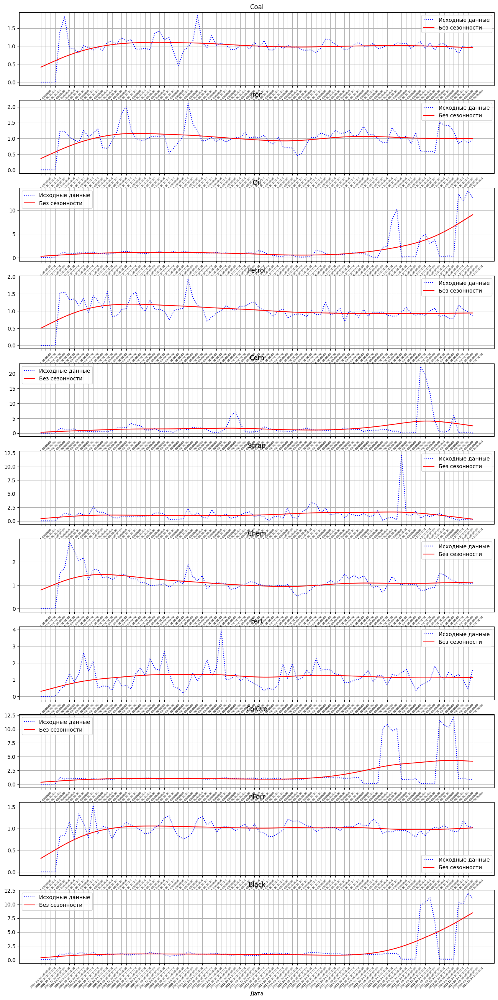

In [34]:
freq = 'quarterly'

fig, axes = plt.subplots(df_transportation_volumes_indexed[freq].shape[1], 1, figsize=(16, 1.4 * len(df)), sharex=False)

for ax, cargo in zip(axes, df_transportation_volumes_indexed[freq].columns):
    ax.plot(df_transportation_volumes_indexed_adjusted[freq].index, df_transportation_volumes_indexed[freq][cargo], label="Исходные данные", linestyle="dotted", color="blue")
    ax.plot(df_transportation_volumes_indexed_adjusted[freq].index, df_transportation_volumes_indexed_adjusted[freq][cargo], label="Без сезонности", color="red")
    ax.set_title(cargo)
    ax.grid()
    ax.legend()

    step = 1#max(1, len(df_transportation_volumes.columns))  # Количество подписей по X не больше 10
    ax.set_xticks(df_transportation_volumes_indexed_adjusted[freq].index[::step])
    ax.set_xticklabels(df_transportation_volumes_indexed_adjusted[freq].index[::step], rotation=45, fontsize=5)  # Красиво форматируем

plt.xlabel("Дата")
plt.show()

## 🦑 Prepare indexed tariff data

In [35]:
url = "https://drive.google.com/uc?id=1BtFPuxKd6XAhILhfeesl5QnWgZ8o5roO"
tariff = 'tariff.xlsx'
gdown.download(url, tariff, quiet=False);

Downloading...
From: https://drive.google.com/uc?id=1BtFPuxKd6XAhILhfeesl5QnWgZ8o5roO
To: /content/tariff.xlsx
100%|██████████| 2.70M/2.70M [00:00<00:00, 179MB/s]


In [36]:
wb = load_workbook(tariff)

main_sheet = 'Тариф'
commodities_transportation_tariffs = {}

In [37]:
end = 2024
column_names = excel_columns(14 * (end - start + 1))

commodities_transportation_tariffs =  fill_transportation_tariffs(wb[main_sheet], start, end)

In [38]:
df_transportation_tariff = pd.DataFrame(commodities_transportation_tariffs)

In [39]:
df_transportation_tariff.head()

,02-01,02-02,02-03,02-04,02-05,02-06,02-07,02-08,02-09,02-10,...,24-04,24-05,24-06,24-07,24-08,24-09,24-10,24-11,24-12,name
0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.00,...,0.0,0.0,8.8,0.0,0.0,0.0,0.0,0.0,7.8,уголь
1,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,0.0,0.0,8.8,0.0,0.0,0.0,0.0,0.0,7.8,железная руда
2,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,0.0,0.0,8.8,0.0,0.0,0.0,0.0,0.0,7.8,нефть сырая
3,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,0.0,0.0,8.8,0.0,0.0,0.0,0.0,0.0,7.8,нефтепродукты
4,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,0.0,0.0,8.8,0.0,0.0,0.0,0.0,0.0,7.8,строительные грузы


In [40]:
dct_names = {'Coal': 'Уголь',
            'Iron': 'Железная руда',
            'Earth': 'Земля, песок, глина и камни природные',
            'Lim': 'Известняк для флюсования',
            'Coke': 'Кокс каменноугольный',
            'Black': 'Чер. металлы',
            'Scrap': 'Лом черных металлов',
            'Wheat': 'Мука пшеничная',
            'Oil': 'Нефть сырая',
            'Petrol': 'Нефтепродукты',
            'Drinks': 'Соки и напитки',
            'Fert': 'Хим. и мин. удобрения',
            'nFerr': 'Цвет. металлы',
            'ColOre': 'Цветная руда',
            'Chem': 'Химикаты и сода',
            'Cement': 'Цемент',
            'Corn': 'Зерно'
            }

In [41]:
for key in dct_names.keys():
  dct_names[key] = " ".join(dct_names[key].replace(',', ' ').replace('.', ' ').replace(')', ' ').replace('(', ' ').replace('-', ' ').lower().split())

In [42]:
common_names = list(set(dct_names.keys()) & set(df_volumes_indexed_adjusted[freq].columns) & set(df_transportation_volumes_indexed_adjusted[freq].columns))

### 🐻 Select data with common names

In [43]:
for key in df_volumes_indexed_adjusted.keys():

  df_volumes_indexed_adjusted[key] = df_volumes_indexed_adjusted[key][common_names]

  df_transportation_volumes_indexed_adjusted[key] = df_transportation_volumes_indexed_adjusted[key][common_names]

In [44]:
df_transportation_tariff['type'] = ''

for idx, row in df_transportation_tariff.iterrows():
  for key in dct_names.keys():
    if dct_names[key] == row['name']:
      df_transportation_tariff.loc[idx, 'type'] = key

In [45]:
df_transportation_tariff.sample(5)

,02-01,02-02,02-03,02-04,02-05,02-06,02-07,02-08,02-09,02-10,...,24-05,24-06,24-07,24-08,24-09,24-10,24-11,24-12,name,type
17,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,0.0,8.8,0.0,0.0,0.0,0.0,0.0,7.8,кокс каменноугольный,Coke
8,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,0.0,8.8,0.0,0.0,0.0,0.0,0.0,7.8,хим и мин удобрения,Fert
10,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,0.0,8.8,0.0,0.0,0.0,0.0,0.0,7.8,цвет металлы,nFerr
13,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,0.0,8.8,0.0,0.0,0.0,0.0,0.0,7.8,цемент,Cement
11,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,0.0,8.8,0.0,0.0,0.0,0.0,0.0,7.8,чер металлы,Black


In [46]:
df_transportation_tariff = df_transportation_tariff[df_transportation_tariff['type'].isin(common_names)]

In [47]:
df_transportation_tariff.sample(5)

,02-01,02-02,02-03,02-04,02-05,02-06,02-07,02-08,02-09,02-10,...,24-05,24-06,24-07,24-08,24-09,24-10,24-11,24-12,name,type
8,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,0.0,8.8,0.0,0.0,0.0,0.0,0.0,7.8,хим и мин удобрения,Fert
10,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,0.0,8.8,0.0,0.0,0.0,0.0,0.0,7.8,цвет металлы,nFerr
11,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,0.0,8.8,0.0,0.0,0.0,0.0,0.0,7.8,чер металлы,Black
3,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,0.0,8.8,0.0,0.0,0.0,0.0,0.0,7.8,нефтепродукты,Petrol
5,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,0.0,8.8,0.0,0.0,0.0,0.0,0.0,7.8,зерно,Corn


In [48]:
df_transportation_tariff.set_index('type', inplace=True)

## 🐰 Convert tariff data 2 float and calculate indexed values

In [49]:
# for column_num in df_transportation_tariff.columns:
#   if column_num != 'name':
#       df_transportation_tariff.loc[:, column_num] = df_transportation_tariff[column_num].astype(float) / 100 + 1.0
for column_num in df_transportation_tariff.columns:
  if column_num != 'name':
      df_transportation_tariff[column_num] = df_transportation_tariff[column_num].astype(float)

<ipython-input-49-026bfdb7a3e9>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_transportation_tariff[column_num] = df_transportation_tariff[column_num].astype(float)
<ipython-input-49-026bfdb7a3e9>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_transportation_tariff[column_num] = df_transportation_tariff[column_num].astype(float)
<ipython-input-49-026bfdb7a3e9>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = v

In [50]:
df_transportation_tariff.drop(columns=['name'], inplace=True)

In [51]:
df_transportation_tariff_indexed = create_tariff_data(df_transportation_tariff)
df_transportation_tariff_indexed

,02-01,02-02,02-03,02-04,02-05,02-06,02-07,02-08,02-09,02-10,...,24-03,24-04,24-05,24-06,24-07,24-08,24-09,24-10,24-11,24-12
type,,,,,,,,,,,,,,,,,,,,,
Coal,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.00,...,1.33536,1.33536,1.04,1.13152,1.13152,1.13152,1.13152,1.13152,1.13152,1.219779
Iron,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,1.33536,1.33536,1.04,1.13152,1.13152,1.13152,1.13152,1.13152,1.13152,1.219779
Oil,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,1.33536,1.33536,1.04,1.13152,1.13152,1.13152,1.13152,1.13152,1.13152,1.219779
Petrol,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,1.33536,1.33536,1.04,1.13152,1.13152,1.13152,1.13152,1.13152,1.13152,1.219779
Corn,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,1.33536,1.33536,1.04,1.13152,1.13152,1.13152,1.13152,1.13152,1.13152,1.219779
Scrap,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,1.33536,1.33536,1.04,1.13152,1.13152,1.13152,1.13152,1.13152,1.13152,1.219779
Chem,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,1.33536,1.33536,1.04,1.13152,1.13152,1.13152,1.13152,1.13152,1.13152,1.219779
Fert,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,1.33536,1.33536,1.04,1.13152,1.13152,1.13152,1.13152,1.13152,1.13152,1.219779
ColOre,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.02,...,1.33536,1.33536,1.04,1.13152,1.13152,1.13152,1.13152,1.13152,1.13152,1.219779


🦓 Prepare tariff adjustment data

In [52]:
df_transportation_tariff_indexed = df_transportation_tariff_indexed.T

df_transportation_tariff_indexed.index = pd.to_datetime(df_transportation_tariff_indexed.index, format="%y-%m")

df_transportation_tariff_indexed.sample(7)

type,Coal,Iron,Oil,Petrol,Corn,Scrap,Chem,Fert,ColOre,nFerr,Black
2005-08-01,1.000,1.000,1.039,1.000,1.000,1.000,1.000,1.000,1.000,1.033,1.033
2021-05-01,1.358,1.358,1.358,1.358,1.358,1.358,1.358,1.358,1.358,1.358,1.358
2015-10-01,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000,1.000
2008-10-01,1.000,1.183,1.183,1.183,1.000,1.183,1.183,1.183,1.183,1.183,1.183
2007-07-01,1.006,1.006,1.006,1.006,1.006,1.006,1.006,1.006,1.006,1.006,1.006
2017-09-01,1.050,1.050,1.050,1.050,1.050,1.050,1.050,1.050,1.050,1.050,1.050
2021-01-01,1.358,1.358,1.358,1.358,1.358,1.358,1.358,1.358,1.358,1.358,1.358


In [53]:
df_transportation_tariff_indexed = {
    'monthly': aggregate_data_by_freq(df_transportation_tariff_indexed, freq='monthly'),
    'quarterly': aggregate_data_by_freq(df_transportation_tariff_indexed, freq='quarterly') / 4,
    'semi-annual': aggregate_data_by_freq(df_transportation_tariff_indexed, freq='semi-annual') / 6,
    'annual': aggregate_data_by_freq(df_transportation_tariff_indexed, freq='annual') /12
              }

In [54]:
df_transportation_tariff_indexed['semi-annual'].sample(5)

,Coal,Iron,Oil,Petrol,Corn,Scrap,Chem,Fert,ColOre,nFerr,Black
2011H2,1.167100,1.1671,1.1671,1.1671,1.1671,1.1671,1.1671,1.1671,1.1671,1.1671,1.1671
2004H1,1.000000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
2016H1,1.040000,1.0400,1.0400,1.0400,1.0400,1.0400,1.0400,1.0400,1.0400,1.0400,1.0400
2002H2,1.166667,1.0100,1.0100,1.0100,1.0100,1.0100,1.0100,1.0100,1.0100,1.0100,1.0100
2013H1,1.165300,1.1653,1.1653,1.1653,1.1653,1.1653,1.1653,1.1653,1.1653,1.1653,1.1653


In [55]:
df_transportation_tariff_indexed_adjusted = {}

for key in df_transportation_tariff_indexed.keys():
  df = copy.deepcopy(df_transportation_tariff_indexed[key])
  df_converted = copy.deepcopy(df)

  if key == 'quarterly':
    df_converted = convert_quarter_to_datetime(df)
  elif key == 'semi-annual':
    df_converted = convert_halfyear_to_datetime(df)
  df_transportation_tariff_indexed_adjusted[key] = deseasonalize_hp(df_converted, freq=key)

🦣 Plot data

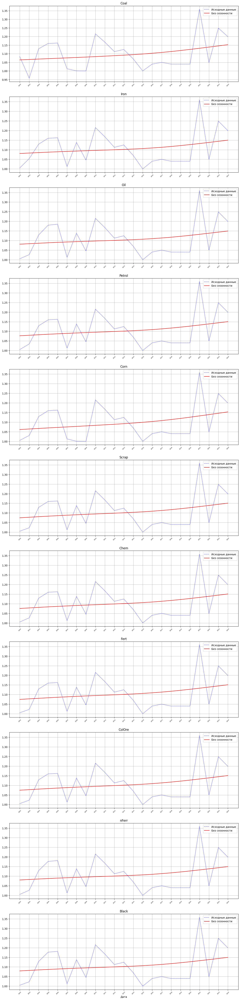

In [56]:
freq = 'annual'

fig, axes = plt.subplots(df_transportation_tariff_indexed[freq].shape[1], 1, figsize=(16, 3.0 * len(df)), sharex=False)

for ax, cargo in zip(axes, df_transportation_tariff_indexed[freq].columns):
    ax.plot(df_transportation_tariff_indexed_adjusted[freq].index, df_transportation_tariff_indexed[freq][cargo], label="Исходные данные", linestyle="dotted", color="blue")
    ax.plot(df_transportation_tariff_indexed_adjusted[freq].index, df_transportation_tariff_indexed_adjusted[freq][cargo], label="Без сезонности", color="red")
    ax.set_title(cargo)
    ax.grid()
    ax.legend()

    step = 1#max(1, len(df_transportation_volumes.columns))  # Количество подписей по X не больше 10
    ax.set_xticks(df_transportation_tariff_indexed_adjusted[freq].index[::step])
    ax.set_xticklabels(df_transportation_tariff_indexed_adjusted[freq].index[::step], rotation=45, fontsize=5)  # Красиво форматируем

plt.xlabel("Дата")
plt.show()

# 🦚 Run regression model

## 🦤 Prepare data to model

In [57]:
import warnings
warnings.filterwarnings("ignore")

### 🦧 Prepare SERial data

In [58]:
dct_serial = {
    #'Coal': ["SER0306", "SER0406", "SER1006", "SER1311", "SER1312", "SER1412", "SER1501", "SER1510", "SER1706"],
    'Coal': ["SER0306", "SER1006"],
    #'Iron': [2003, 2006, 2015, 2016, 2022, 2023],
    'Iron': [2006, 2015, 2022, 2023],
    'Oil': ["SER0402", "SER0409", "SER0601", "SER0602", "SER0603", "SER0608", "SER0610", "SER1207", "SER1208", "SER1311", "SER1404", "SER1607", "SER1703", "SER1708"],
    #'Petrol': ["SER0405", "SER0510", "SER0706", "SER0912", "SER1009", "SER1212", "SER1401", "SER1501", "SER1505", "SER1603", "SER1604", "SER2206", "SER2401", "SER2407"],
    'Petrol': ["SER0510", "SER0912", "SER1009", "SER2401"],
    'Constr': ["SER0501", "SER0803", "SER0811", "SER1002", "SER1011", "SER1103", "SER1301", "SER1401", "SER1502", "SER1602", "SER170"],
    #'Chem': ["SER0307", "SER0910", "SER1009", "SER2302"],
    #'Chem': ["SER0307", "SER0910", "SER0911", "SER1009", "SER1010", "SER1302", "SER1303", "SER2302"],
    #'Chem': ["SER0307", "SER0411", "SER0807", "SER0901", "SER0903", "SER0904", "SER0905", "SER0909", "SER0910", "SER0911", "SER1001", "SER1009", "SER1010", "SER1104", "SER1302", "SER1303", "SER1401", "SER1501", "SER1611", "SER1901", "SER2002", "SER2201", "SER2212", "SER2302"],
    'Chem': ["SER0307", "SER0411", "SER0807", "SER0901", "SER0903", "SER0904", "SER0905", "SER0909", "SER0910", "SER0911", "SER1001", "SER1009", "SER1010", "SER1104"],# "SER1302", "SER1303", "SER1401", "SER1501", "SER1611", "SER1901", "SER2002", "SER2201", "SER2212", "SER2302"],
    'Black': ["SER0603", "SER1101", "SER1501", "SER1701"],
    'Cement': ["SER0411", "SER0501", "SER0808", "SER1001", "SER1004", "SER1006", "SER1007", "SER1008", "SER1011", "SER1312", "SER1501", "SER1701"],
    'Coke': ["SER0501", "SER0701", "SER0710", "SER0901", "SER1003", "SER1004", "SER1012", "SER1102", "SER1201", "SER1203", "SER1204", "SER1409", "SER1412", "SER1501", "SER1703", "SER1707"],
    'ColOre': ["SER0407", "SER0501", "SER0901", "SER1001", "SER1206", "SER1302", "SER1312", "SER1401", "SER1402", "SER1501", "SER1502", "SER1505", "SER1606"],
    'Corn': ["SER0603", "SER0604", "SER0611", "SER0708", "SER0906", "SER0908", "SER0909", "SER0910", "SER1104", "SER1201", "SER1203", "SER1208", "SER1209", "SER1210", "SER1501", "SER1507"],
    'Drinks': ["SER0401", "SER0508", "SER0701", "SER0801", "SER1009", "SER1104", "SER1306", "SER1312", "SER1401", "SER1501", "SER1509"],
    'Earth': ["SER0401", "SER0503", "SER0704", "SER0710", "SER0812", "SER0903", "SER1002", "SER1101", "SER1301", "SER1401", "SER1403", "SER1501", "SER1503", "SER1505", "SER1701"],
    #'Fert': ["SER0409", "SER0510", "SER0511", "SER0702", "SER0810", "SER1010", "SER1011", "SER1107", "SER1201", "SER1710"],
    'Fert': ["SER0409", "SER0510", "SER0511", "SER0702", "SER0810", "SER1010", "SER1011", "SER1107", "SER1201", "SER1710", "SER1911", "SER2109", "SER2410"],
    'Lim': ["SER0702", "SER1002", "SER1003", "SER1010", "SER1011", "SER1102", "SER1312", "SER1401", "SER1501", "SER1701", "SER1711"],
    #'nFerr': ["SER0405", "SER0406", "SER0511", "SER0602", "SER0603", "SER0704", "SER0709", "SER0806", "SER0810", "SER0906", "SER0912", "SER1001", "SER1004", "SER1005", "SER1207", "SER1401", "SER1405", "SER1412", "SER1501", "SER1504", "SER1601", "SER1709", "SER1710", "SER1712", "SER2107", "SER2111", "SER2212", "SER2307", "SER2312", "SER2404"],
    #'nFerr': ["SER0406","SER0806", "SER0810", "SER0906", "SER1401", "SER1412", "SER1501", "SER1601", "SER2111", "SER2212", "SER2307", "SER2404"],
    'nFerr': ["SER0406", "SER2212"],
    'Other': ["SER0912", "SER1007", "SER1012", "SER1312", "SER1401", "SER1501"],
    #'Scrap': ["SER0401", "SER0404", "SER0405", "SER0406", "SER0407", "SER0411", "SER0603", "SER0604", "SER0810", "SER0910", "SER0911", "SER0912", "SER1101", "SER1111", "SER1502", "SER1606", "SER1608", "SER1701", "SER1702", "SER2102", "SER1912", "SER2111", "SER2406"],
    'Scrap': ["SER0401", "SER0411", "SER0911", "SER0912", "SER1111", "SER1502", "SER1606", "SER1608", "SER1701",  "SER2102"],
    'Slag': ["SER0402", "SER0704", "SER0705", "SER0707", "SER0708", "SER0911", "SER1001", "SER1101", "SER1102", "SER1109", "SER1110", "SER1511", "SER1601", "SER1612"],
    'Wheat': ["SER0806", "SER0912", "SER1201", "SER1403"],
    'Corn': ["SER0603", "SER0604", "SER0611", "SER0708", "SER0906", "SER0908", "SER0909", "SER0910", "SER1104", "SER1201", "SER1203", "SER1208", "SER1209","SER1210", "SER1501", "SER1507"]
    #'Corn': ["SER0801", "SER0901","SER1001","SER1101","SER1201","SER1301","SER1401","SER2001","SER2101","SER2201","SER2301","SER2401"],
    #'Corn': ["SER0806", "SER0809","SER1202","SER1205", "SER1401","SER2201", "SER2202","SER2203", "SER2206","SER2207", "SER2208","SER2209"],
    #'Corn': ["SER1401","SER2201"],
    #'Corn': []
}

### 🦇 Iron

**********************************************************************************
commodity type: Iron


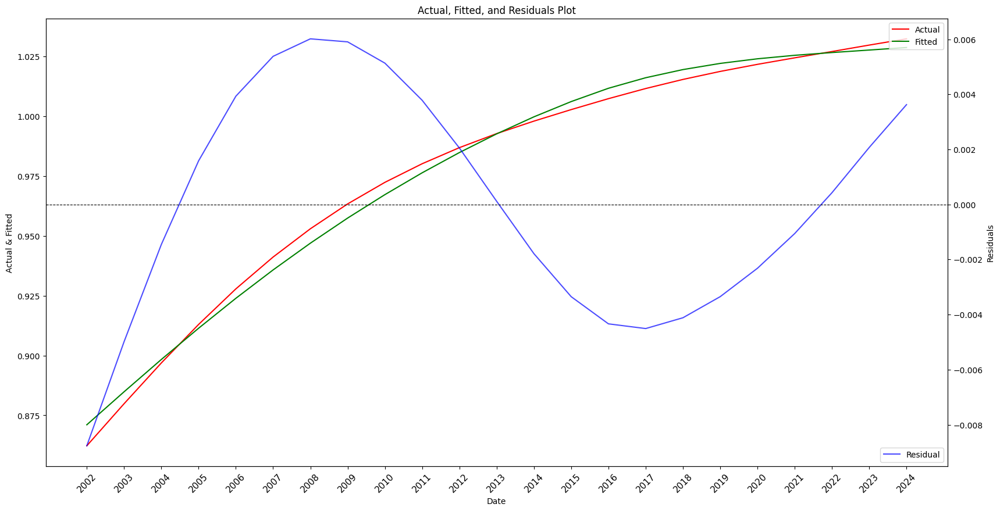

                            OLS Regression Results                            
Dep. Variable:                   V_SA   R-squared:                       0.993
Model:                            OLS   Adj. R-squared:                  0.993
Method:                 Least Squares   F-statistic:                     1517.
Date:                Tue, 04 Mar 2025   Prob (F-statistic):           1.45e-22
Time:                        04:48:22   Log-Likelihood:                 94.219
No. Observations:                  23   AIC:                            -182.4
Df Residuals:                      20   BIC:                            -179.0
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.8103      0.095      8.504      0.0

In [59]:
freq = 'annual'
commodity_type = 'Iron'
type_dct = {
    "date": df_transportation_volumes_indexed_adjusted[freq].index,
    "V_SA": df_transportation_volumes_indexed_adjusted[freq][commodity_type],   # Transport Volume Growth Index
    "EXP_T": df_transportation_tariff_indexed_adjusted[freq][commodity_type],   # Tariff growth index
    "M_SA": df_volumes_indexed_adjusted[freq][commodity_type],   # Production growth index
}
# type_dct = {
#     "date": df_transportation_volumes_indexed[freq].index,
#     "V_SA": df_transportation_volumes_indexed[freq][commodity_type],   # Transport Volume Growth Index
#     "EXP_T": df_transportation_tariff_indexed[freq][commodity_type],   # Tariff growth index
#     "M_SA": df_volumes_indexed[freq][commodity_type],   # Production growth index
# }
# dummy variables
# dct_serial_data = construct_serial_data_by_type(commodity_type, df_volumes, dct_serial)
# for key, value in dct_serial_data.items():
#   type_dct[key] = value

df_type = pd.DataFrame(type_dct)

# df_type["V_SA(-1)"] = df_type["V_SA"].shift(1)

df_type = df_type.dropna()

df_type

Y = df_type["V_SA"]
lst_data = [i for i in df_type.columns if i != 'V_SA' and i != 'date']
X = df_type[[i for i in df_type.columns if i in lst_data]]
df_type.set_index('date', inplace=True)

# Adding a constant for regression
X = sm.add_constant(X)

# Make regression
model = sm.OLS(Y, X).fit()

print("**********************************************************************************")
print("commodity type:", commodity_type)
# Print results
plot_regression_results(model, df_type)
print(model.summary())

0it [00:00, ?it/s]

2 1 0
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   23
Model:               SARIMAX(2, 1, 0)   Log Likelihood                 155.046
Date:                Tue, 04 Mar 2025   AIC                           -300.092
Time:                        04:48:26   BIC                           -295.113
Sample:                    01-01-2002   HQIC                          -299.120
                         - 01-01-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.2749      0.047     -5.827      0.000      -0.367      -0.182
M_SA           0.6180      0.025     24.946      0.000       0.569       0.667
ar.L1          1.8177      0.062     29.272   

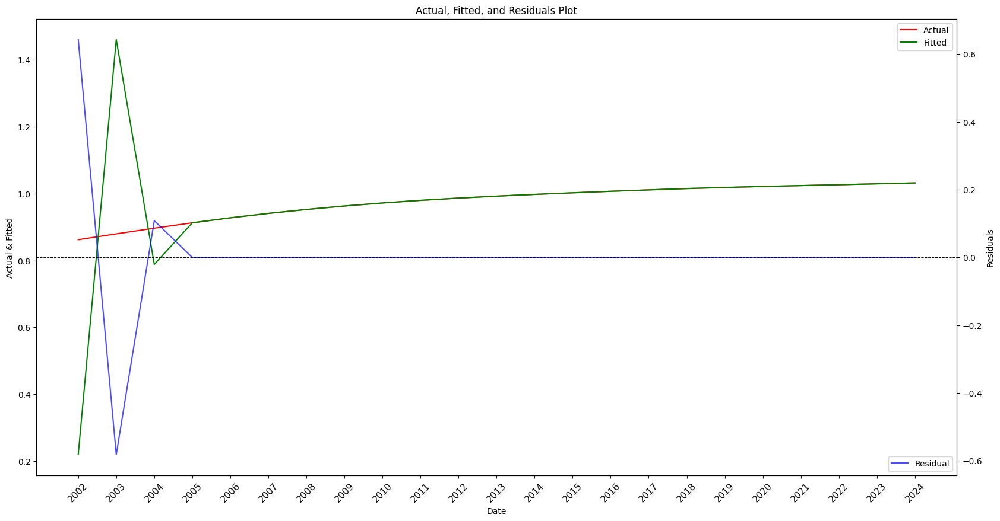

2 1 1
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   23
Model:               SARIMAX(2, 1, 1)   Log Likelihood                 155.647
Date:                Tue, 04 Mar 2025   AIC                           -299.295
Time:                        04:48:26   BIC                           -293.320
Sample:                    01-01-2002   HQIC                          -298.128
                         - 01-01-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.2749      0.005    -51.028      0.000      -0.285      -0.264
M_SA           0.6180      0.029     21.480      0.000       0.562       0.674
ar.L1          1.8049      0.010    174.720   

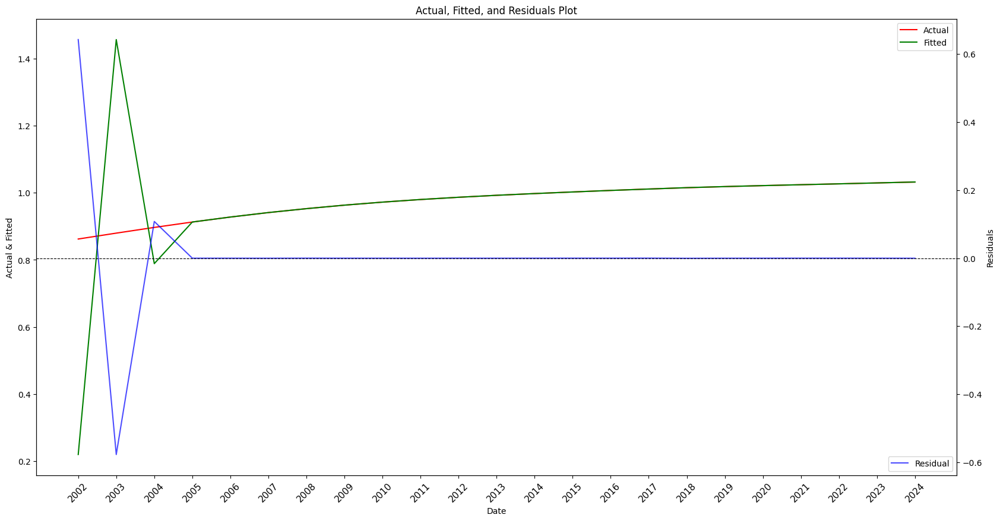

2 1 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   23
Model:               SARIMAX(2, 1, 2)   Log Likelihood                 147.367
Date:                Tue, 04 Mar 2025   AIC                           -280.734
Time:                        04:48:27   BIC                           -274.123
Sample:                    01-01-2002   HQIC                          -279.615
                         - 01-01-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.2749      0.006    -42.507      0.000      -0.288      -0.262
M_SA           0.6180      0.033     18.674      0.000       0.553       0.683
ar.L1          1.8007      0.010    176.960   

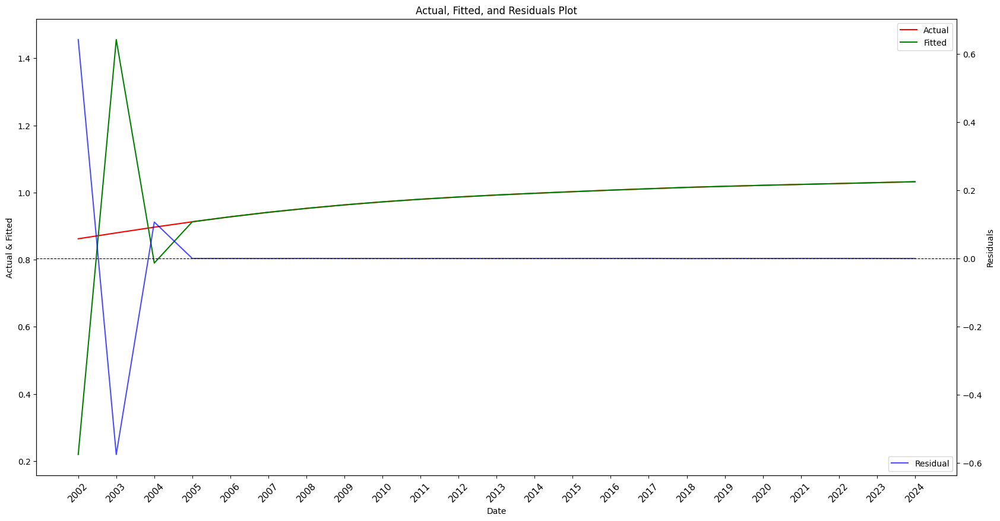

2 1 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   23
Model:               SARIMAX(2, 1, 3)   Log Likelihood                 138.570
Date:                Tue, 04 Mar 2025   AIC                           -261.140
Time:                        04:48:28   BIC                           -254.017
Sample:                    01-01-2002   HQIC                          -260.157
                         - 01-01-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.2749      0.051     -5.405      0.000      -0.375      -0.175
M_SA           0.6180      0.033     18.490      0.000       0.552       0.683
ar.L1          1.7375      0.065     26.835   

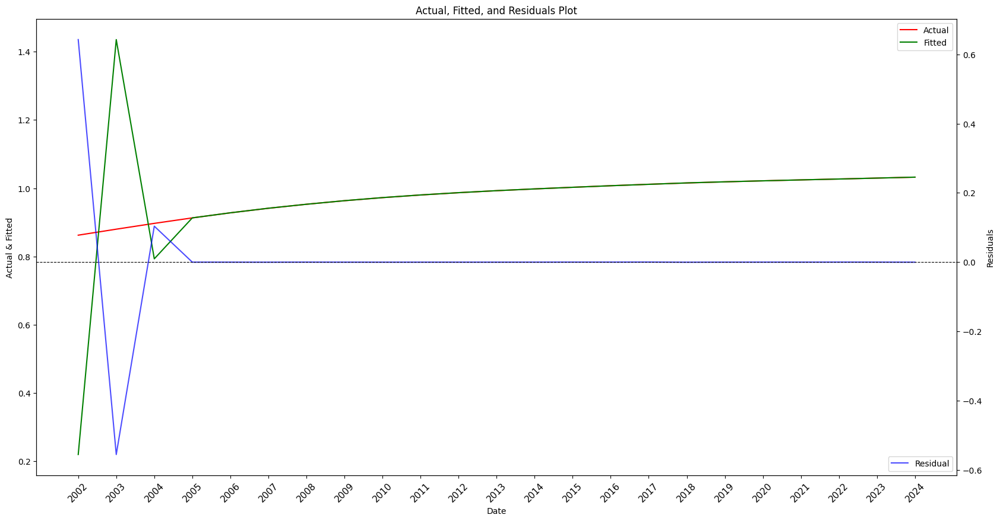

2 1 4
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   23
Model:               SARIMAX(2, 1, 4)   Log Likelihood                 121.624
Date:                Tue, 04 Mar 2025   AIC                           -225.248
Time:                        04:48:28   BIC                           -217.749
Sample:                    01-01-2002   HQIC                          -224.503
                         - 01-01-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.2749      0.082     -3.343      0.001      -0.436      -0.114
M_SA           0.6180      0.036     16.994      0.000       0.547       0.689
ar.L1          1.6035      0.085     18.914   

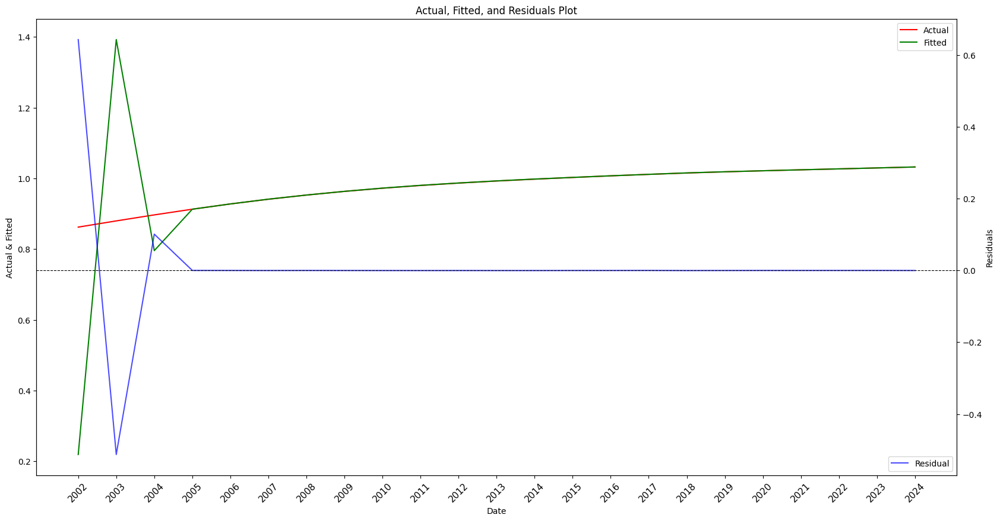

3 1 0
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   23
Model:               SARIMAX(3, 1, 0)   Log Likelihood                 147.350
Date:                Tue, 04 Mar 2025   AIC                           -282.701
Time:                        04:48:31   BIC                           -277.034
Sample:                    01-01-2002   HQIC                          -281.742
                         - 01-01-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.2749      0.018    -15.402      0.000      -0.310      -0.240
M_SA           0.6180      0.036     17.097      0.000       0.547       0.689
ar.L1          2.0607      0.044     47.060   

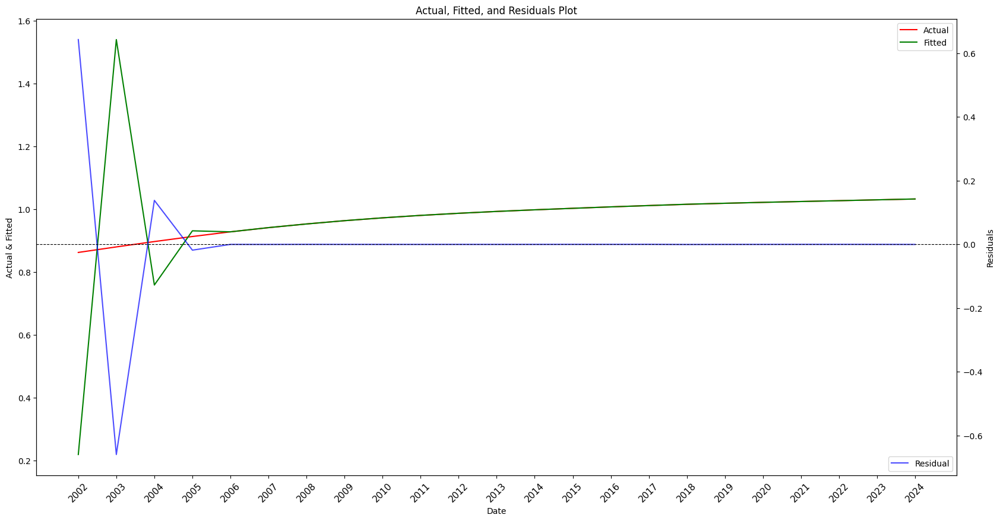

3 1 1
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   23
Model:               SARIMAX(3, 1, 1)   Log Likelihood                 146.754
Date:                Tue, 04 Mar 2025   AIC                           -279.507
Time:                        04:48:32   BIC                           -272.896
Sample:                    01-01-2002   HQIC                          -278.388
                         - 01-01-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.2749      0.035     -7.801      0.000      -0.344      -0.206
M_SA           0.6180      0.031     19.746      0.000       0.557       0.679
ar.L1          1.2863      0.063     20.315   

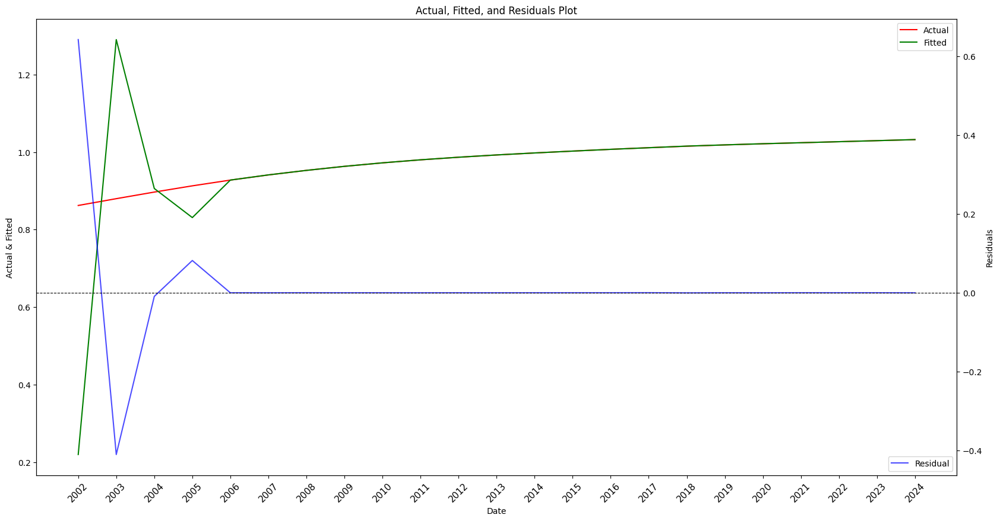

3 1 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   23
Model:               SARIMAX(3, 1, 2)   Log Likelihood                 130.287
Date:                Tue, 04 Mar 2025   AIC                           -244.574
Time:                        04:48:32   BIC                           -237.019
Sample:                    01-01-2002   HQIC                          -243.295
                         - 01-01-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.2749      0.004    -63.133      0.000      -0.283      -0.266
M_SA           0.6180      0.026     23.996      0.000       0.568       0.668
ar.L1          4.3633      0.007    635.594   

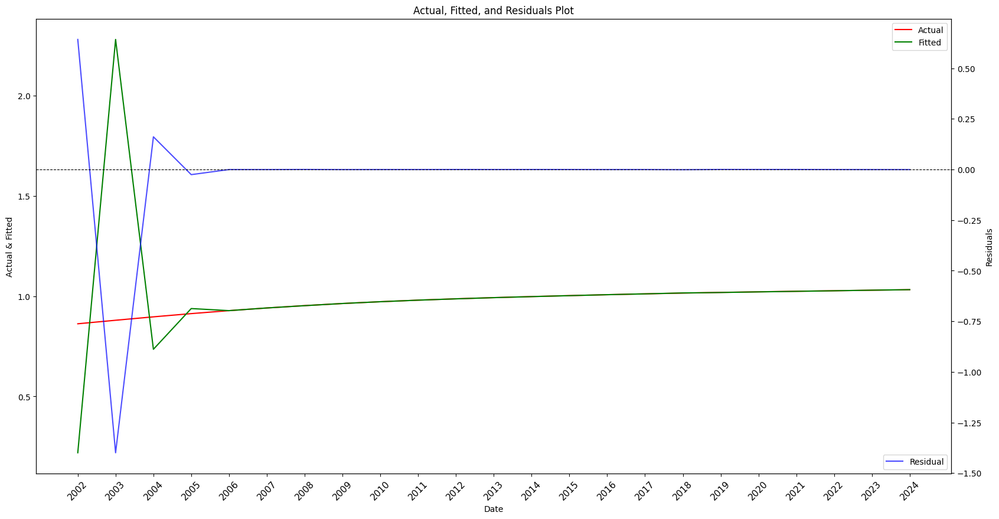

3 1 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   23
Model:               SARIMAX(3, 1, 3)   Log Likelihood                 134.821
Date:                Tue, 04 Mar 2025   AIC                           -251.642
Time:                        04:48:33   BIC                           -243.628
Sample:                    01-01-2002   HQIC                          -250.537
                         - 01-01-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.2749      0.037     -7.402      0.000      -0.348      -0.202
M_SA           0.6180      0.077      8.044      0.000       0.467       0.769
ar.L1          2.4186      0.026     94.295   

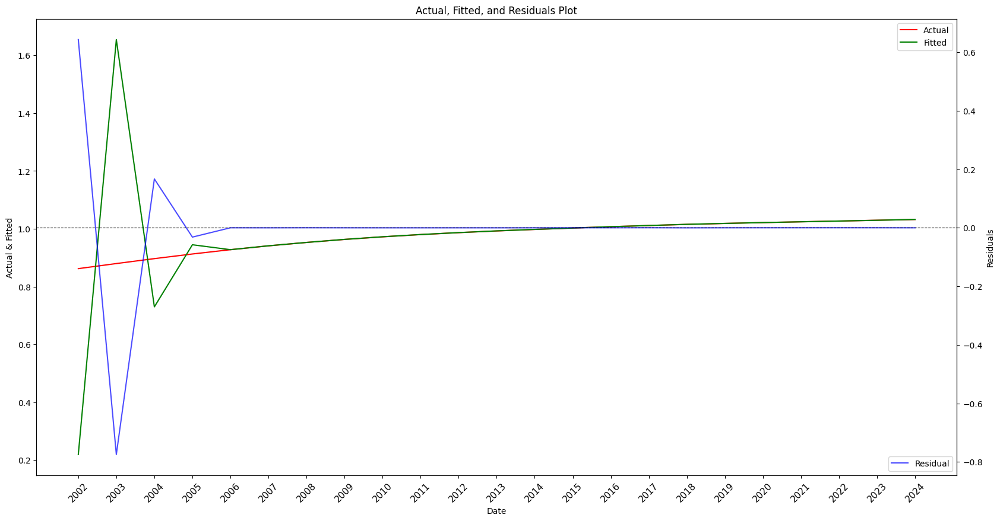

3 1 4
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   23
Model:               SARIMAX(3, 1, 4)   Log Likelihood                 120.296
Date:                Tue, 04 Mar 2025   AIC                           -220.591
Time:                        04:48:34   BIC                           -212.259
Sample:                    01-01-2002   HQIC                          -219.763
                         - 01-01-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.2749      0.125     -2.194      0.028      -0.521      -0.029
M_SA           0.6180      0.053     11.680      0.000       0.514       0.722
ar.L1          1.2711      0.079     16.009   

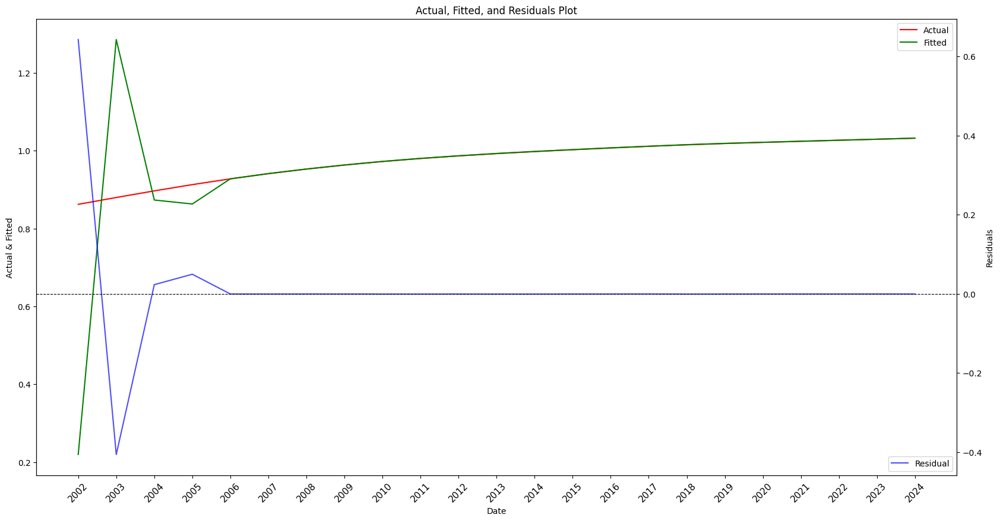

4 1 0
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   23
Model:               SARIMAX(4, 1, 0)   Log Likelihood                 139.529
Date:                Tue, 04 Mar 2025   AIC                           -265.058
Time:                        04:48:36   BIC                           -258.826
Sample:                    01-01-2002   HQIC                          -264.199
                         - 01-01-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.2749      0.012    -23.153      0.000      -0.298      -0.252
M_SA           0.6180      0.033     18.756      0.000       0.553       0.683
ar.L1          2.0984      0.030     70.437   

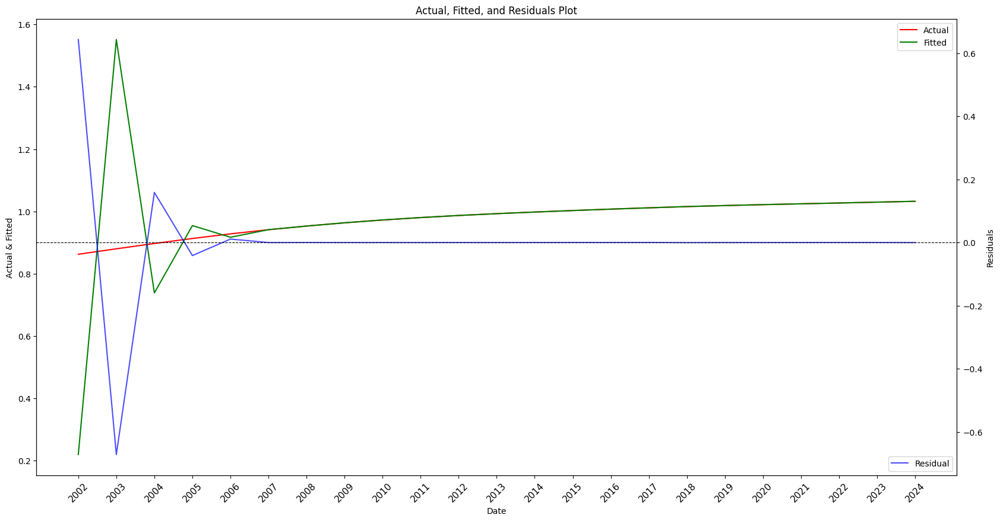

4 1 1
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   23
Model:               SARIMAX(4, 1, 1)   Log Likelihood                 136.646
Date:                Tue, 04 Mar 2025   AIC                           -257.291
Time:                        04:48:36   BIC                           -250.169
Sample:                    01-01-2002   HQIC                          -256.309
                         - 01-01-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.2749      0.026    -10.682      0.000      -0.325      -0.224
M_SA           0.6180      0.029     21.377      0.000       0.561       0.675
ar.L1          1.1956      0.053     22.518   

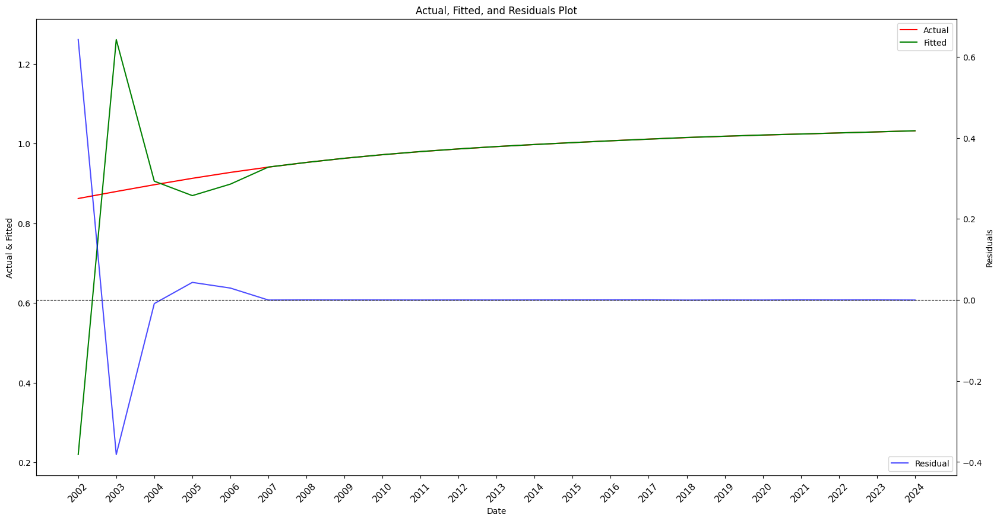

4 1 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   23
Model:               SARIMAX(4, 1, 2)   Log Likelihood                 134.797
Date:                Tue, 04 Mar 2025   AIC                           -251.594
Time:                        04:48:37   BIC                           -243.581
Sample:                    01-01-2002   HQIC                          -250.489
                         - 01-01-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.2749      0.017    -15.976      0.000      -0.309      -0.241
M_SA           0.6180      0.102      6.054      0.000       0.418       0.818
ar.L1          3.4813      0.047     73.295   

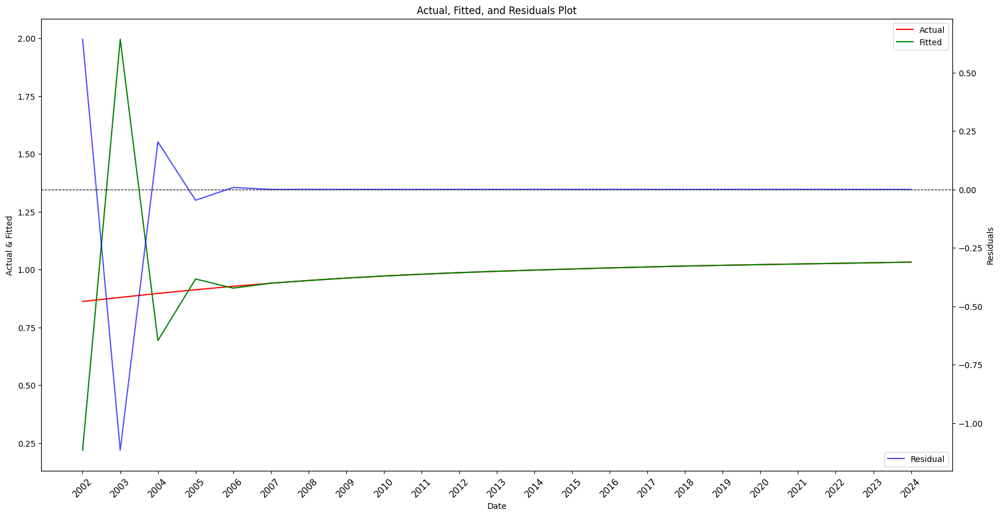

4 1 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   23
Model:               SARIMAX(4, 1, 3)   Log Likelihood                 136.078
Date:                Tue, 04 Mar 2025   AIC                           -252.156
Time:                        04:48:38   BIC                           -243.253
Sample:                    01-01-2002   HQIC                          -250.929
                         - 01-01-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.2749      0.011    -25.997      0.000      -0.296      -0.254
M_SA           0.6180      0.025     24.684      0.000       0.569       0.667
ar.L1          2.9209      0.020    142.969   

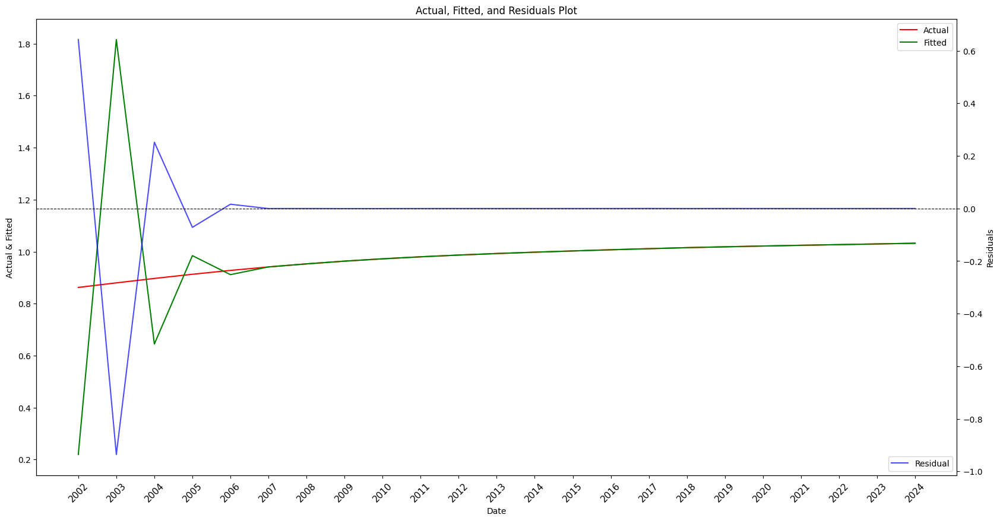

Лучшие параметры SARIMAX: (2, 1, 0)
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   23
Model:               SARIMAX(2, 1, 0)   Log Likelihood                 155.046
Date:                Tue, 04 Mar 2025   AIC                           -300.092
Time:                        04:48:39   BIC                           -295.113
Sample:                    01-01-2002   HQIC                          -299.120
                         - 01-01-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.2749      0.047     -5.827      0.000      -0.367      -0.182
M_SA           0.6180      0.025     24.946      0.000       0.569       0.667
ar.L1          1

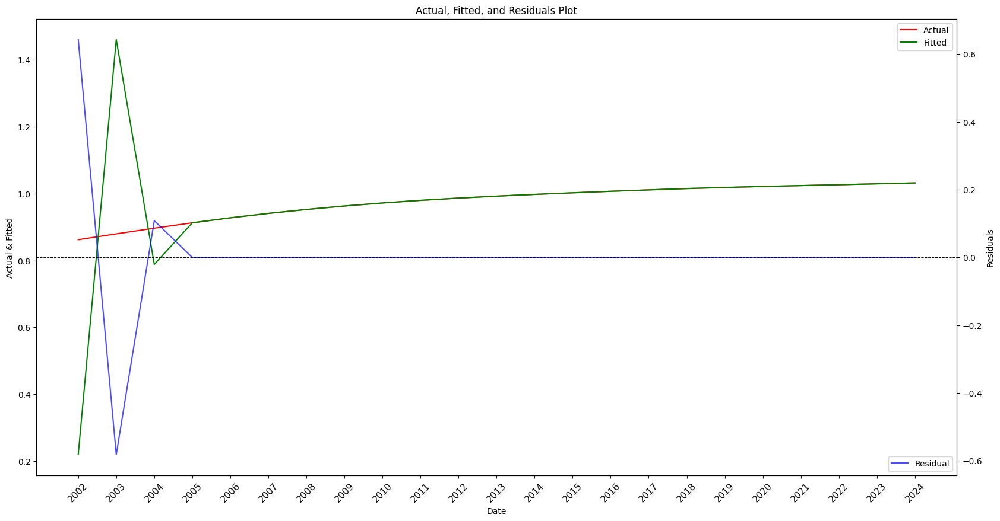

In [60]:
commodity_type = 'Iron'
type_dct = {
    "date": df_transportation_volumes_indexed_adjusted[freq].index,
    "V_SA": df_transportation_volumes_indexed_adjusted[freq][commodity_type],   # Transport Volume Growth Index
    "EXP_T": df_transportation_tariff_indexed_adjusted[freq][commodity_type],   # Tariff growth index
    "M_SA": df_volumes_indexed_adjusted[freq][commodity_type],   # Production growth index
}
# dummy variables
# dct_serial_data = construct_serial_data_by_type(commodity_type, df_volumes, dct_serial)
# for key, value in dct_serial_data.items():
#   type_dct[key] = value

df_type = pd.DataFrame(type_dct)

df_type = df_type.dropna()
df_type.set_index('date', inplace=True)

# Целевая переменная и регрессоры
Y = df_type["V_SA"]
X = df_type.drop(columns=["V_SA"])  # Убираем целевую переменную

# Подбор оптимальных p, d, q
p_values = range(0, 5)
d_values = range(0, 3)
q_values = range(0, 5)

best_aic = float("inf")
best_order = None
best_model = None

for p, d, q in tqdm(itertools.product(p_values, d_values, q_values)):
    try:
        model = sm.tsa.statespace.SARIMAX(Y, exog=X, order=(p, d, q), seasonal_order=(0, 0, 0, 0),
                                          enforce_stationarity=False, enforce_invertibility=False)
        results = model.fit(disp=False)

        # Достаем коэффициент и p-value для "T"
        coef_T = results.params.get("EXP_T", None)
        pval_T = results.pvalues.get("EXP_T", None)

        # Условие: коэффициент при T должен быть отрицательным и значимым (p < 0.05)
        if coef_T is not None and coef_T < 0 and pval_T is not None and pval_T < 0.05:
            if results.aic < best_aic:
                best_aic = results.aic
                best_order = (p, d, q)
                best_model = results
            print(p, d, q)
            print(results.summary())
            plot_regression_results(results, df_type)

    except:
        continue

# Вывод результатов
if best_model:
    print(f"Лучшие параметры SARIMAX: {best_order}")
    print(best_model.summary())
    plot_regression_results(best_model, df_type)
else:
    print("Не удалось найти подходящую модель, удовлетворяющую условиям.")

### 🦇 Corn

**********************************************************************************
commodity type: Corn


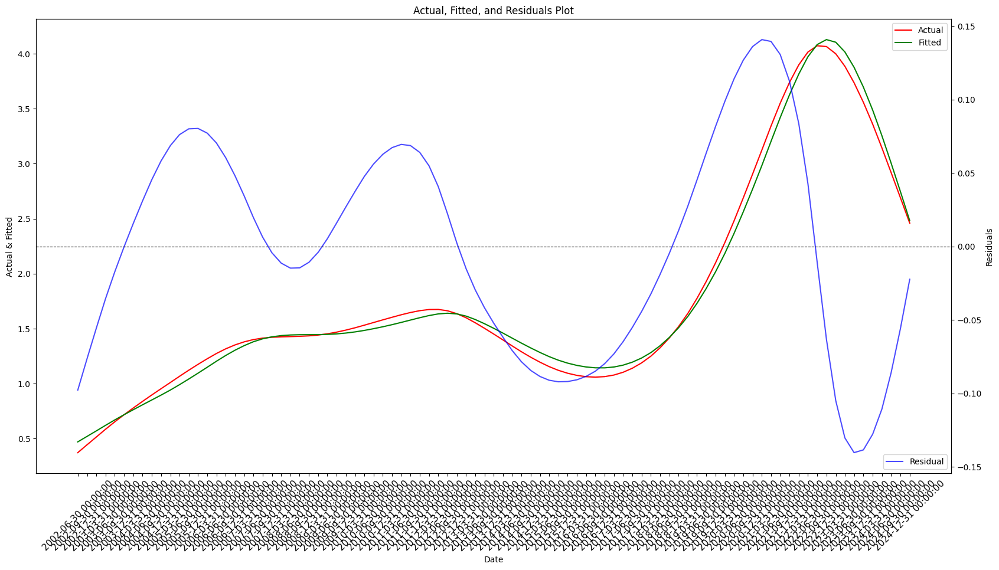

                            OLS Regression Results                            
Dep. Variable:                   V_SA   R-squared:                       0.994
Model:                            OLS   Adj. R-squared:                  0.994
Method:                 Least Squares   F-statistic:                     5023.
Date:                Tue, 04 Mar 2025   Prob (F-statistic):           2.44e-97
Time:                        04:48:41   Log-Likelihood:                 110.47
No. Observations:                  91   AIC:                            -212.9
Df Residuals:                      87   BIC:                            -202.9
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          2.3220      0.323      7.192      0.0

In [61]:
freq = 'quarterly'
commodity_type = 'Corn'
type_dct = {
    "date": df_transportation_volumes_indexed_adjusted[freq].index,
    "V_SA": df_transportation_volumes_indexed_adjusted[freq][commodity_type],   # Transport Volume Growth Index
    "EXP_T": df_transportation_tariff_indexed_adjusted[freq][commodity_type],   # Tariff growth index
    "M_SA": df_volumes_indexed_adjusted[freq][commodity_type],   # Production growth index
}
# dummy variables
# dct_serial_data = construct_serial_data_by_type(commodity_type, df_volumes, dct_serial)
# for key, value in dct_serial_data.items():
#   type_dct[key] = value

df_type = pd.DataFrame(type_dct)

df_type["V_SA(-1)"] = df_type["V_SA"].shift(1)

df_type = df_type.dropna()

df_type

Y = df_type["V_SA"]
lst_data = [i for i in df_type.columns if i != 'V_SA' and i != 'date']
X = df_type[[i for i in df_type.columns if i in lst_data]]
df_type.set_index('date', inplace=True)

# Adding a constant for regression
X = sm.add_constant(X)

# Make regression
model = sm.OLS(Y, X).fit()

print("**********************************************************************************")
print("commodity type:", commodity_type)
# Print results
plot_regression_results(model, df_type)
print(model.summary())

In [62]:
commodity_type = 'Corn'
type_dct = {
    "date": df_transportation_volumes_indexed_adjusted[freq].index,
    "V_SA": df_transportation_volumes_indexed_adjusted[freq][commodity_type],   # Transport Volume Growth Index
    "EXP_T": df_transportation_tariff_indexed_adjusted[freq][commodity_type],   # Tariff growth index
    "M_SA": df_volumes_indexed_adjusted[freq][commodity_type],   # Production growth index
}

# Dummy-переменные
# dct_serial_data = construct_serial_data_by_type(commodity_type, df_volumes, dct_serial)
# for key, value in dct_serial_data.items():
#     type_dct[key] = value

df_type = pd.DataFrame(type_dct)

df_type = df_type.dropna()
df_type.set_index('date', inplace=True)

# Целевая переменная и регрессоры
Y = df_type["V_SA"]
X = df_type.drop(columns=["V_SA"])  # Убираем целевую переменную

# Подбор оптимальных p, d, q
p_values = range(0, 5)
d_values = range(0, 3)
q_values = range(0, 5)

best_aic = float("inf")
best_order = None
best_model = None

for p, d, q in tqdm(itertools.product(p_values, d_values, q_values)):
    try:
        model = sm.tsa.statespace.SARIMAX(Y, exog=X, order=(p, d, q), seasonal_order=(0, 0, 0, 0),
                                          enforce_stationarity=False, enforce_invertibility=False)
        results = model.fit(disp=False)

        # Достаем коэффициент и p-value для "T"
        coef_T = results.params.get("EXP_T", None)
        pval_T = results.pvalues.get("EXP_T", None)

        # Условие: коэффициент при T должен быть отрицательным и значимым (p < 0.05)
        if coef_T is not None and coef_T < 0 and pval_T is not None and pval_T < 0.1:
            if results.aic < best_aic:
                best_aic = results.aic
                best_order = (p, d, q)
                best_model = results
            print(p, d, q)
            print(results.summary())
            plot_regression_results(results, df_type)

    except:
        continue

# Вывод результатов
if best_model:
    print(f"Лучшие параметры SARIMAX: {best_order}")
    print(best_model.summary())
    plot_regression_results(best_model, df_type)
else:
    print("Не удалось найти подходящую модель, удовлетворяющую условиям.")

0it [00:00, ?it/s]

Не удалось найти подходящую модель, удовлетворяющую условиям.


🐊 Log data

0it [00:00, ?it/s]

0 0 0
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:                        SARIMAX   Log Likelihood                 -56.829
Date:                Tue, 04 Mar 2025   AIC                            119.658
Time:                        04:48:59   BIC                            127.191
Sample:                    03-31-2002   HQIC                           122.697
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.7741      0.466     -3.809      0.000      -2.687      -0.861
M_SA           1.5663      0.434      3.606      0.000       0.715       2.418
sigma2         0.2042      0.047      4.327   

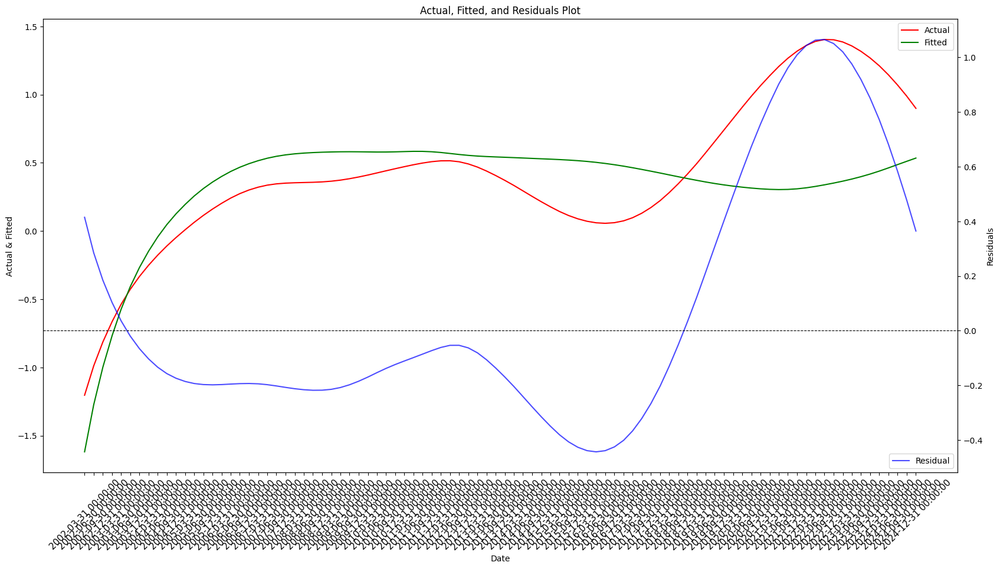

0 0 1
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(0, 0, 1)   Log Likelihood                   3.347
Date:                Tue, 04 Mar 2025   AIC                              1.305
Time:                        04:49:00   BIC                             11.305
Sample:                    03-31-2002   HQIC                             5.338
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.7641      0.467     -3.775      0.000      -2.680      -0.848
M_SA           1.6218      0.394      4.120      0.000       0.850       2.393
ma.L1          1.0000   1579.789      0.001   

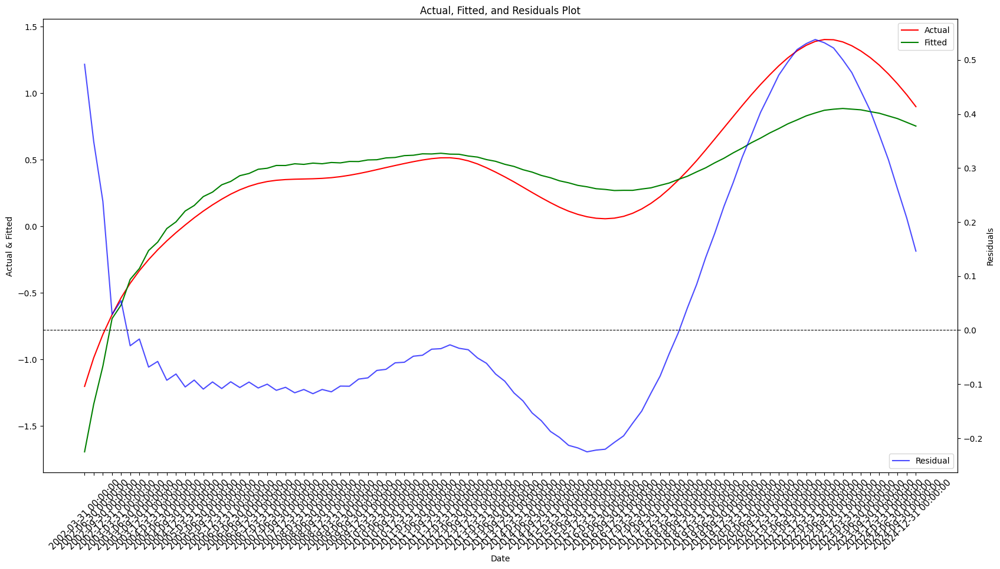

0 0 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(0, 0, 2)   Log Likelihood                   8.822
Date:                Tue, 04 Mar 2025   AIC                             -7.644
Time:                        04:49:01   BIC                              4.799
Sample:                    03-31-2002   HQIC                            -2.629
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.7339      0.475     -3.650      0.000      -2.665      -0.803
M_SA           1.7168      0.446      3.847      0.000       0.842       2.591
ma.L1         15.6117     39.198      0.398   

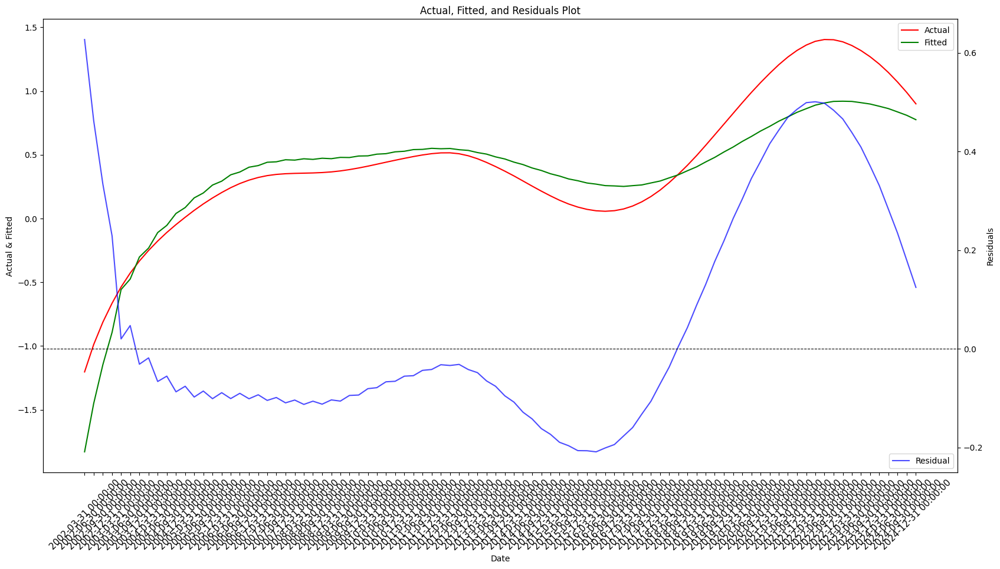

0 0 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(0, 0, 3)   Log Likelihood                   4.269
Date:                Tue, 04 Mar 2025   AIC                              3.462
Time:                        04:49:02   BIC                             18.326
Sample:                    03-31-2002   HQIC                             9.450
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.6443      0.460     -3.577      0.000      -2.545      -0.743
M_SA           2.2413      0.270      8.290      0.000       1.711       2.771
ma.L1          9.9838      1.557      6.411   

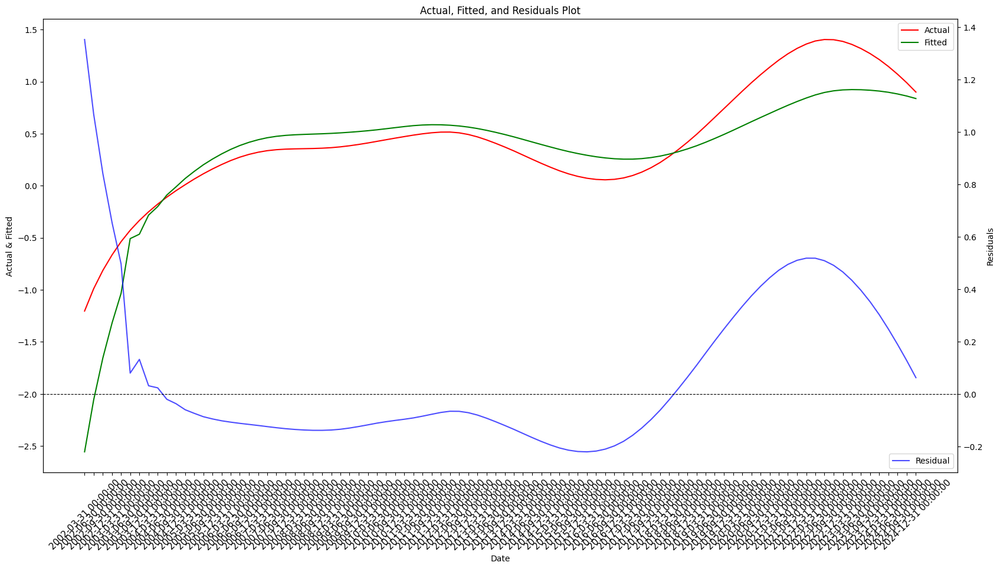

0 0 4
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(0, 0, 4)   Log Likelihood                  24.405
Date:                Tue, 04 Mar 2025   AIC                            -34.811
Time:                        04:49:04   BIC                            -17.549
Sample:                    03-31-2002   HQIC                           -27.860
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.6891      0.470     -3.591      0.000      -2.611      -0.767
M_SA           2.0440      0.423      4.835      0.000       1.216       2.873
ma.L1         14.5958      5.746      2.540   

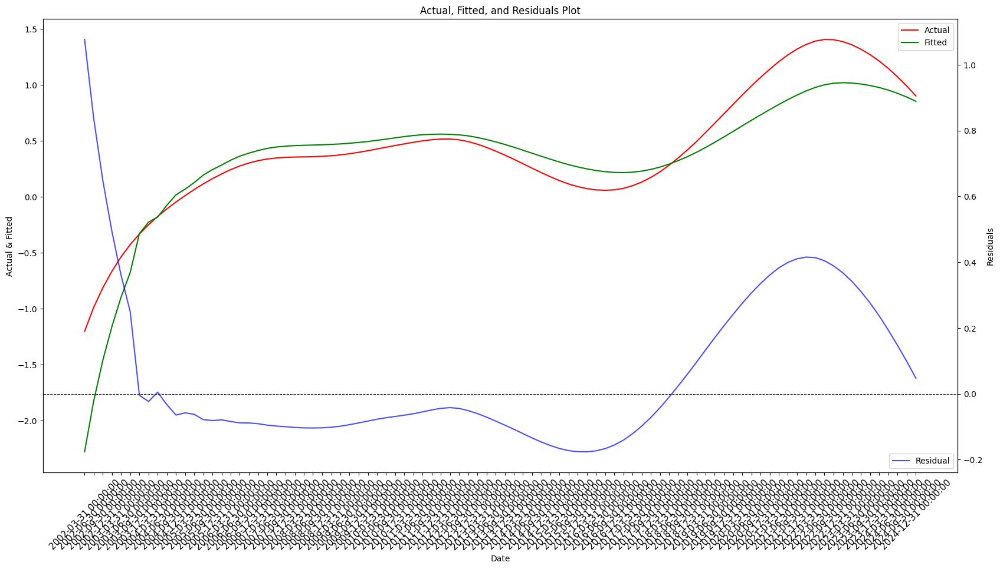

2 0 0
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(2, 0, 0)   Log Likelihood                 388.130
Date:                Tue, 04 Mar 2025   AIC                           -766.261
Time:                        04:49:11   BIC                           -753.762
Sample:                    03-31-2002   HQIC                          -761.220
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.8154      0.157    -11.571      0.000      -2.123      -1.508
M_SA           1.0759      0.033     32.344      0.000       1.011       1.141
ar.L1          2.0229      0.012    172.866   

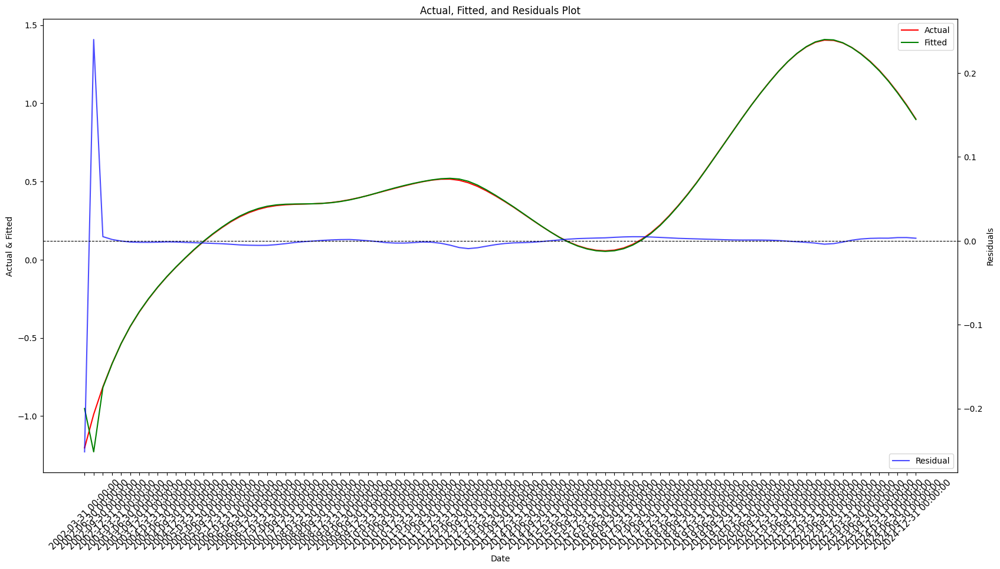

2 0 1
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(2, 0, 1)   Log Likelihood                 446.145
Date:                Tue, 04 Mar 2025   AIC                           -880.289
Time:                        04:49:12   BIC                           -865.290
Sample:                    03-31-2002   HQIC                          -874.241
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.7902      0.161    -11.113      0.000      -2.106      -1.474
M_SA           1.0544      0.026     40.825      0.000       1.004       1.105
ar.L1          2.0220      0.012    170.620   

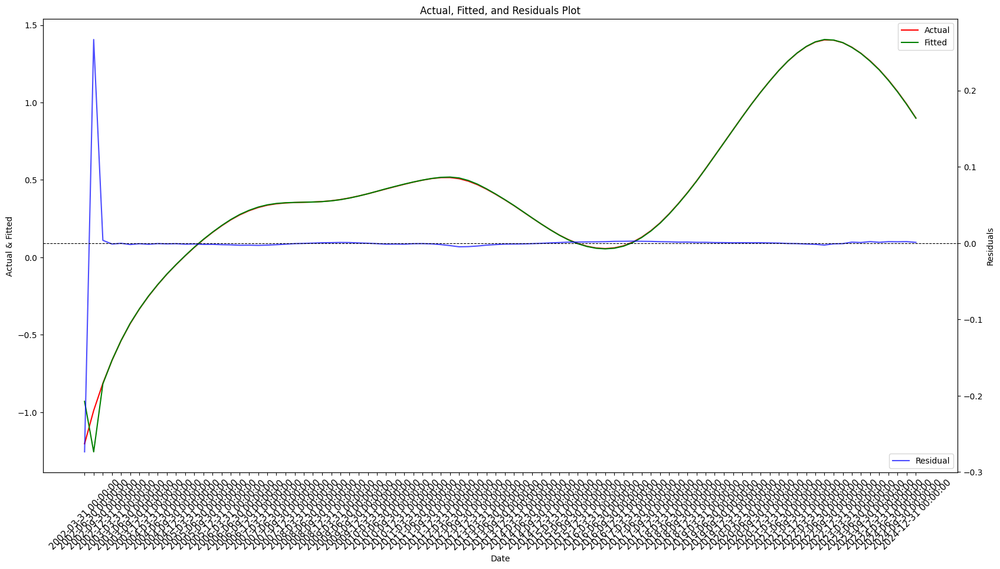

2 0 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(2, 0, 2)   Log Likelihood                 385.515
Date:                Tue, 04 Mar 2025   AIC                           -757.029
Time:                        04:49:13   BIC                           -739.609
Sample:                    03-31-2002   HQIC                          -750.007
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.7953      0.340     -5.274      0.000      -2.462      -1.128
M_SA           1.4393      0.104     13.837      0.000       1.235       1.643
ar.L1          1.9872      0.024     84.173   

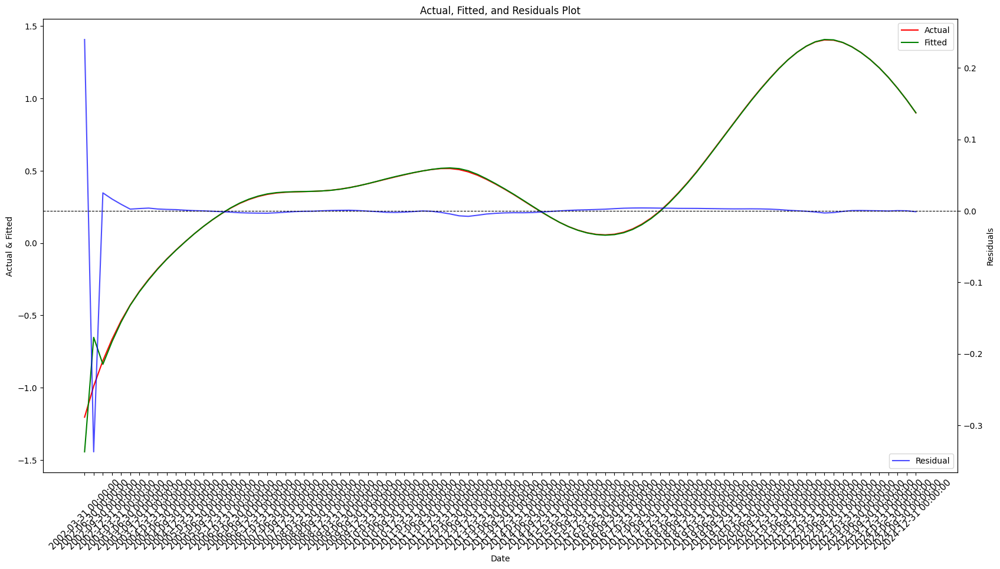

2 0 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(2, 0, 3)   Log Likelihood                 437.668
Date:                Tue, 04 Mar 2025   AIC                           -859.336
Time:                        04:49:15   BIC                           -839.517
Sample:                    03-31-2002   HQIC                          -851.351
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.7931      0.245     -7.310      0.000      -2.274      -1.312
M_SA           1.4830      0.066     22.467      0.000       1.354       1.612
ar.L1          2.0261      0.023     86.728   

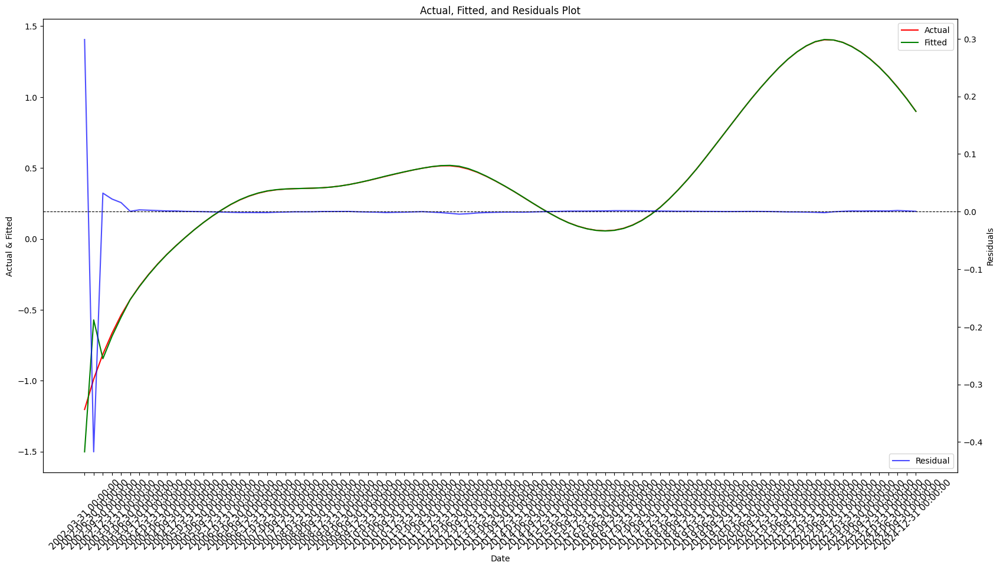

2 0 4
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(2, 0, 4)   Log Likelihood                 467.426
Date:                Tue, 04 Mar 2025   AIC                           -916.852
Time:                        04:49:16   BIC                           -894.658
Sample:                    03-31-2002   HQIC                          -907.915
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.7931      0.008   -231.540      0.000      -1.808      -1.778
M_SA           1.4830      0.045     32.759      0.000       1.394       1.572
ar.L1          2.0280      0.020    102.882   

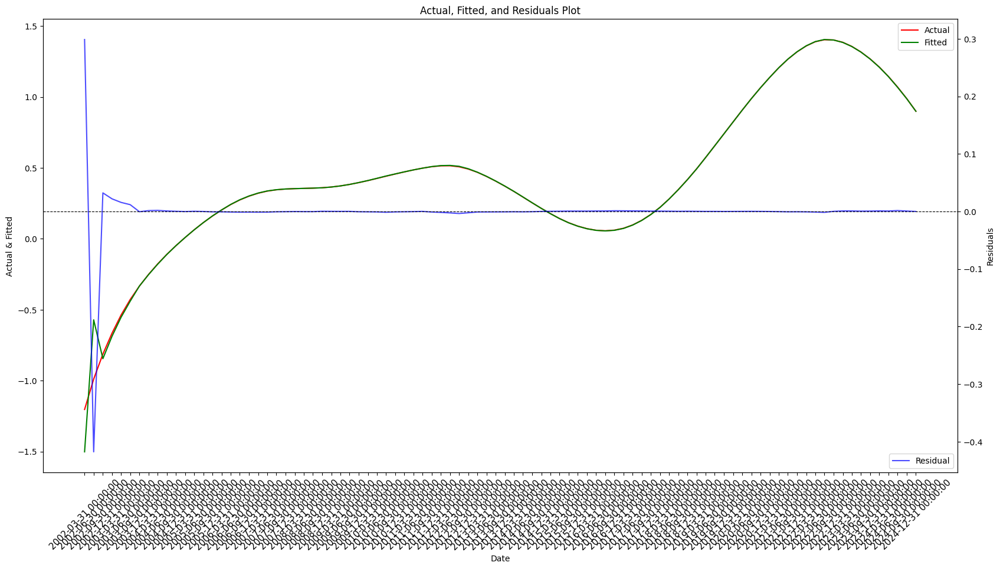

3 0 0
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 0, 0)   Log Likelihood                 479.958
Date:                Tue, 04 Mar 2025   AIC                           -947.917
Time:                        04:49:21   BIC                           -932.985
Sample:                    03-31-2002   HQIC                          -941.898
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.7931      0.306     -5.865      0.000      -2.392      -1.194
M_SA           1.4830      0.278      5.335      0.000       0.938       2.028
ar.L1          2.8020      0.021    134.969   

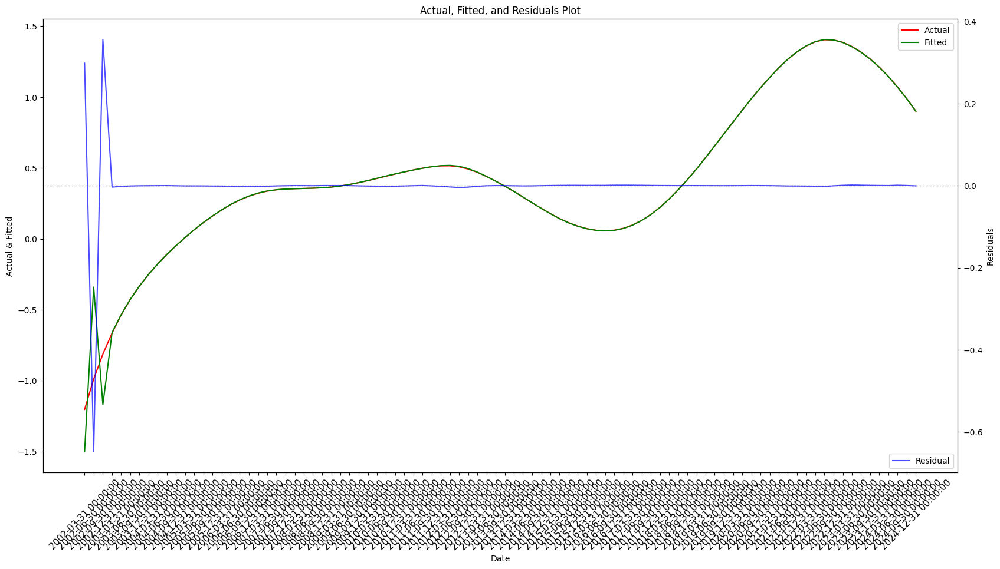

3 0 1
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 0, 1)   Log Likelihood                 416.149
Date:                Tue, 04 Mar 2025   AIC                           -818.297
Time:                        04:49:23   BIC                           -800.877
Sample:                    03-31-2002   HQIC                          -811.275
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.7304      0.158    -10.949      0.000      -2.040      -1.421
M_SA           1.0762      0.039     27.902      0.000       1.001       1.152
ar.L1          1.6557      0.190      8.719   

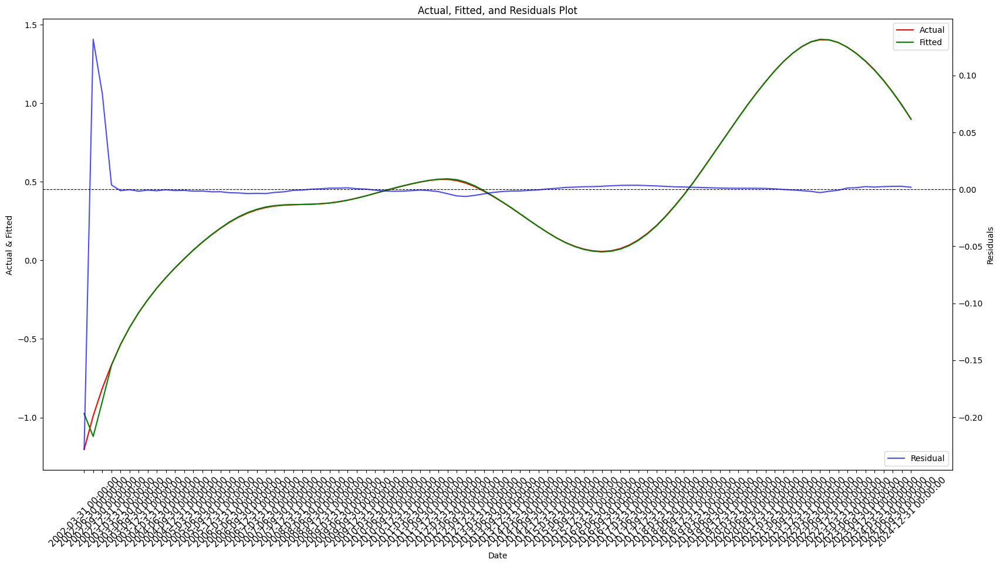

3 0 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 0, 2)   Log Likelihood                 517.469
Date:                Tue, 04 Mar 2025   AIC                          -1018.939
Time:                        04:49:24   BIC                           -999.029
Sample:                    03-31-2002   HQIC                         -1010.914
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.7931      0.818     -2.193      0.028      -3.395      -0.191
M_SA           1.4825      0.280      5.292      0.000       0.933       2.032
ar.L1          2.9042      0.054     54.199   

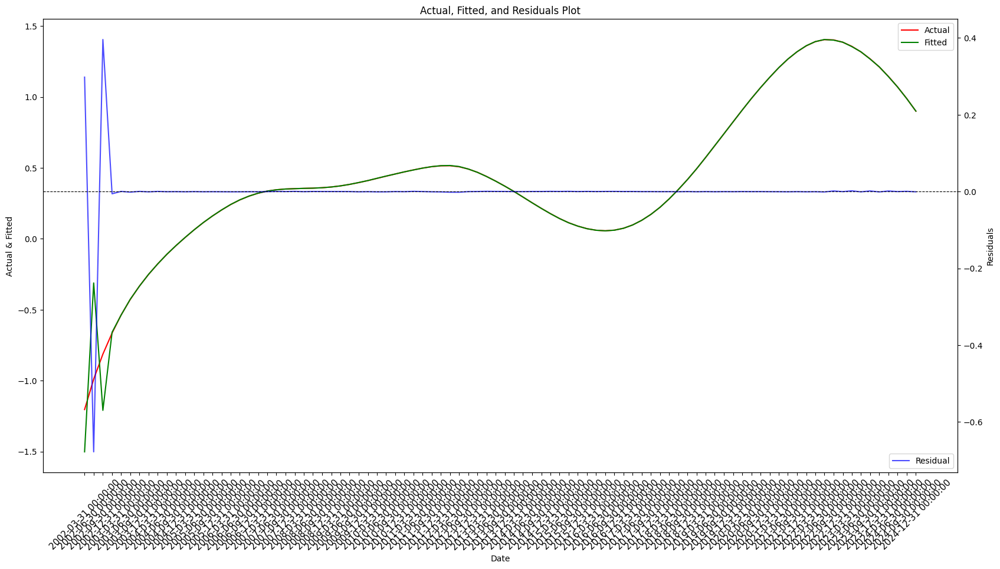

3 0 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 0, 3)   Log Likelihood                 531.931
Date:                Tue, 04 Mar 2025   AIC                          -1045.861
Time:                        04:49:25   BIC                          -1023.565
Sample:                    03-31-2002   HQIC                         -1036.879
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.7931      0.758     -2.364      0.018      -3.280      -0.307
M_SA           1.4830      0.325      4.559      0.000       0.845       2.121
ar.L1          2.8421      0.036     79.259   

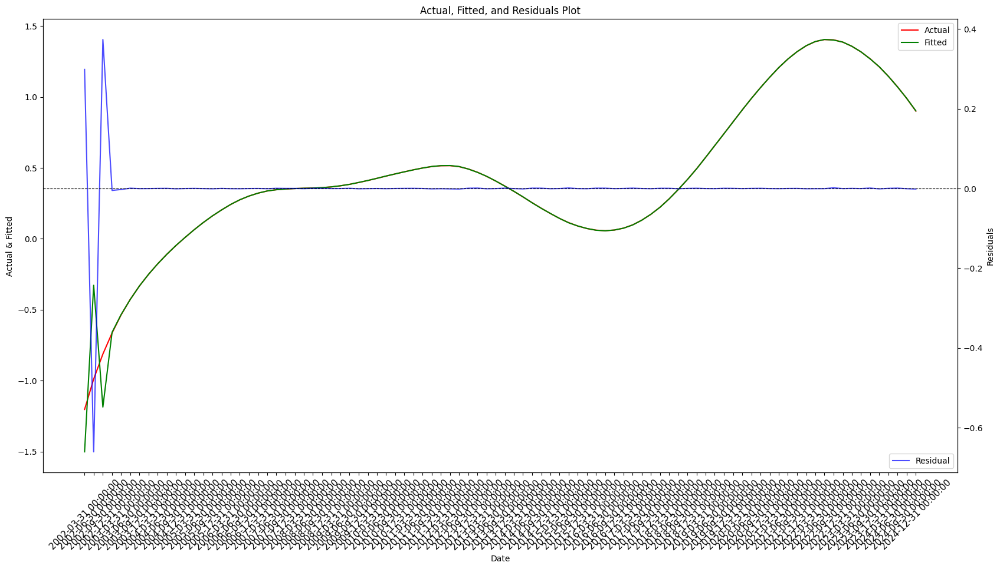

3 0 4
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 0, 4)   Log Likelihood                 550.471
Date:                Tue, 04 Mar 2025   AIC                          -1080.942
Time:                        04:49:27   BIC                          -1056.283
Sample:                    03-31-2002   HQIC                         -1071.013
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.7931      0.074    -24.320      0.000      -1.938      -1.649
M_SA           1.4830      0.303      4.900      0.000       0.890       2.076
ar.L1          2.8466      0.045     63.253   

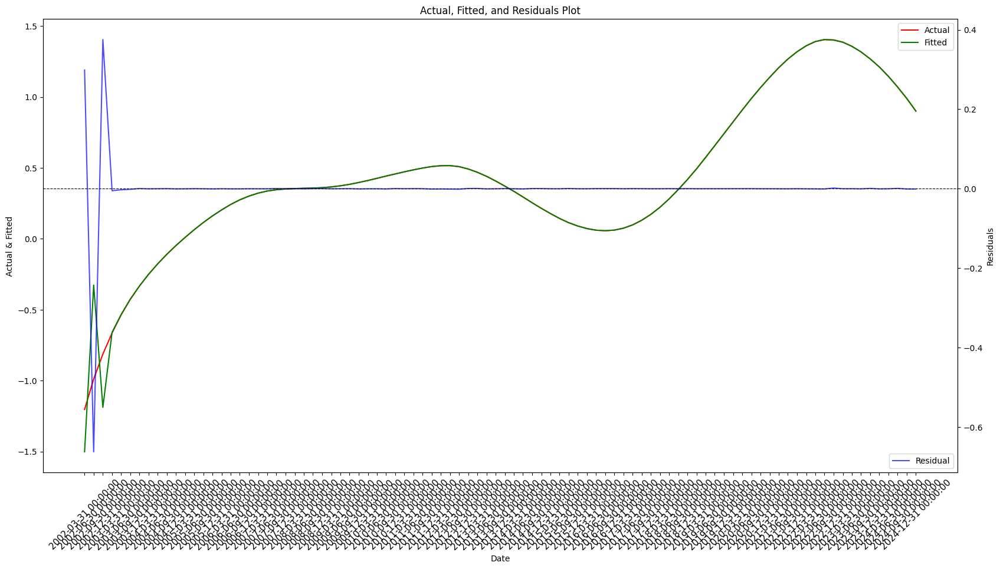

4 0 0
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(4, 0, 0)   Log Likelihood                 536.169
Date:                Tue, 04 Mar 2025   AIC                          -1058.338
Time:                        04:49:30   BIC                          -1040.997
Sample:                    03-31-2002   HQIC                         -1051.352
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.7931      0.873     -2.053      0.040      -3.505      -0.081
M_SA           1.4830      0.268      5.541      0.000       0.958       2.008
ar.L1          3.5996      0.040     90.827   

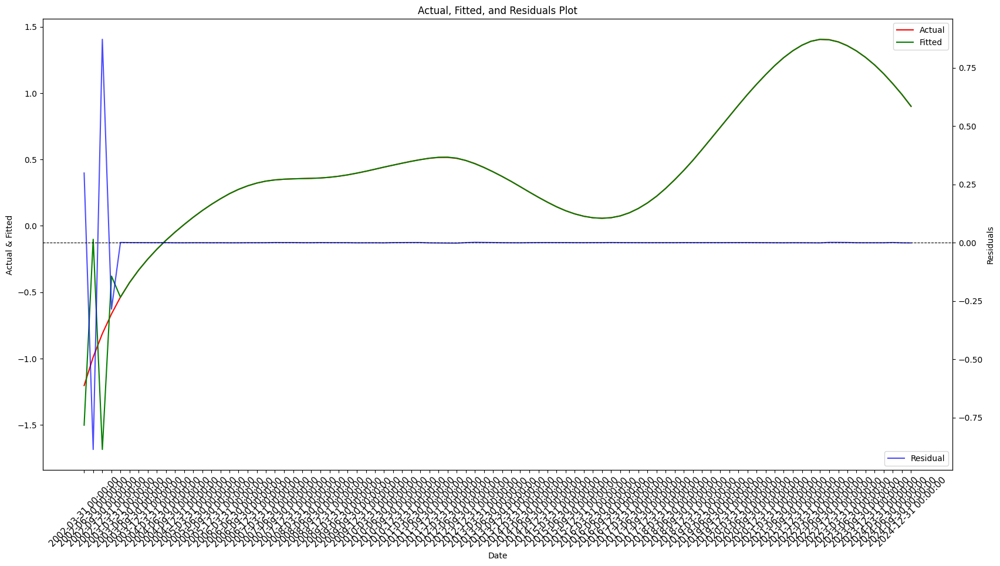

4 0 1
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(4, 0, 1)   Log Likelihood                 343.572
Date:                Tue, 04 Mar 2025   AIC                           -671.143
Time:                        04:49:31   BIC                           -651.324
Sample:                    03-31-2002   HQIC                          -663.159
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.8140      0.158    -11.459      0.000      -2.124      -1.504
M_SA           1.0902      0.089     12.184      0.000       0.915       1.266
ar.L1          1.3780      1.406      0.980   

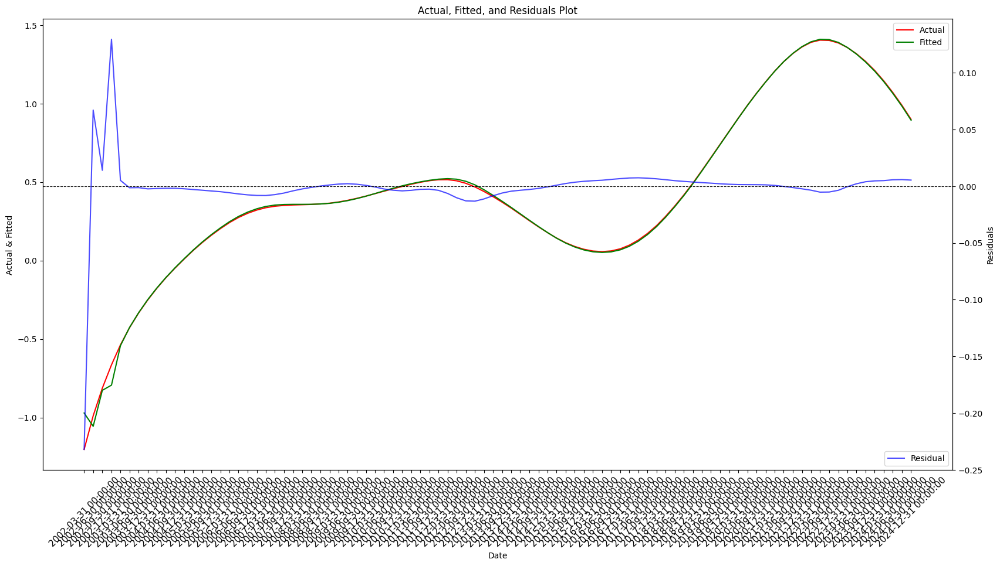

4 0 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(4, 0, 2)   Log Likelihood                 549.579
Date:                Tue, 04 Mar 2025   AIC                          -1081.158
Time:                        04:49:32   BIC                          -1058.862
Sample:                    03-31-2002   HQIC                         -1072.175
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.7931      0.222     -8.083      0.000      -2.228      -1.358
M_SA           1.4830      0.270      5.492      0.000       0.954       2.012
ar.L1          3.4798      0.099     35.230   

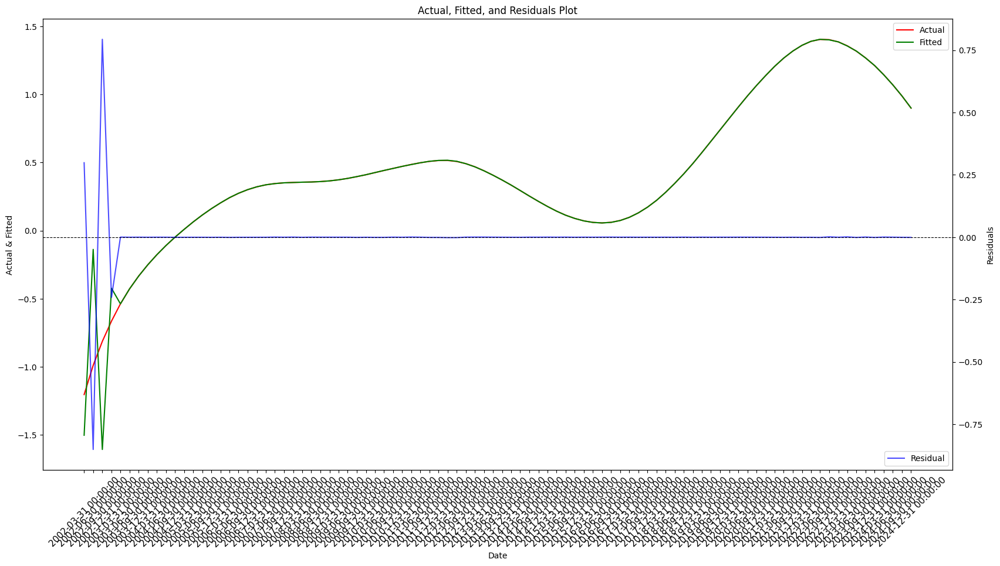

4 0 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(4, 0, 3)   Log Likelihood                 558.128
Date:                Tue, 04 Mar 2025   AIC                          -1096.256
Time:                        04:49:34   BIC                          -1071.483
Sample:                    03-31-2002   HQIC                         -1086.275
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.7931      0.168    -10.651      0.000      -2.123      -1.463
M_SA           1.4830      0.320      4.641      0.000       0.857       2.109
ar.L1          3.0827      0.091     33.693   

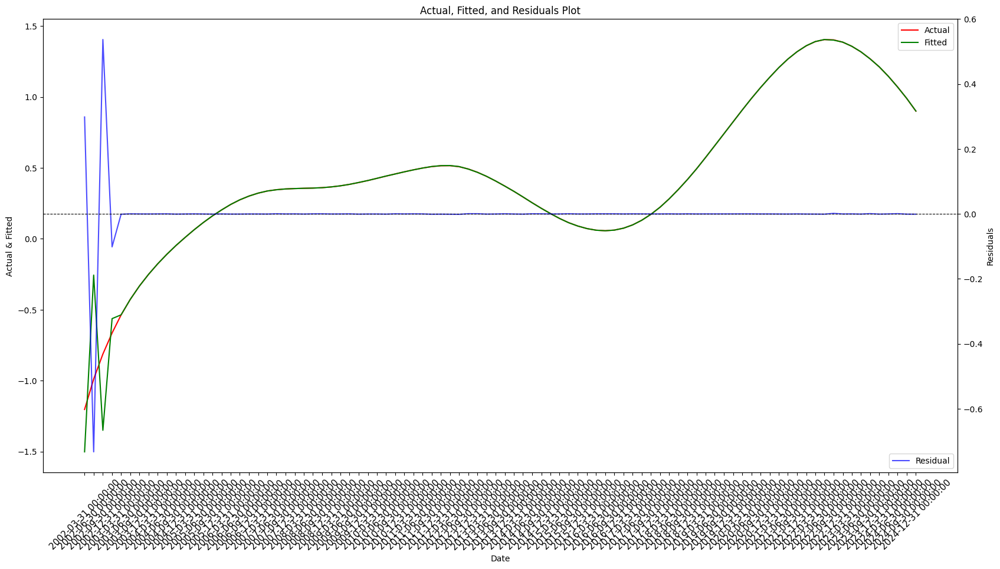

4 0 4
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(4, 0, 4)   Log Likelihood                 553.237
Date:                Tue, 04 Mar 2025   AIC                          -1084.473
Time:                        04:49:36   BIC                          -1057.348
Sample:                    03-31-2002   HQIC                         -1073.551
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.7931      0.047    -38.479      0.000      -1.884      -1.702
M_SA           1.4830      0.294      5.044      0.000       0.907       2.059
ar.L1          3.3530      0.020    165.840   

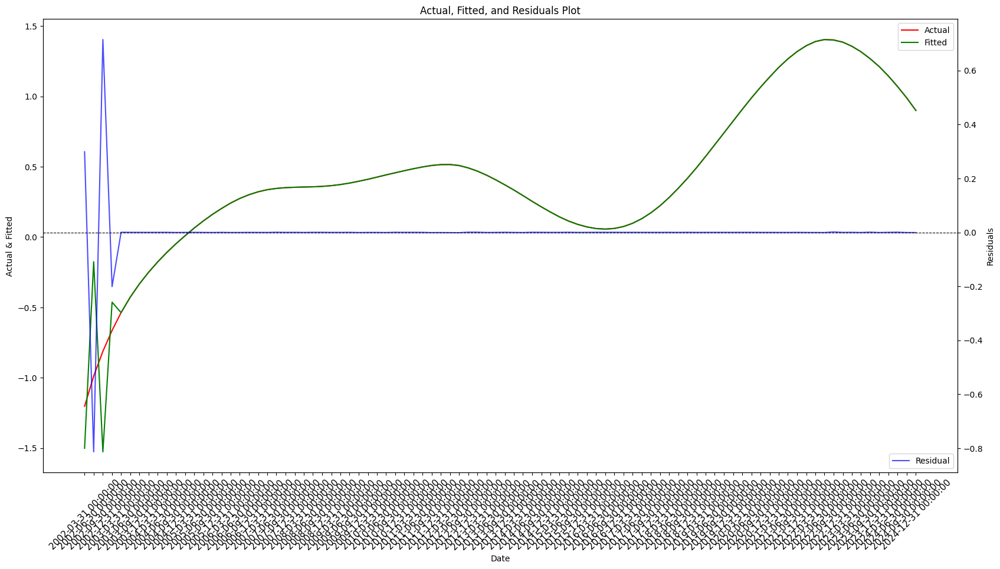

Лучшие параметры SARIMAX: (4, 0, 3)
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(4, 0, 3)   Log Likelihood                 558.128
Date:                Tue, 04 Mar 2025   AIC                          -1096.256
Time:                        04:49:39   BIC                          -1071.483
Sample:                    03-31-2002   HQIC                         -1086.275
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.7931      0.168    -10.651      0.000      -2.123      -1.463
M_SA           1.4830      0.320      4.641      0.000       0.857       2.109
ar.L1          3

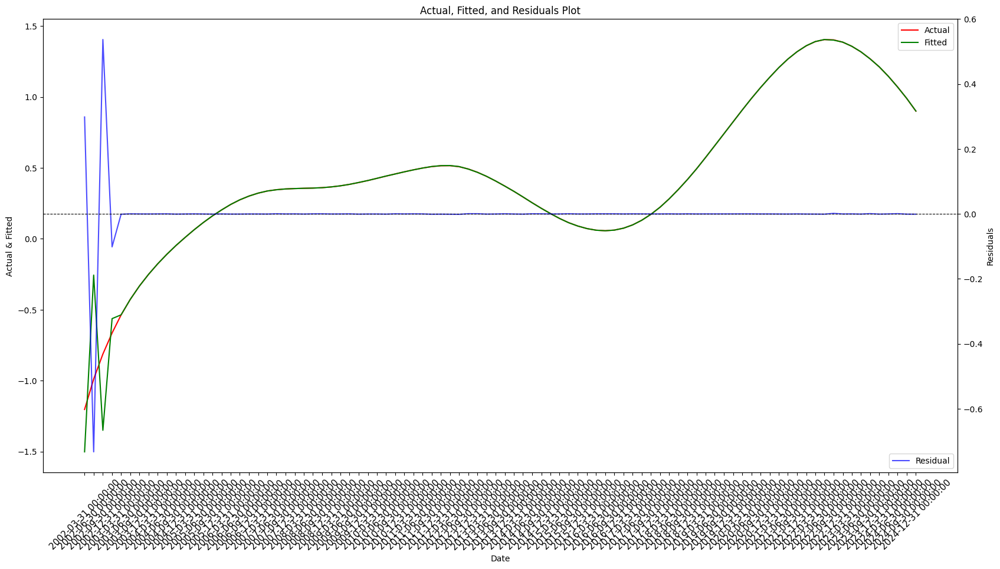

In [63]:
commodity_type = 'Corn'
type_dct = {
    "date": df_transportation_volumes_indexed_adjusted[freq].index,
    "V_SA": np.log(df_transportation_volumes_indexed_adjusted[freq][commodity_type]),   # Transport Volume Growth Index
    "EXP_T": np.log(df_transportation_tariff_indexed_adjusted[freq][commodity_type]),   # Tariff growth index
    "M_SA": np.log(df_volumes_indexed_adjusted[freq][commodity_type]),   # Production growth index
}

# Dummy-переменные
# dct_serial_data = construct_serial_data_by_type(commodity_type, df_volumes, dct_serial)
# for key, value in dct_serial_data.items():
#     type_dct[key] = value

df_type = pd.DataFrame(type_dct)

df_type.set_index('date', inplace=True)

# Целевая переменная и регрессоры
Y = df_type["V_SA"]
X = df_type.drop(columns=["V_SA"])  # Убираем целевую переменную

# Подбор оптимальных p, d, q
p_values = range(0, 5)
d_values = range(0, 3)
q_values = range(0, 5)

best_aic = float("inf")
best_order = None
best_model = None

for p, d, q in tqdm(itertools.product(p_values, d_values, q_values)):
    try:
        model = sm.tsa.statespace.SARIMAX(Y, exog=X, order=(p, d, q), seasonal_order=(0, 0, 0, 0),
                                          enforce_stationarity=False, enforce_invertibility=False)
        results = model.fit(disp=False)

        # Достаем коэффициент и p-value для "T"
        coef_T = results.params.get("EXP_T", None)
        pval_T = results.pvalues.get("EXP_T", None)

        # Условие: коэффициент при T должен быть отрицательным и значимым (p < 0.05)
        if coef_T is not None and coef_T < 0 and pval_T is not None and pval_T < 0.05:
            if results.aic < best_aic:
                best_aic = results.aic
                best_order = (p, d, q)
                best_model = results
            print(p, d, q)
            print(results.summary())
            plot_regression_results(results, df_type)

    except:
        continue

# Вывод результатов
if best_model:
    print(f"Лучшие параметры SARIMAX: {best_order}")
    print(best_model.summary())
    plot_regression_results(best_model, df_type)
else:
    print("Не удалось найти подходящую модель, удовлетворяющую условиям.")

### 🐀 Coal

**********************************************************************************
commodity type: Coal


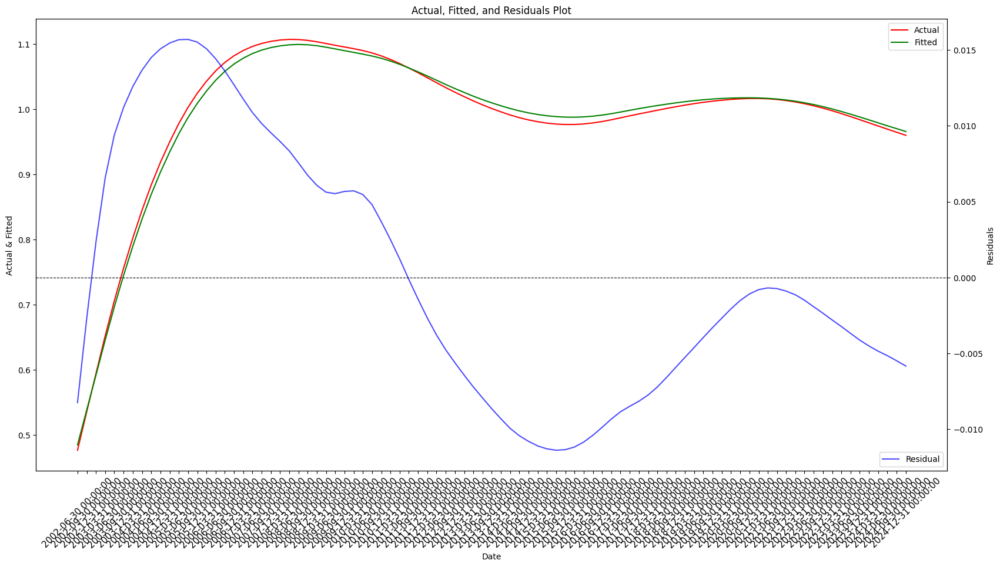

                            OLS Regression Results                            
Dep. Variable:                   V_SA   R-squared:                       0.995
Model:                            OLS   Adj. R-squared:                  0.995
Method:                 Least Squares   F-statistic:                     5543.
Date:                Tue, 04 Mar 2025   Prob (F-statistic):           3.44e-99
Time:                        04:49:41   Log-Likelihood:                 306.82
No. Observations:                  91   AIC:                            -605.6
Df Residuals:                      87   BIC:                            -595.6
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.1654      0.025      6.645      0.0

In [64]:
commodity_type = 'Coal'
type_dct = {
    "date": df_transportation_volumes_indexed_adjusted[freq].index,
    "V_SA": df_transportation_volumes_indexed_adjusted[freq][commodity_type],   # Transport Volume Growth Index
    "EXP_T": df_transportation_tariff_indexed_adjusted[freq][commodity_type],   # Tariff growth index
    "M_SA": df_volumes_indexed_adjusted[freq][commodity_type],   # Production growth index
}
# dummy variables
# dct_serial_data = construct_serial_data_by_type(commodity_type, df_volumes, dct_serial)
# for key, value in dct_serial_data.items():
#   type_dct[key] = value

df_type = pd.DataFrame(type_dct)

df_type["V_SA(-1)"] = df_type["V_SA"].shift(1)

df_type = df_type.dropna()

Y = df_type["V_SA"]
lst_data = [i for i in df_type.columns if i != 'V_SA' and i != 'date']
X = df_type[[i for i in df_type.columns if i in lst_data]]
df_type.set_index('date', inplace=True)
# Adding a constant for regression
X = sm.add_constant(X)

# Make regression
model = sm.OLS(Y, X).fit()

print("**********************************************************************************")
print("commodity type:", commodity_type)

# Print results
plot_regression_results(model, df_type)
print(model.summary())

In [65]:
commodity_type = 'Coal'
type_dct = {
    "date": df_transportation_volumes_indexed_adjusted[freq].index,
    "V_SA": df_transportation_volumes_indexed_adjusted[freq][commodity_type],   # Transport Volume Growth Index
    "EXP_T": df_transportation_tariff_indexed_adjusted[freq][commodity_type],   # Tariff growth index
    "M_SA": df_volumes_indexed_adjusted[freq][commodity_type],   # Production growth index
}

# Dummy-переменные
# dct_serial_data = construct_serial_data_by_type(commodity_type, df_volumes, dct_serial)
# for key, value in dct_serial_data.items():
#     type_dct[key] = value

df_type = pd.DataFrame(type_dct)

df_type.set_index('date', inplace=True)

# Целевая переменная и регрессоры
Y = df_type["V_SA"]
X = df_type.drop(columns=["V_SA"])  # Убираем целевую переменную

# Подбор оптимальных p, d, q
p_values = range(0, 5)
d_values = range(0, 3)
q_values = range(0, 5)

best_aic = float("inf")
best_order = None
best_model = None

for p, d, q in tqdm(itertools.product(p_values, d_values, q_values)):
    try:
        model = sm.tsa.statespace.SARIMAX(Y, exog=X, order=(p, d, q), seasonal_order=(0, 0, 0, 0),
                                          enforce_stationarity=False, enforce_invertibility=False)
        results = model.fit(disp=False)

        # Достаем коэффициент и p-value для "T"
        coef_T = results.params.get("EXP_T", None)
        pval_T = results.pvalues.get("EXP_T", None)

        # Условие: коэффициент при T должен быть отрицательным и значимым (p < 0.05)
        if coef_T is not None and coef_T < 0 and pval_T is not None and pval_T < 0.05:
            if results.aic < best_aic:
                best_aic = results.aic
                best_order = (p, d, q)
                best_model = results
            print(p, d, q)
            print(results.summary())
            plot_regression_results(results, df_type)

    except:
        continue

# Вывод результатов
if best_model:
    print(f"Лучшие параметры SARIMAX: {best_order}")
    print(best_model.summary())
    plot_regression_results(best_model, df_type)
else:
    print("Не удалось найти подходящую модель, удовлетворяющую условиям.")

0it [00:00, ?it/s]

Не удалось найти подходящую модель, удовлетворяющую условиям.


In [66]:
commodity_type = 'Coal'
type_dct = {
    "date": df_transportation_volumes_indexed_adjusted[freq].index,
    "V_SA": df_transportation_volumes_indexed_adjusted[freq][commodity_type],   # Transport Volume Growth Index
    "EXP_T": df_transportation_tariff_indexed_adjusted[freq][commodity_type],   # Tariff growth index
    "M_SA": df_volumes_indexed_adjusted[freq][commodity_type],   # Production growth index
}

# Добавляем dummy-переменные
# dct_serial_data = construct_serial_data_by_type(commodity_type, df_volumes, dct_serial)
# for key, value in dct_serial_data.items():
#     type_dct[key] = value

df_type = pd.DataFrame(type_dct)

# Добавляем лаг переменной Y
df_type["V_SA(-1)"] = df_type["V_SA"].shift(1)

# Удаляем строки с пропущенными значениями
df_type = df_type.dropna()

# Определяем зависимую переменную
Y = df_type["V_SA"]

# Обязательные переменные
mandatory_features = ["EXP_T", "V_SA(-1)"]

# Все возможные дополнительные переменные (кроме "Y" и "date")
optional_features = [col for col in df_type.columns if col not in ["V_SA", "date"] and col not in mandatory_features]

best_model = None
best_adj_r2 = -np.inf  # Максимизируем скорректированный R²
best_features = None

# Перебираем все возможные комбинации дополнительных признаков
for r in tqdm(range(len(optional_features) + 1)):  # От 0 до всех возможных переменных
    for subset in itertools.combinations(optional_features, r):
        selected_features = list(mandatory_features) + list(subset)
        X = df_type[selected_features]
        #X = sm.add_constant(X)
        # Строим регрессию
        model = sm.OLS(Y, X).fit()

        # Проверяем условия
        if model.pvalues["EXP_T"] < 0.1 and model.pvalues["V_SA(-1)"] < 0.1 and model.params["EXP_T"] < 0:
            best_model = model
            best_features = selected_features
            flag = True
            print(model.summary())
            # Выбираем модель с наибольшим скорректированным R²
            if model.rsquared_adj > best_adj_r2:
                best_model = model
                best_adj_r2 = model.rsquared_adj
                best_features = selected_features
# Выводим результаты лучшей модели
if best_model:
    print("Лучшая модель:")
    print(f"Выбранные переменные: {best_features}")
    print(best_model.summary())
    plot_regression_results(best_model, df_type)
else:
    print("Не найдено моделей, удовлетворяющих условиям.")

  0%|          | 0/2 [00:00<?, ?it/s]

Не найдено моделей, удовлетворяющих условиям.


### 🦊 Petrol

**********************************************************************************
commodity type: Petrol


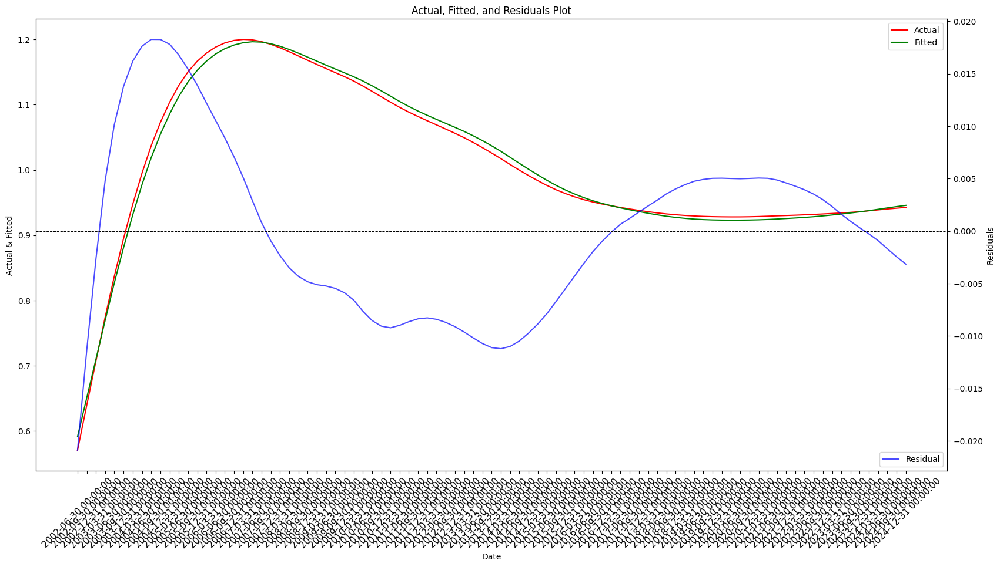

                            OLS Regression Results                            
Dep. Variable:                   V_SA   R-squared:                       0.995
Model:                            OLS   Adj. R-squared:                  0.995
Method:                 Least Squares   F-statistic:                     6378.
Date:                Tue, 04 Mar 2025   Prob (F-statistic):          7.94e-102
Time:                        04:49:56   Log-Likelihood:                 307.50
No. Observations:                  91   AIC:                            -607.0
Df Residuals:                      87   BIC:                            -596.9
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0946      0.020      4.647      0.0

In [67]:
commodity_type = 'Petrol'
type_dct = {
    "date": df_transportation_volumes_indexed_adjusted[freq].index,
    "V_SA": df_transportation_volumes_indexed_adjusted[freq][commodity_type],   # Transport Volume Growth Index
    "EXP_T": df_transportation_tariff_indexed_adjusted[freq][commodity_type],   # Tariff growth index
    "M_SA": df_volumes_indexed_adjusted[freq][commodity_type],   # Production growth index
}
# dummy variables
# dct_serial_data = construct_serial_data_by_type(commodity_type, df_volumes, dct_serial)
# for key, value in dct_serial_data.items():
#   type_dct[key] = value

df_type = pd.DataFrame(type_dct)

df_type["V_SA(-1)"] = df_type["V_SA"].shift(1)

df_type = df_type.dropna()

Y = df_type["V_SA"]
lst_data = [i for i in df_type.columns if i != 'V_SA' and i != 'date']
X = df_type[[i for i in df_type.columns if i in lst_data]]
df_type.set_index('date', inplace=True)
# Adding a constant for regression
X = sm.add_constant(X)

# Make regression
model = sm.OLS(Y, X).fit()

print("**********************************************************************************")
print("commodity type:", commodity_type)

# correlation_matrix = df_type.corr()
# print(correlation_matrix)
# Print results
plot_regression_results(model, df_type)
print(model.summary())

In [68]:
commodity_type = 'Petrol'
type_dct = {
    "date": df_transportation_volumes_indexed_adjusted[freq].index,
    "V_SA": df_transportation_volumes_indexed_adjusted[freq][commodity_type],   # Transport Volume Growth Index
    "EXP_T": df_transportation_tariff_indexed_adjusted[freq][commodity_type],   # Tariff growth index
    "M_SA": df_volumes_indexed_adjusted[freq][commodity_type],   # Production growth index
}

# Dummy-переменные
# dct_serial_data = construct_serial_data_by_type(commodity_type, df_volumes, dct_serial)
# for key, value in dct_serial_data.items():
#     type_dct[key] = value

df_type = pd.DataFrame(type_dct)

df_type.set_index('date', inplace=True)

# Целевая переменная и регрессоры
Y = df_type["V_SA"]
X = df_type.drop(columns=["V_SA"])  # Убираем целевую переменную

# Подбор оптимальных p, d, q
p_values = range(0, 5)
d_values = range(0, 2)
q_values = range(0, 5)

best_aic = float("inf")
best_order = None
best_model = None

for p, d, q in tqdm(itertools.product(p_values, d_values, q_values)):
    try:
        model = sm.tsa.statespace.SARIMAX(Y, exog=X, order=(p, d, q), seasonal_order=(0, 0, 0, 0),
                                          enforce_stationarity=False, enforce_invertibility=False)
        results = model.fit(disp=False)

        # Достаем коэффициент и p-value для "T"
        coef_T = results.params.get("EXP_T", None)
        pval_T = results.pvalues.get("EXP_T", None)

        # Условие: коэффициент при T должен быть отрицательным и значимым (p < 0.05)
        if coef_T is not None and coef_T < 0 and pval_T is not None and pval_T < 0.05:
            if results.aic < best_aic:
                best_aic = results.aic
                best_order = (p, d, q)
                best_model = results
            print(p, d, q)
            print(results.summary())
            plot_regression_results(results, df_type)

    except:
        continue

# Вывод результатов
if best_model:
    print(f"Лучшие параметры SARIMAX: {best_order}")
    print(best_model.summary())
    plot_regression_results(best_model, df_type)
else:
    print("Не удалось найти подходящую модель, удовлетворяющую условиям.")

0it [00:00, ?it/s]

Не удалось найти подходящую модель, удовлетворяющую условиям.


### 🦡 Scrap

0it [00:00, ?it/s]

0 0 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(0, 0, 2)   Log Likelihood                  40.857
Date:                Tue, 04 Mar 2025   AIC                            -71.714
Time:                        04:50:07   BIC                            -59.270
Sample:                    03-31-2002   HQIC                           -66.698
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.6894      0.338     -2.039      0.041      -1.352      -0.027
M_SA           1.7342      0.284      6.109      0.000       1.178       2.291
ma.L1        -19.3397     69.861     -0.277   

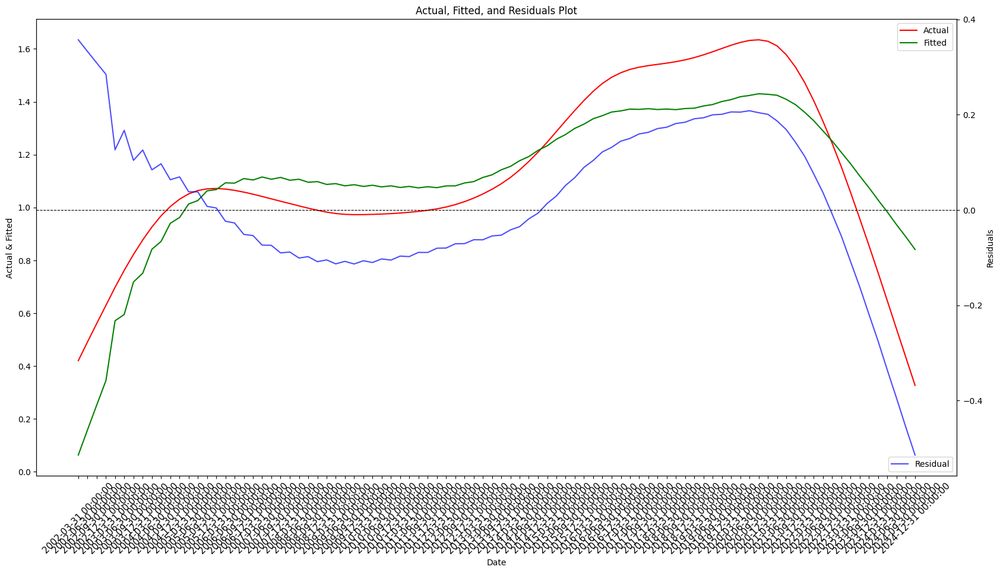

0 0 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(0, 0, 3)   Log Likelihood                  78.141
Date:                Tue, 04 Mar 2025   AIC                           -144.282
Time:                        04:50:09   BIC                           -129.418
Sample:                    03-31-2002   HQIC                          -138.294
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.6802      0.234     -7.182      0.000      -2.139      -1.222
M_SA           2.5604      0.221     11.583      0.000       2.127       2.994
ma.L1        -14.0512     32.432     -0.433   

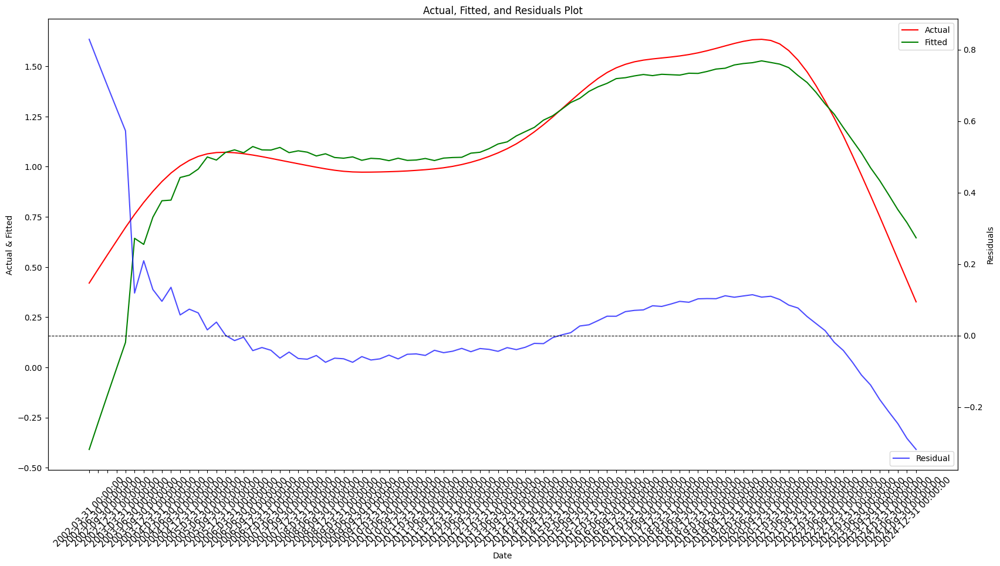

0 0 4
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(0, 0, 4)   Log Likelihood                  93.856
Date:                Tue, 04 Mar 2025   AIC                           -173.711
Time:                        04:50:10   BIC                           -156.450
Sample:                    03-31-2002   HQIC                          -166.760
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -1.0281      0.294     -3.491      0.000      -1.605      -0.451
M_SA           1.9992      0.262      7.617      0.000       1.485       2.514
ma.L1        -13.3414     10.666     -1.251   

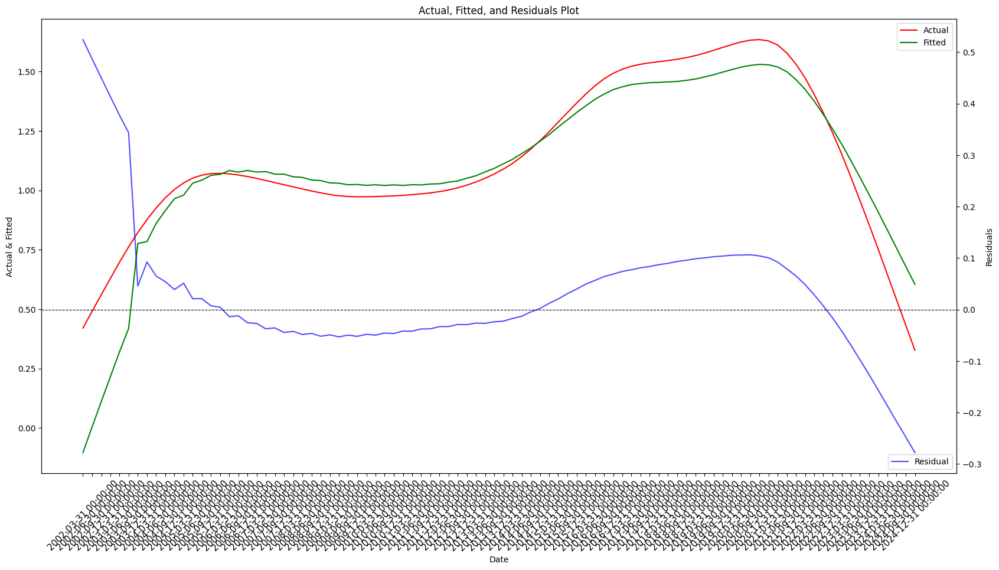

0 1 0
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(0, 1, 0)   Log Likelihood                 182.967
Date:                Tue, 04 Mar 2025   AIC                           -359.934
Time:                        04:50:11   BIC                           -352.434
Sample:                    03-31-2002   HQIC                          -356.909
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4408      1.039     -7.160      0.000      -9.478      -5.404
M_SA           1.9421      0.562      3.457      0.001       0.841       3.043
sigma2         0.0010      0.000      6.559   

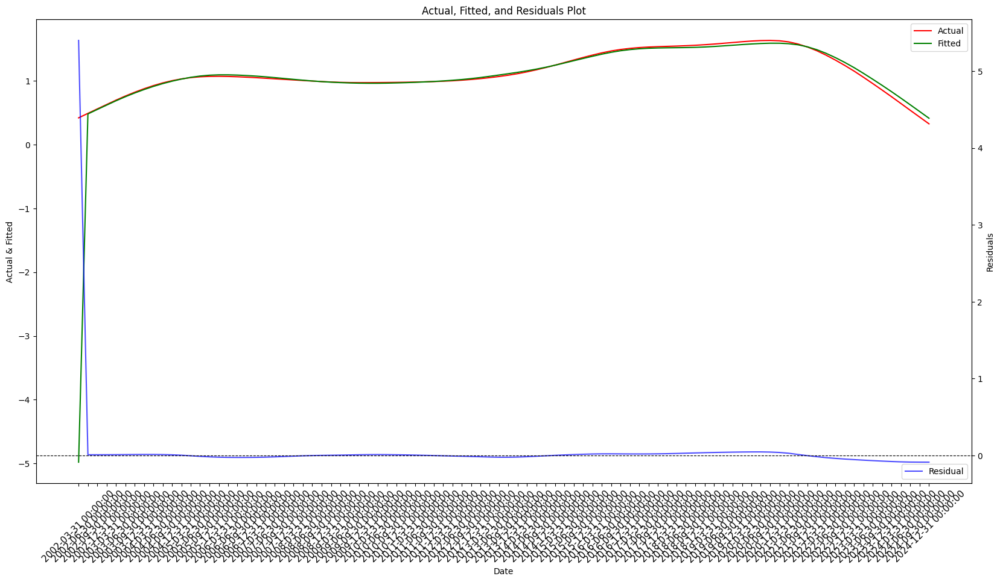

0 1 1
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(0, 1, 1)   Log Likelihood                 238.104
Date:                Tue, 04 Mar 2025   AIC                           -468.209
Time:                        04:50:13   BIC                           -458.254
Sample:                    03-31-2002   HQIC                          -464.197
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4441      1.101     -6.764      0.000      -9.601      -5.287
M_SA           1.9318      0.600      3.222      0.001       0.757       3.107
ma.L1          0.9999     64.228      0.016   

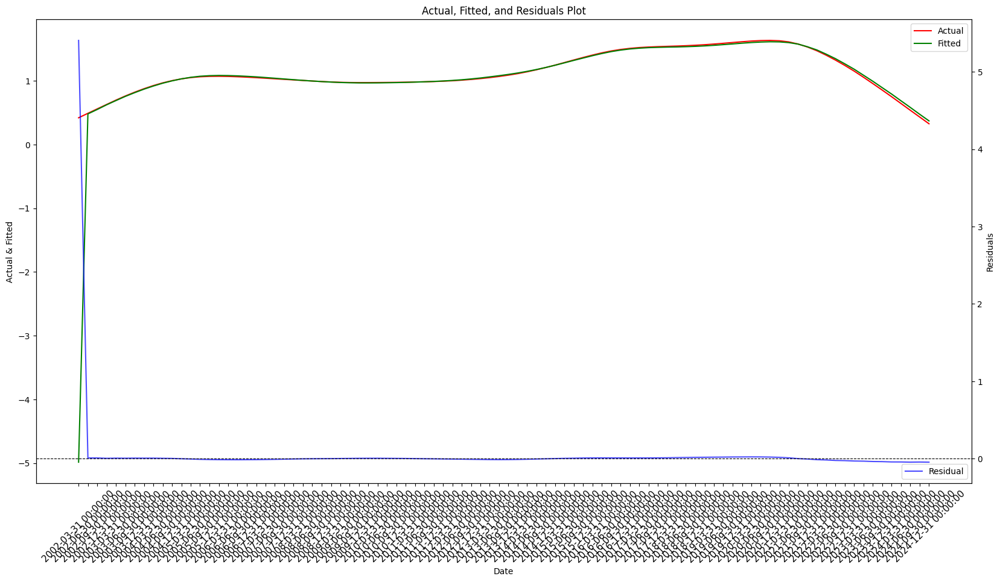

0 1 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(0, 1, 2)   Log Likelihood                 289.971
Date:                Tue, 04 Mar 2025   AIC                           -569.942
Time:                        04:50:14   BIC                           -557.555
Sample:                    03-31-2002   HQIC                          -564.952
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4894      1.143     -6.554      0.000      -9.729      -5.250
M_SA           1.8369      0.525      3.502      0.000       0.809       2.865
ma.L1          1.9348      6.691      0.289   

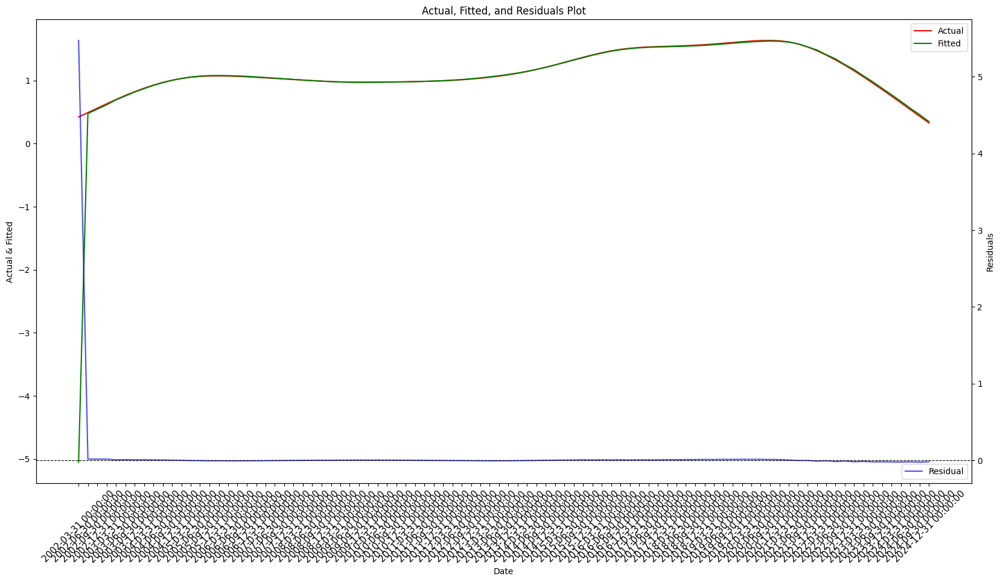

0 1 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(0, 1, 3)   Log Likelihood                 325.851
Date:                Tue, 04 Mar 2025   AIC                           -639.701
Time:                        04:50:16   BIC                           -624.906
Sample:                    03-31-2002   HQIC                          -633.743
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.5072      1.670     -4.496      0.000     -10.780      -4.234
M_SA           1.5989      0.563      2.838      0.005       0.495       2.703
ma.L1          3.0312      0.271     11.197   

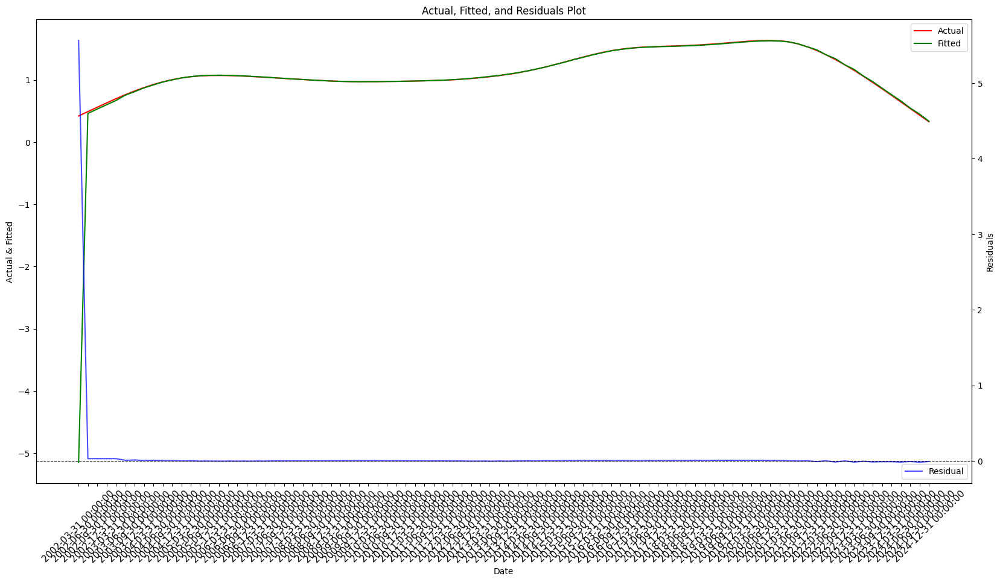

0 1 4
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(0, 1, 4)   Log Likelihood                 243.634
Date:                Tue, 04 Mar 2025   AIC                           -473.267
Time:                        04:50:17   BIC                           -456.087
Sample:                    03-31-2002   HQIC                          -466.353
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      1.271     -5.851      0.000      -9.931      -4.947
M_SA           1.9594      0.832      2.355      0.019       0.328       3.590
ma.L1          0.9881      8.637      0.114   

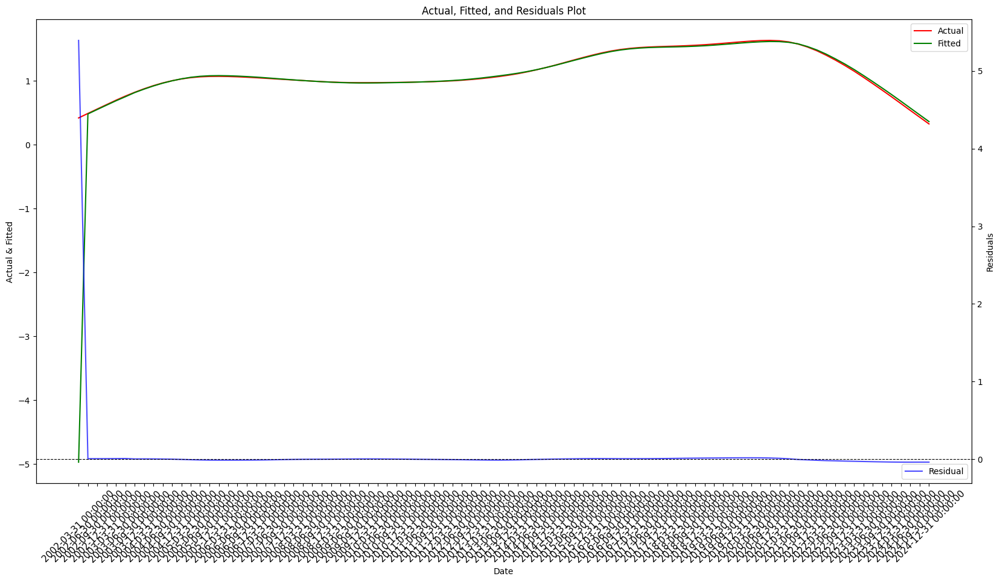

1 1 0
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(1, 1, 0)   Log Likelihood                 354.779
Date:                Tue, 04 Mar 2025   AIC                           -701.557
Time:                        04:50:19   BIC                           -691.558
Sample:                    03-31-2002   HQIC                          -697.525
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      1.757     -4.234      0.000     -10.882      -3.996
M_SA           1.9594      0.420      4.668      0.000       1.137       2.782
ar.L1          1.0336      0.022     47.098   

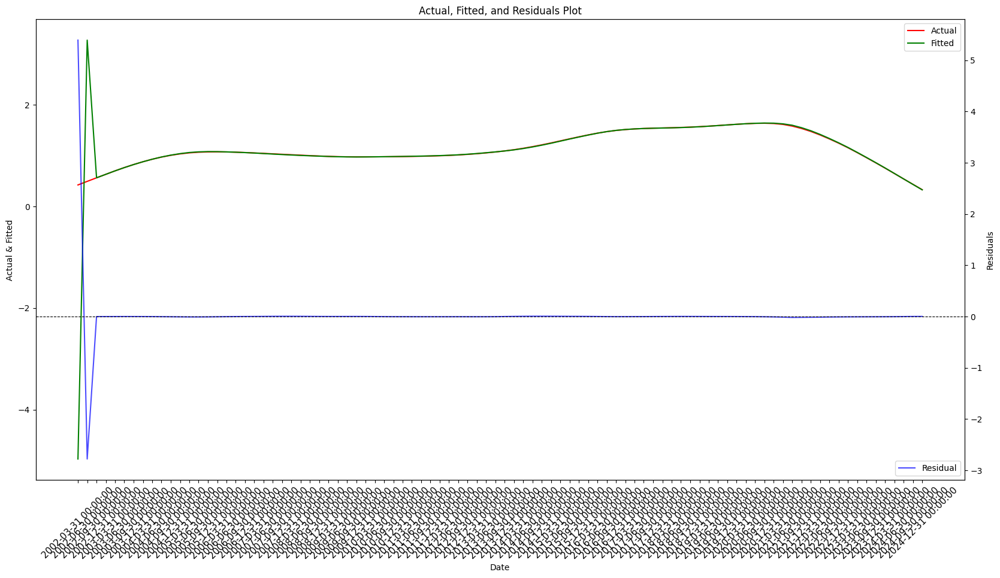

1 1 1
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(1, 1, 1)   Log Likelihood                 389.934
Date:                Tue, 04 Mar 2025   AIC                           -769.868
Time:                        04:50:20   BIC                           -757.425
Sample:                    03-31-2002   HQIC                          -764.853
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      2.576     -2.888      0.004     -12.487      -2.391
M_SA           1.9594      0.468      4.188      0.000       1.042       2.876
ar.L1          1.0340      0.023     45.946   

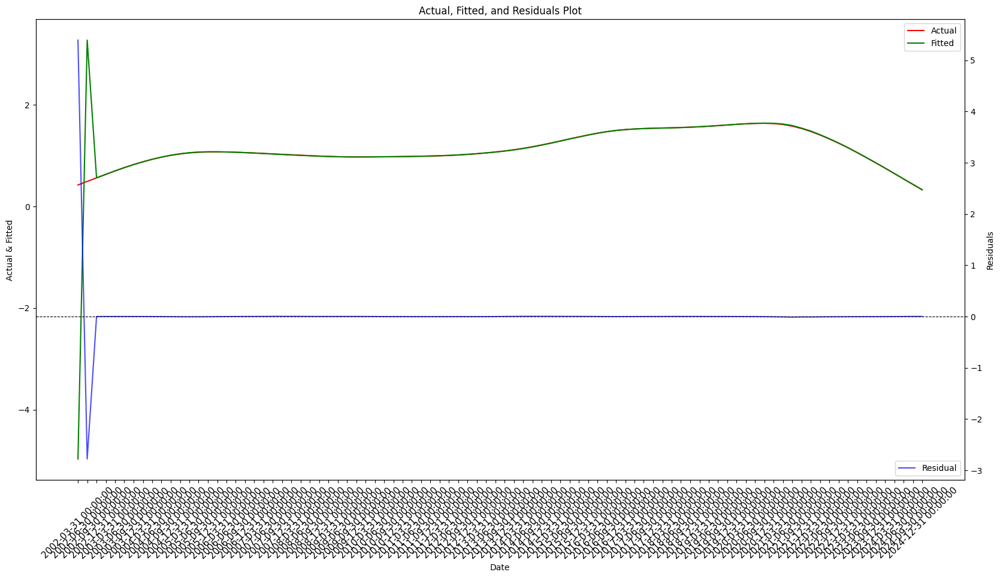

1 1 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(1, 1, 2)   Log Likelihood                 414.018
Date:                Tue, 04 Mar 2025   AIC                           -816.036
Time:                        04:50:21   BIC                           -801.172
Sample:                    03-31-2002   HQIC                          -810.047
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      0.176    -42.303      0.000      -7.783      -7.094
M_SA           1.9594      0.369      5.303      0.000       1.235       2.683
ar.L1          1.0325      0.023     45.849   

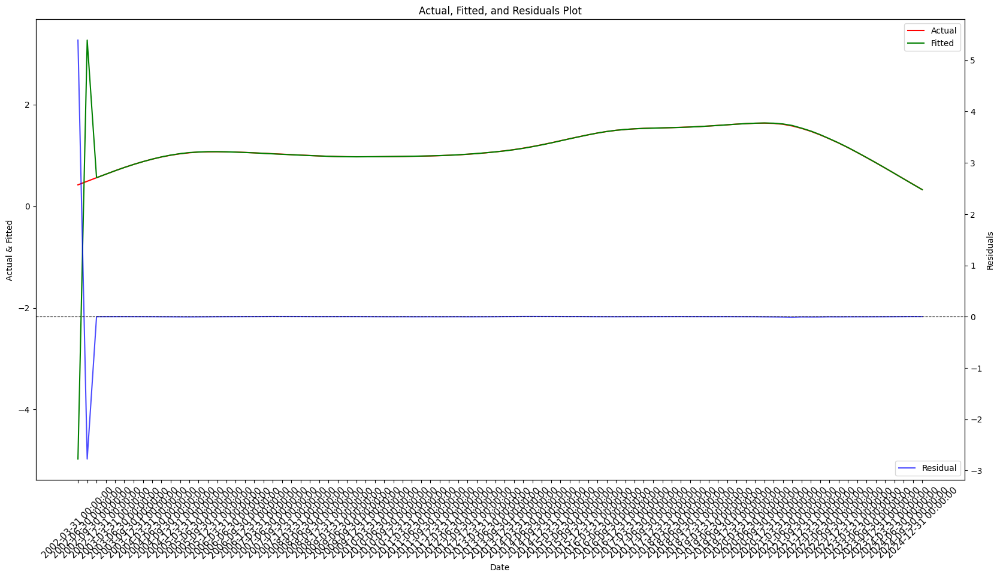

1 1 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(1, 1, 3)   Log Likelihood                 431.873
Date:                Tue, 04 Mar 2025   AIC                           -849.747
Time:                        04:50:24   BIC                           -832.486
Sample:                    03-31-2002   HQIC                          -842.796
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      0.049   -153.229      0.000      -7.534      -7.344
M_SA           1.9594      0.382      5.132      0.000       1.211       2.708
ar.L1          1.0305      0.023     44.344   

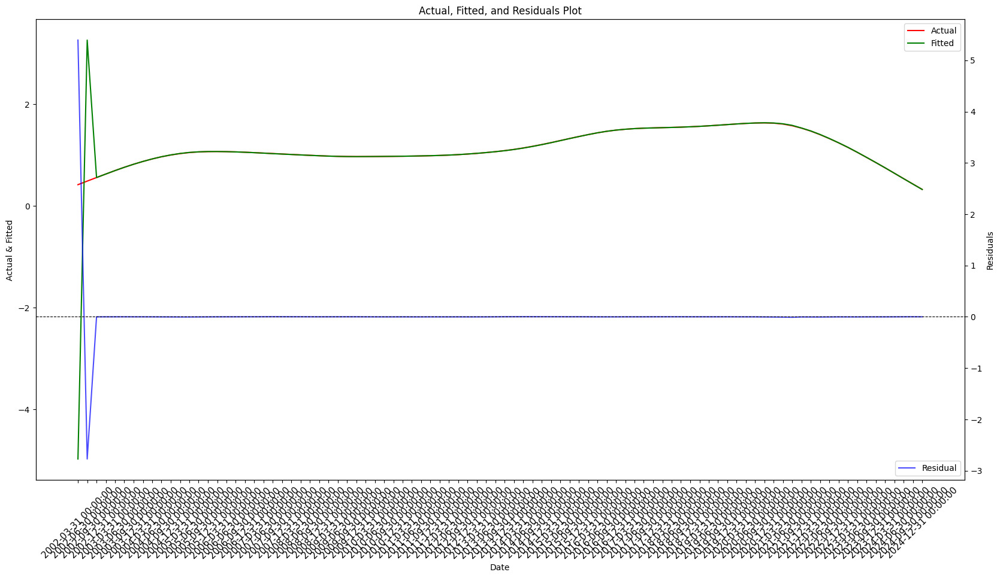

1 1 4
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(1, 1, 4)   Log Likelihood                 450.791
Date:                Tue, 04 Mar 2025   AIC                           -885.581
Time:                        04:50:26   BIC                           -865.946
Sample:                    03-31-2002   HQIC                          -877.679
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      0.062   -119.394      0.000      -7.561      -7.317
M_SA           1.9594      0.435      4.508      0.000       1.107       2.811
ar.L1          1.0235      0.025     40.883   

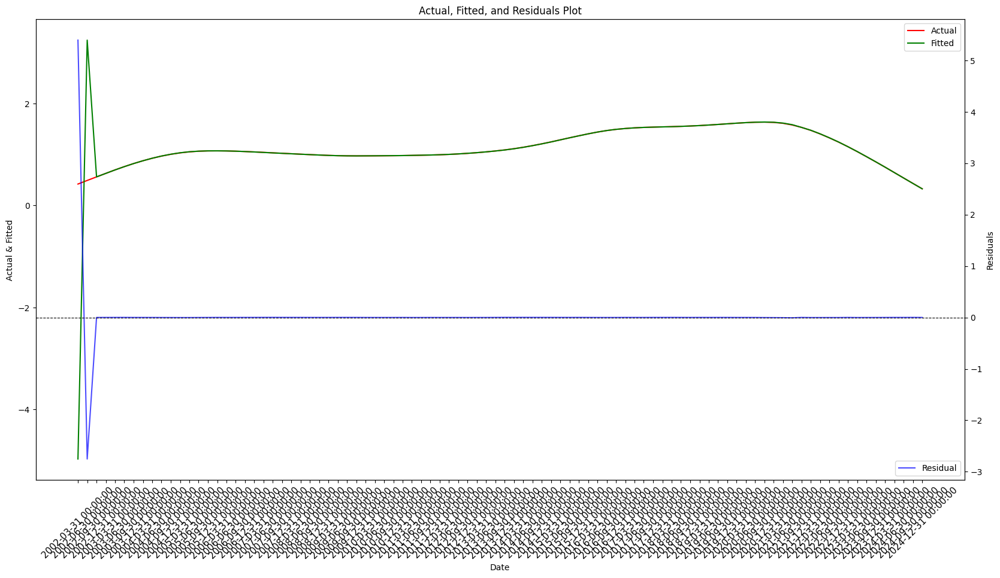

2 0 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(2, 0, 2)   Log Likelihood                 480.512
Date:                Tue, 04 Mar 2025   AIC                           -947.024
Time:                        04:50:28   BIC                           -929.603
Sample:                    03-31-2002   HQIC                          -940.002
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.3635      0.096     -3.801      0.000      -0.551      -0.176
M_SA           1.4701      0.083     17.644      0.000       1.307       1.633
ar.L1          2.0655      0.012    173.525   

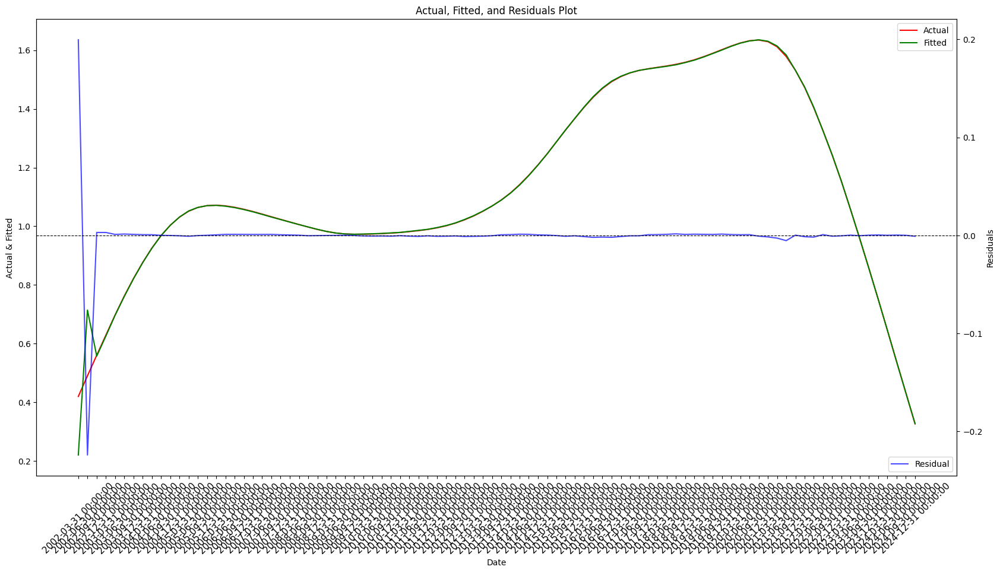

2 0 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(2, 0, 3)   Log Likelihood                 494.609
Date:                Tue, 04 Mar 2025   AIC                           -973.219
Time:                        04:50:29   BIC                           -953.400
Sample:                    03-31-2002   HQIC                          -965.234
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.3635      0.114     -3.193      0.001      -0.587      -0.140
M_SA           1.4701      0.100     14.759      0.000       1.275       1.665
ar.L1          2.0650      0.012    178.991   

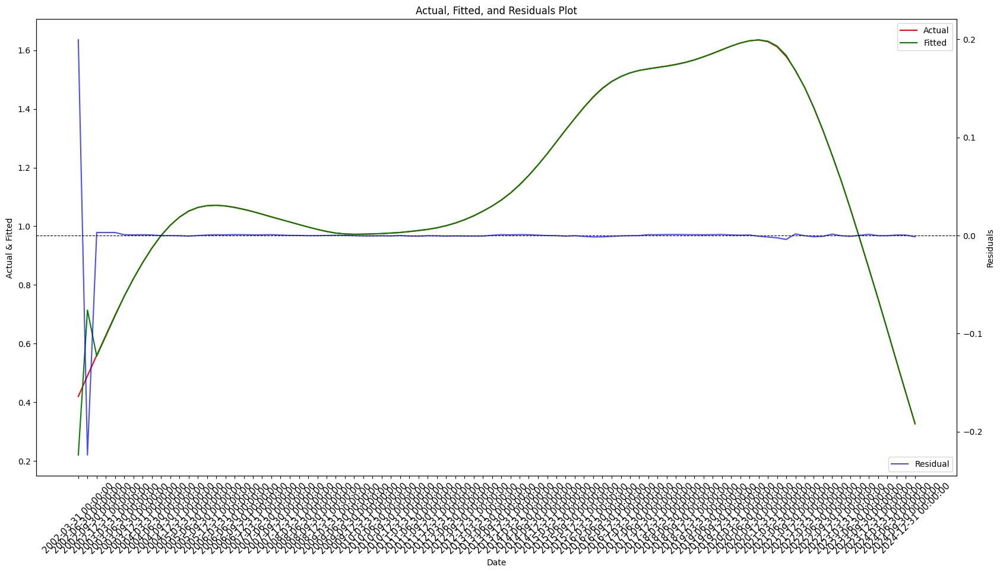

2 1 0
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(2, 1, 0)   Log Likelihood                 476.212
Date:                Tue, 04 Mar 2025   AIC                           -942.423
Time:                        04:50:30   BIC                           -929.980
Sample:                    03-31-2002   HQIC                          -937.408
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      1.742     -4.271      0.000     -10.852      -4.025
M_SA           1.9594      0.304      6.437      0.000       1.363       2.556
ar.L1          1.9937      0.029     69.190   

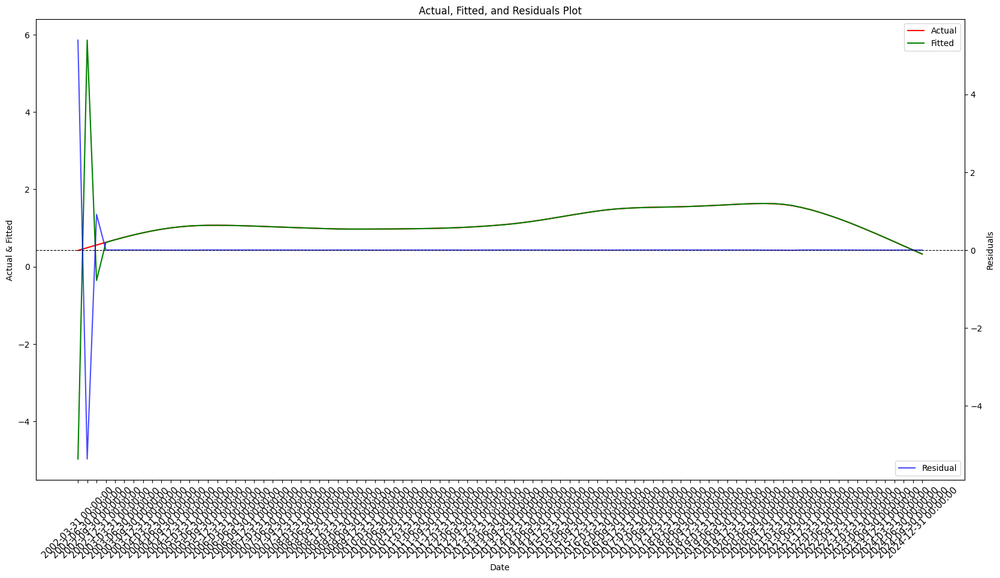

2 1 1
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(2, 1, 1)   Log Likelihood                 496.400
Date:                Tue, 04 Mar 2025   AIC                           -980.801
Time:                        04:50:32   BIC                           -965.869
Sample:                    03-31-2002   HQIC                          -974.782
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      0.000  -3.55e+04      0.000      -7.439      -7.438
M_SA           1.9594      0.567      3.454      0.001       0.848       3.071
ar.L1          1.9501      0.025     79.591   

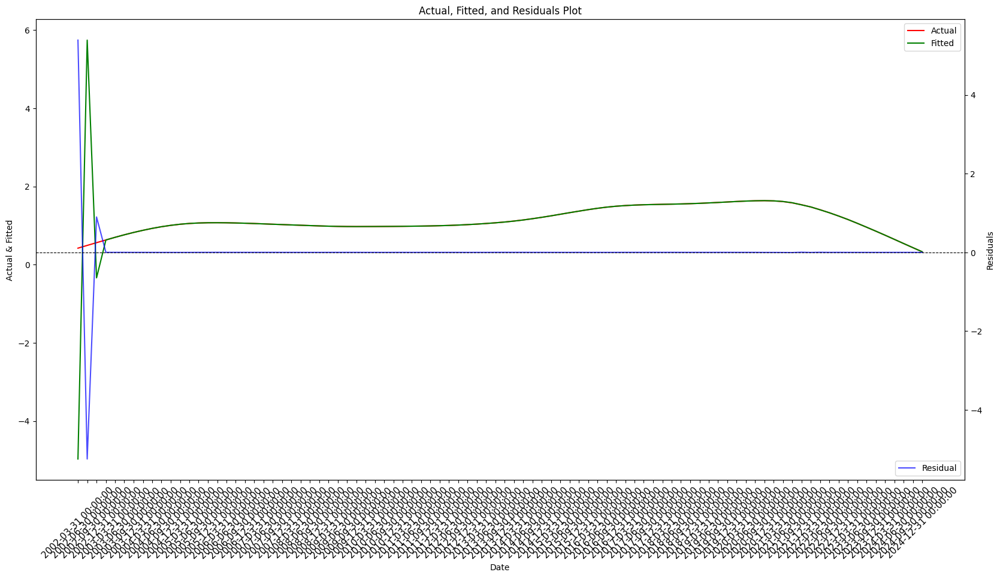

2 1 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(2, 1, 2)   Log Likelihood                 488.529
Date:                Tue, 04 Mar 2025   AIC                           -963.059
Time:                        04:50:33   BIC                           -945.717
Sample:                    03-31-2002   HQIC                          -956.072
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      0.002  -4236.840      0.000      -7.442      -7.435
M_SA           1.9594      0.730      2.685      0.007       0.529       3.390
ar.L1          1.9350      0.033     58.143   

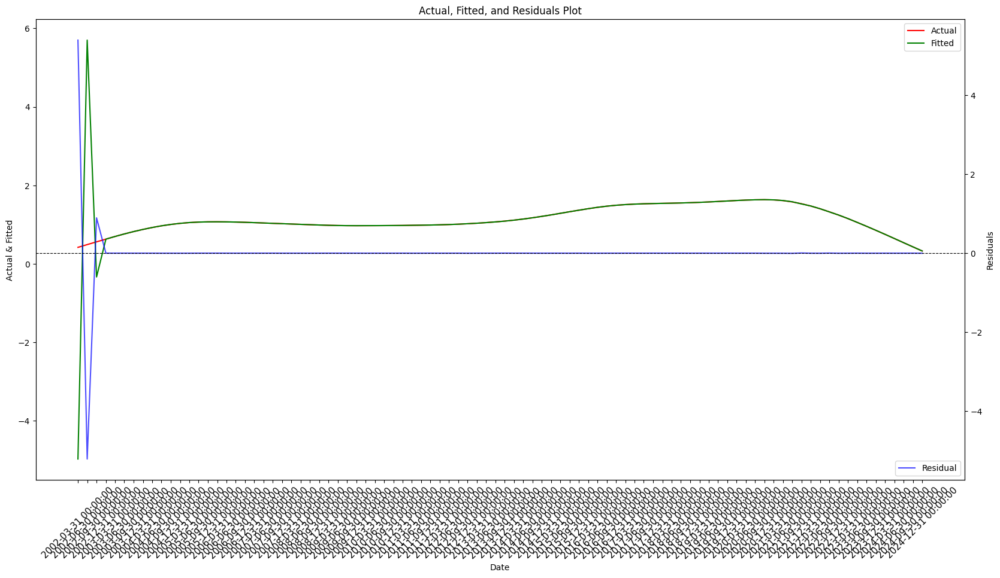

2 1 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(2, 1, 3)   Log Likelihood                 495.505
Date:                Tue, 04 Mar 2025   AIC                           -975.010
Time:                        04:50:34   BIC                           -955.283
Sample:                    03-31-2002   HQIC                          -967.066
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      0.034   -221.106      0.000      -7.505      -7.373
M_SA           1.9594      0.836      2.344      0.019       0.321       3.598
ar.L1          1.9127      0.061     31.414   

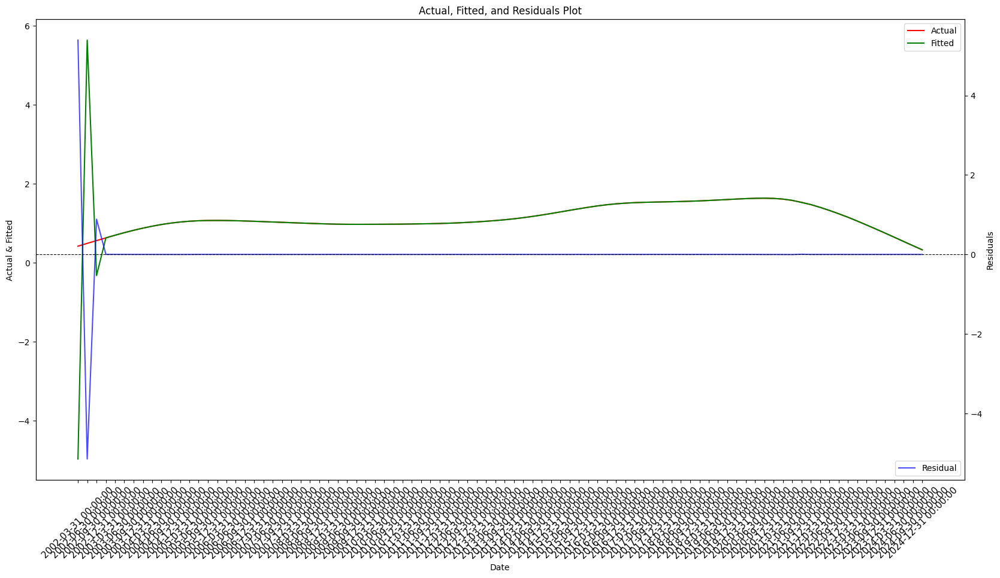

2 1 4
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(2, 1, 4)   Log Likelihood                 489.216
Date:                Tue, 04 Mar 2025   AIC                           -960.433
Time:                        04:50:35   BIC                           -938.343
Sample:                    03-31-2002   HQIC                          -951.543
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      0.035   -212.493      0.000      -7.507      -7.370
M_SA           1.9594      0.865      2.265      0.023       0.264       3.655
ar.L1          1.9081      0.087     22.019   

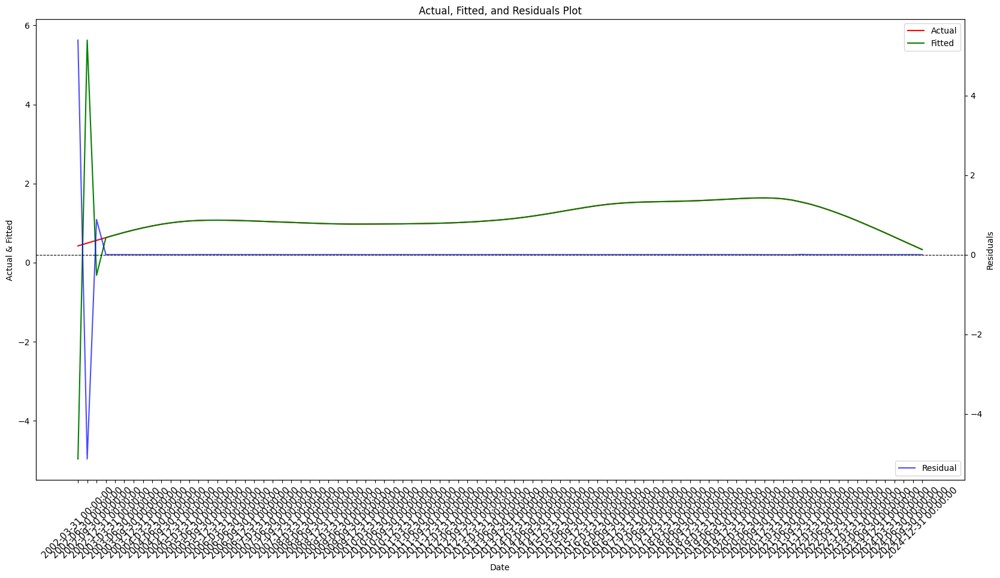

3 0 1
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 0, 1)   Log Likelihood                 426.331
Date:                Tue, 04 Mar 2025   AIC                           -838.661
Time:                        04:50:36   BIC                           -821.241
Sample:                    03-31-2002   HQIC                          -831.640
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.3635      0.115     -3.162      0.002      -0.589      -0.138
M_SA           1.4701      0.102     14.348      0.000       1.269       1.671
ar.L1          1.6080      0.677      2.376   

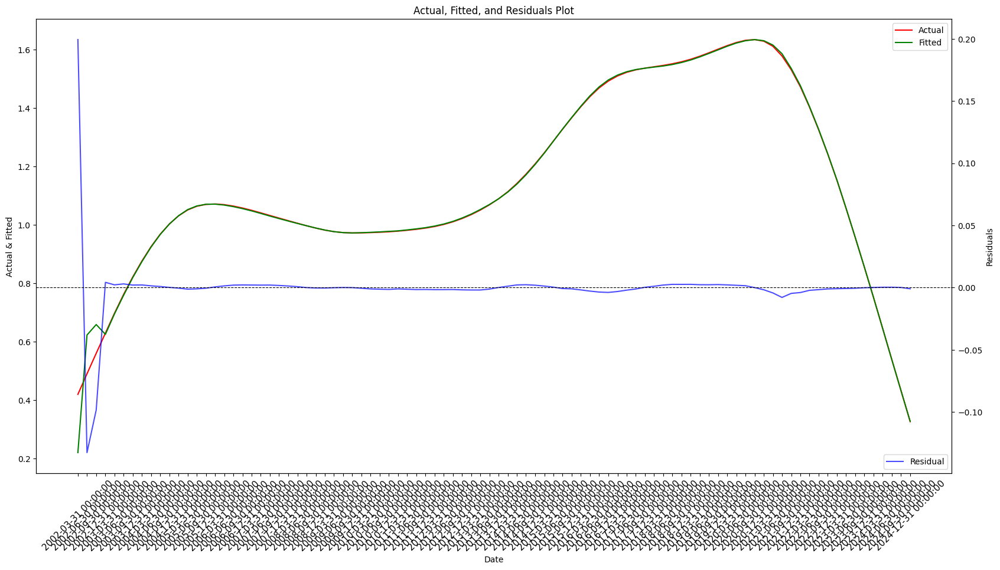

3 1 0
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 1, 0)   Log Likelihood                 497.363
Date:                Tue, 04 Mar 2025   AIC                           -982.725
Time:                        04:50:40   BIC                           -967.861
Sample:                    03-31-2002   HQIC                          -976.737
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      0.052   -142.865      0.000      -7.541      -7.337
M_SA           1.9594      0.870      2.252      0.024       0.254       3.665
ar.L1          2.6580      0.089     29.957   

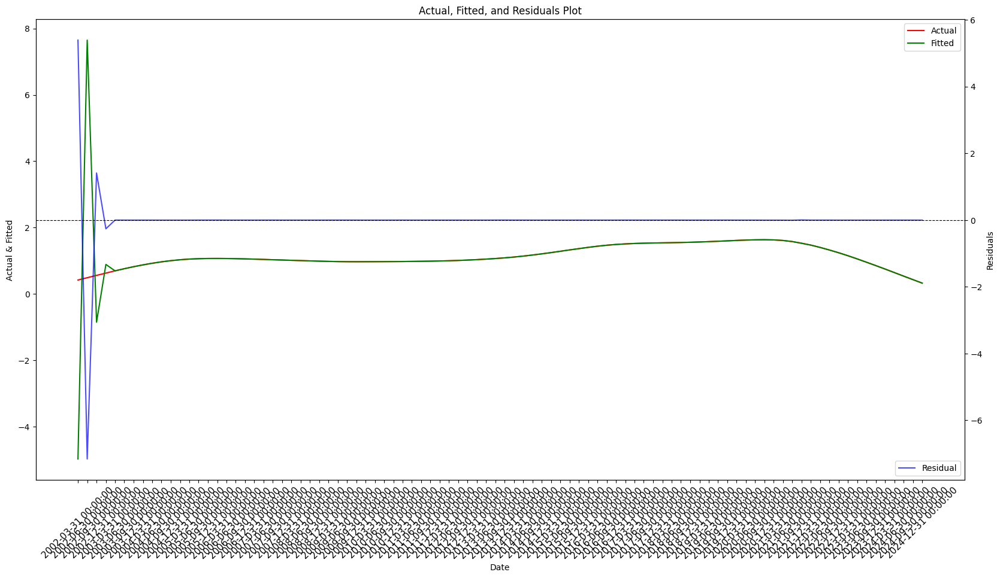

3 1 1
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 1, 1)   Log Likelihood                 481.984
Date:                Tue, 04 Mar 2025   AIC                           -949.968
Time:                        04:50:42   BIC                           -932.626
Sample:                    03-31-2002   HQIC                          -942.981
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      0.046   -160.792      0.000      -7.529      -7.348
M_SA           1.9594      0.395      4.964      0.000       1.186       2.733
ar.L1          1.4964      0.167      8.975   

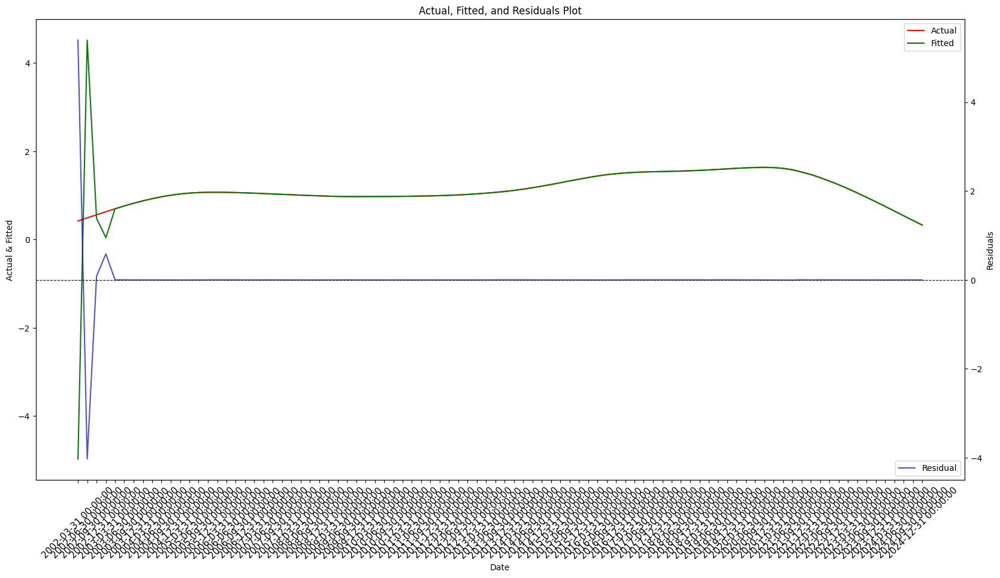

3 1 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 1, 2)   Log Likelihood                 497.858
Date:                Tue, 04 Mar 2025   AIC                           -979.716
Time:                        04:50:43   BIC                           -959.897
Sample:                    03-31-2002   HQIC                          -971.731
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      0.058   -128.908      0.000      -7.552      -7.326
M_SA           1.9594      0.846      2.316      0.021       0.301       3.618
ar.L1          2.3832      0.208     11.485   

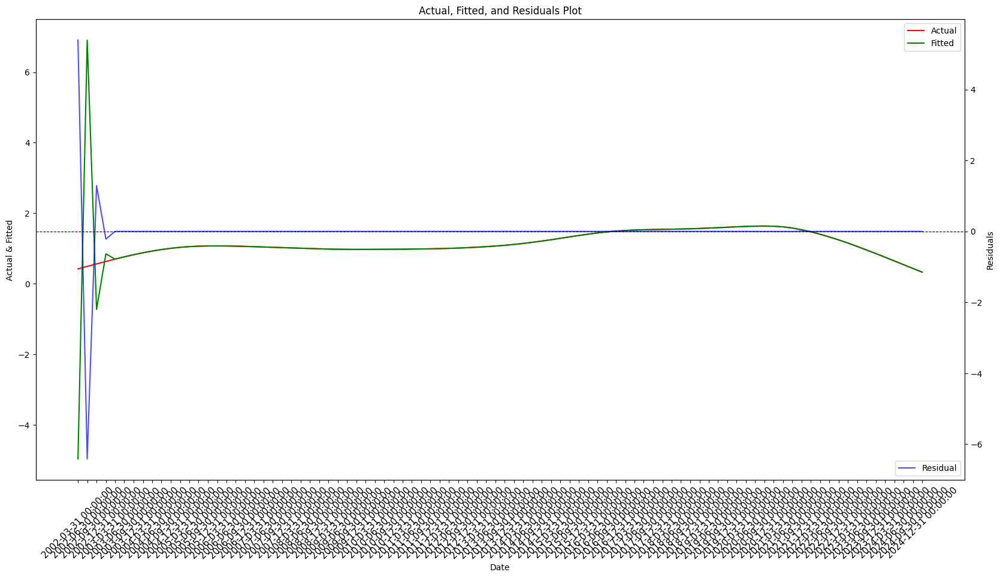

3 1 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 1, 3)   Log Likelihood                 494.345
Date:                Tue, 04 Mar 2025   AIC                           -970.691
Time:                        04:50:44   BIC                           -948.498
Sample:                    03-31-2002   HQIC                          -961.754
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      0.044   -167.746      0.000      -7.526      -7.352
M_SA           1.9594      1.010      1.940      0.052      -0.021       3.939
ar.L1          2.3302      0.019    123.705   

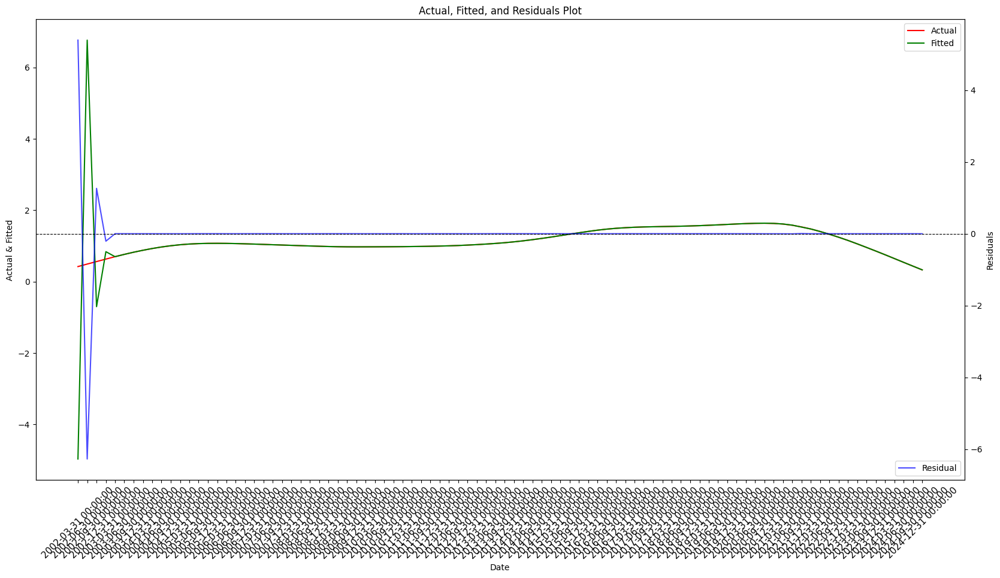

3 1 4
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 1, 4)   Log Likelihood                 489.755
Date:                Tue, 04 Mar 2025   AIC                           -959.509
Time:                        04:50:46   BIC                           -934.966
Sample:                    03-31-2002   HQIC                          -949.632
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      0.041   -183.294      0.000      -7.518      -7.359
M_SA           1.9594      0.899      2.180      0.029       0.198       3.721
ar.L1          2.8518      0.257     11.115   

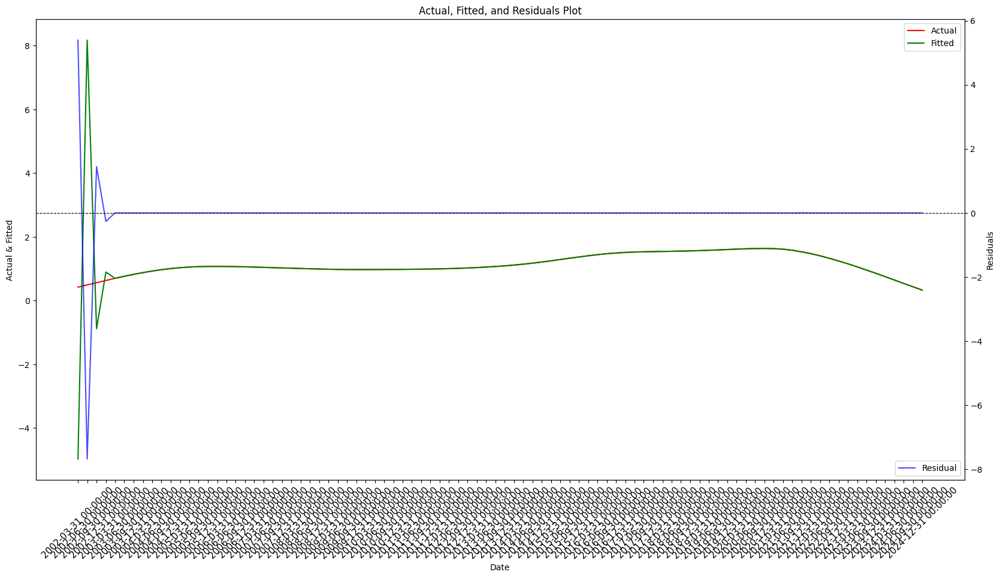

4 1 0
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(4, 1, 0)   Log Likelihood                 491.955
Date:                Tue, 04 Mar 2025   AIC                           -969.910
Time:                        04:50:49   BIC                           -952.648
Sample:                    03-31-2002   HQIC                          -962.959
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      0.058   -127.604      0.000      -7.553      -7.325
M_SA           1.9594      0.924      2.121      0.034       0.149       3.770
ar.L1          2.7439      0.087     31.362   

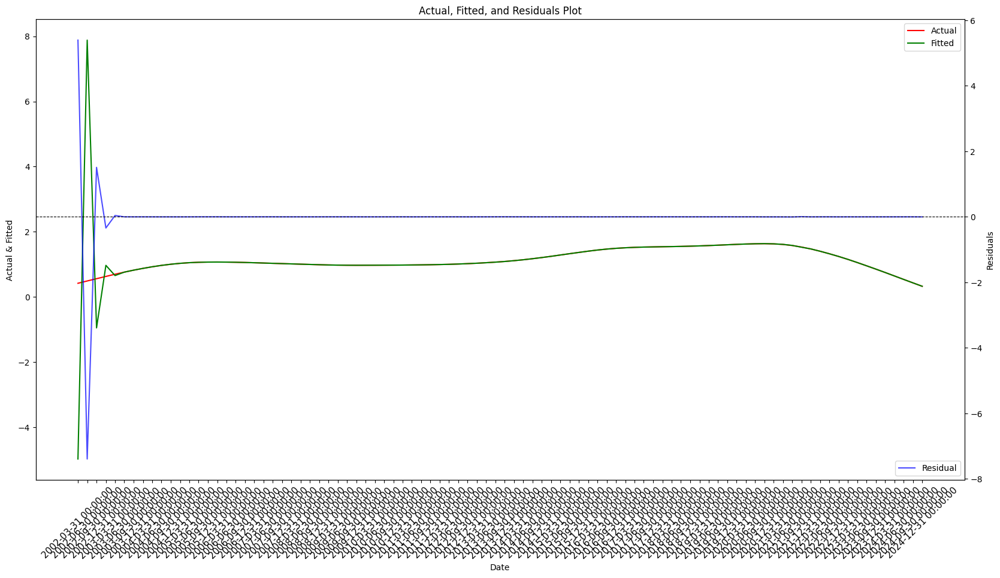

4 1 1
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(4, 1, 1)   Log Likelihood                 468.679
Date:                Tue, 04 Mar 2025   AIC                           -921.358
Time:                        04:50:50   BIC                           -901.631
Sample:                    03-31-2002   HQIC                          -913.415
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      0.110    -67.822      0.000      -7.654      -7.224
M_SA           1.9594      0.337      5.813      0.000       1.299       2.620
ar.L1          1.4359      0.396      3.623   

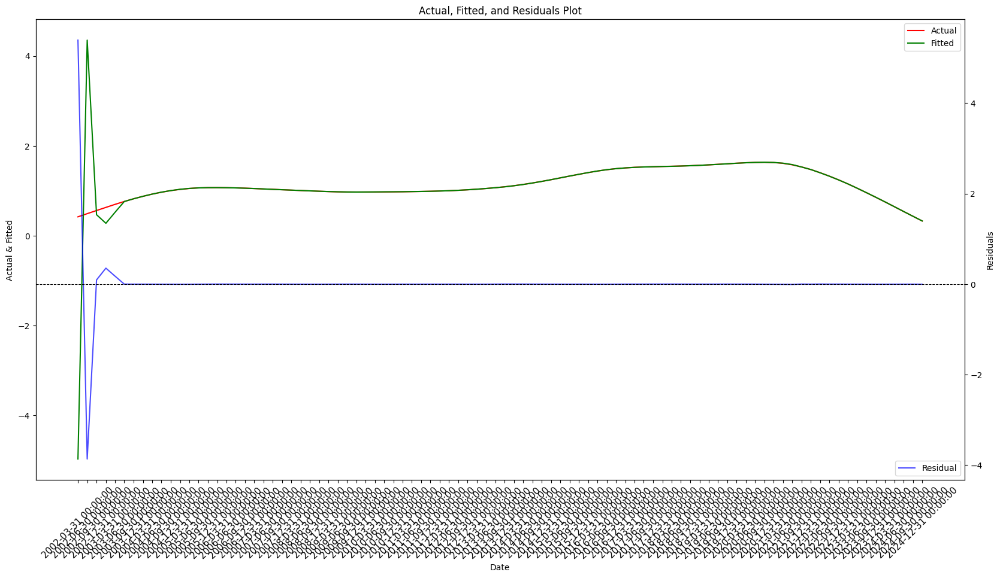

4 1 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(4, 1, 2)   Log Likelihood                 293.020
Date:                Tue, 04 Mar 2025   AIC                           -568.041
Time:                        04:50:51   BIC                           -545.847
Sample:                    03-31-2002   HQIC                          -559.104
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      0.166    -44.850      0.000      -7.764      -7.114
M_SA           1.9594      0.968      2.024      0.043       0.062       3.857
ar.L1         12.4946      0.307     40.731   

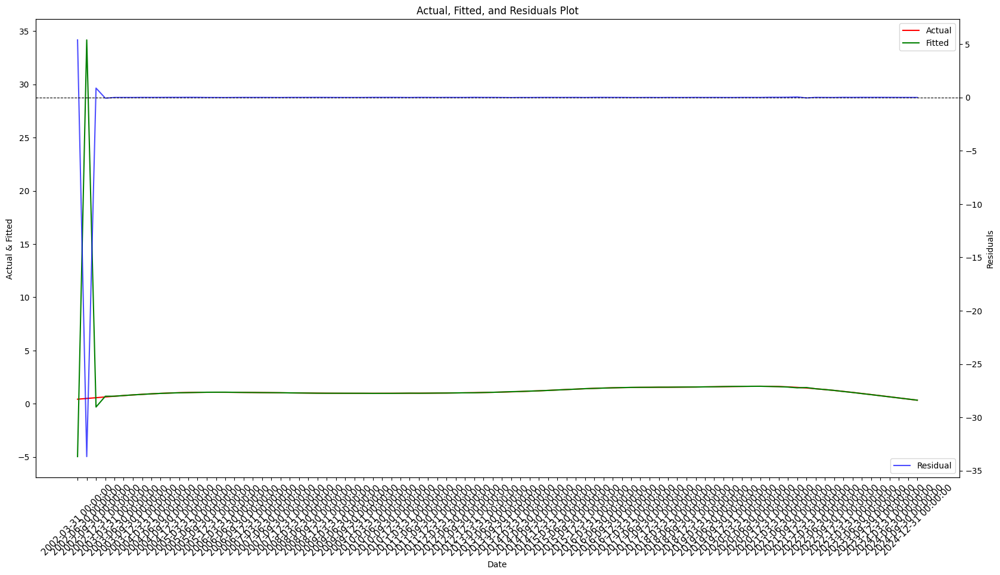

4 1 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(4, 1, 3)   Log Likelihood                 494.207
Date:                Tue, 04 Mar 2025   AIC                           -968.413
Time:                        04:50:53   BIC                           -943.754
Sample:                    03-31-2002   HQIC                          -958.484
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      0.043   -174.281      0.000      -7.522      -7.355
M_SA           1.9594      0.840      2.332      0.020       0.313       3.606
ar.L1          2.7709      0.154     18.022   

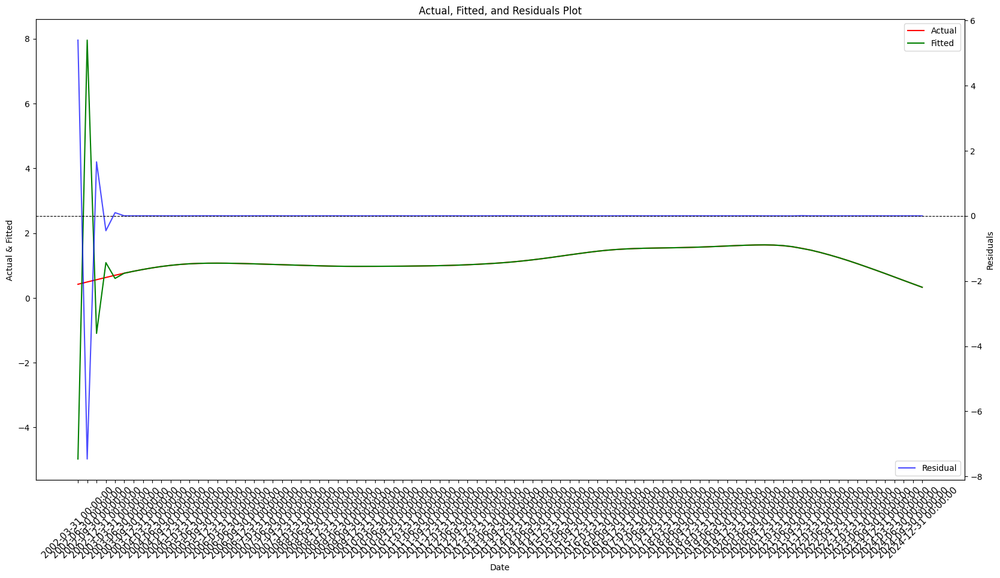

4 1 4
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(4, 1, 4)   Log Likelihood                 490.983
Date:                Tue, 04 Mar 2025   AIC                           -959.966
Time:                        04:50:55   BIC                           -932.968
Sample:                    03-31-2002   HQIC                          -949.101
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      0.029   -253.156      0.000      -7.496      -7.381
M_SA           1.9594      0.691      2.837      0.005       0.606       3.313
ar.L1          3.0007      0.046     65.086   

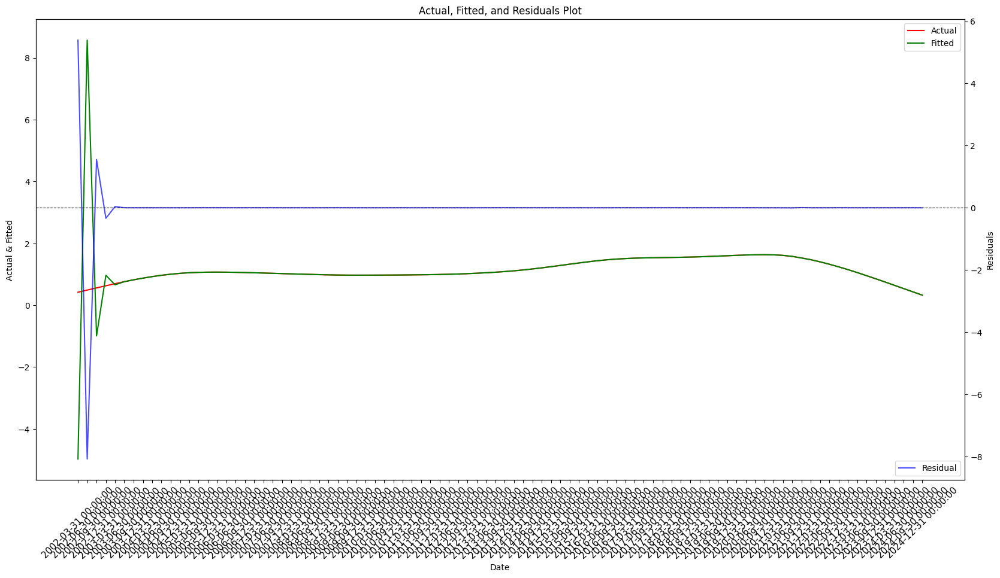

Лучшие параметры SARIMAX: (3, 1, 0)
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 1, 0)   Log Likelihood                 497.363
Date:                Tue, 04 Mar 2025   AIC                           -982.725
Time:                        04:50:56   BIC                           -967.861
Sample:                    03-31-2002   HQIC                          -976.737
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -7.4388      0.052   -142.865      0.000      -7.541      -7.337
M_SA           1.9594      0.870      2.252      0.024       0.254       3.665
ar.L1          2

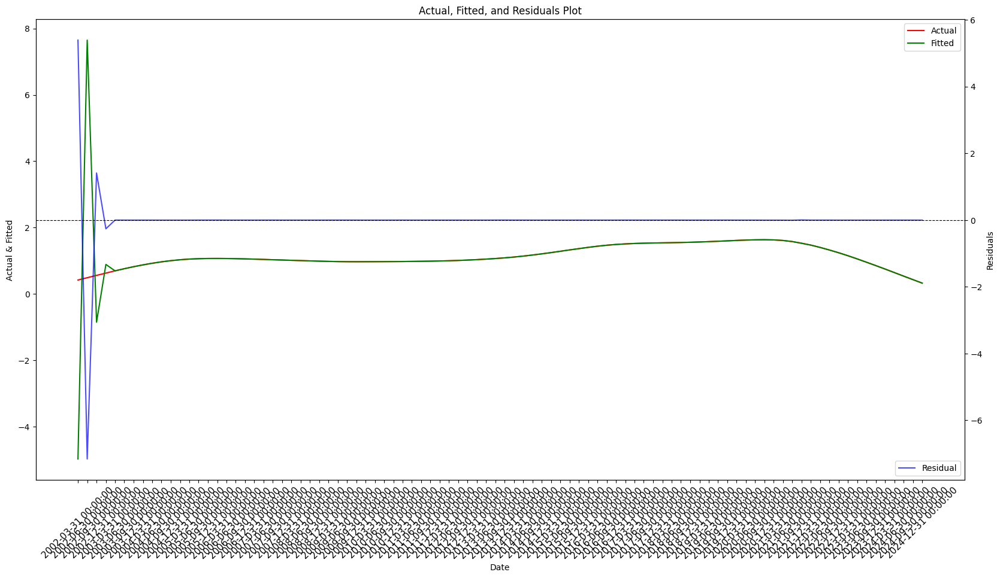

In [69]:
commodity_type = 'Scrap'
type_dct = {
    "date": df_transportation_volumes_indexed_adjusted[freq].index,
    "V_SA": df_transportation_volumes_indexed_adjusted[freq][commodity_type],   # Transport Volume Growth Index
    "EXP_T": df_transportation_tariff_indexed_adjusted[freq][commodity_type],   # Tariff growth index
    "M_SA": df_volumes_indexed_adjusted[freq][commodity_type],   # Production growth index
}

# Dummy-переменные
# dct_serial_data = construct_serial_data_by_type(commodity_type, df_volumes, dct_serial)
# for key, value in dct_serial_data.items():
#     type_dct[key] = value

df_type = pd.DataFrame(type_dct)

df_type.set_index('date', inplace=True)

# Целевая переменная и регрессоры
Y = df_type["V_SA"]
X = df_type.drop(columns=["V_SA"])  # Убираем целевую переменную
#X = sm.add_constant(X)
# Подбор оптимальных p, d, q
p_values = range(0, 5)
d_values = range(0, 2)
q_values = range(0, 5)

best_aic = float("inf")
best_order = None
best_model = None

for p, d, q in tqdm(itertools.product(p_values, d_values, q_values)):
    try:
        model = sm.tsa.statespace.SARIMAX(Y, exog=X, order=(p, d, q), seasonal_order=(0, 0, 0, 0),
                                          enforce_stationarity=False, enforce_invertibility=False)
        results = model.fit(disp=False)

        # Достаем коэффициент и p-value для "T"
        coef_T = results.params.get("EXP_T", None)
        pval_T = results.pvalues.get("EXP_T", None)

        # Условие: коэффициент при T должен быть отрицательным и значимым (p < 0.05)
        if coef_T is not None and coef_T < 0 and pval_T is not None and pval_T < 0.1:
            if results.aic < best_aic:
                best_aic = results.aic
                best_order = (p, d, q)
                best_model = results
            print(p, d, q)
            print(results.summary())
            plot_regression_results(results, df_type)

    except:
        continue

# Вывод результатов
if best_model:
    print(f"Лучшие параметры SARIMAX: {best_order}")
    print(best_model.summary())
    plot_regression_results(best_model, df_type)
else:
    print("Не удалось найти подходящую модель, удовлетворяющую условиям.")

### 🦏 Chem

**********************************************************************************
commodity type: Chem


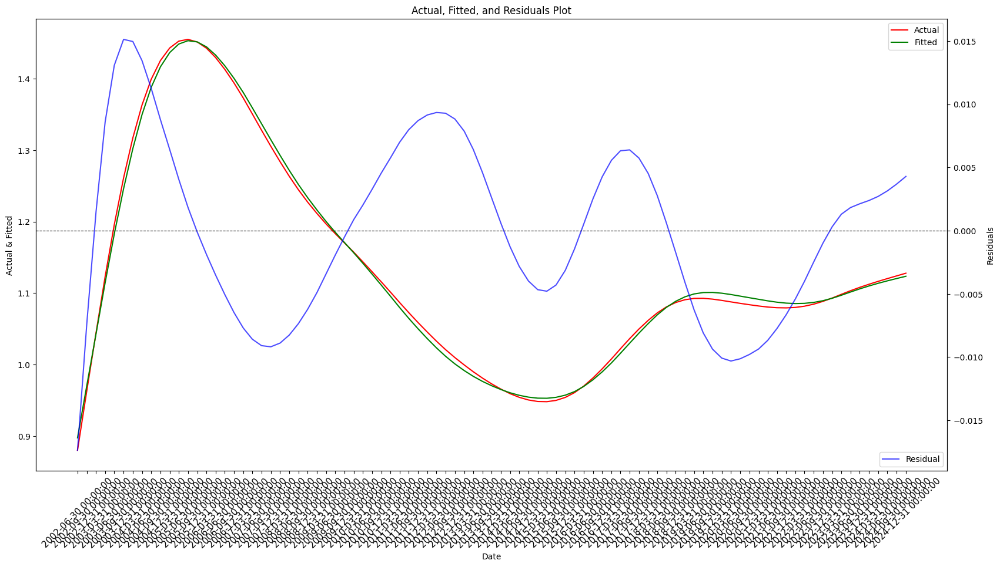

                            OLS Regression Results                            
Dep. Variable:                   V_SA   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                 1.343e+04
Date:                Tue, 04 Mar 2025   Prob (F-statistic):          7.46e-116
Time:                        04:50:58   Log-Likelihood:                 325.22
No. Observations:                  91   AIC:                            -642.4
Df Residuals:                      87   BIC:                            -632.4
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.2180      0.016     13.225      0.0

In [70]:
commodity_type = 'Chem'
type_dct = {
    "date": df_transportation_volumes_indexed_adjusted[freq].index,
    "V_SA": df_transportation_volumes_indexed_adjusted[freq][commodity_type],   # Transport Volume Growth Index
    "EXP_T": df_transportation_tariff_indexed_adjusted[freq][commodity_type],   # Tariff growth index
    "M_SA": df_volumes_indexed_adjusted[freq][commodity_type],   # Production growth index
}
# dummy variables
# dct_serial_data = construct_serial_data_by_type(commodity_type, df_volumes, dct_serial)
# for key, value in dct_serial_data.items():
#   type_dct[key] = value

df_type = pd.DataFrame(type_dct)

df_type["V_SA(-1)"] = df_type["V_SA"].shift(1)

df_type = df_type.dropna()

Y = df_type["V_SA"]
lst_data = [i for i in df_type.columns if i != 'V_SA' and i != 'date']
X = df_type[[i for i in df_type.columns if i in lst_data]]
df_type.set_index('date', inplace=True)
# Adding a constant for regression
X = sm.add_constant(X)

# Make regression
model = sm.OLS(Y, X).fit()

print("**********************************************************************************")
print("commodity type:", commodity_type)

# correlation_matrix = df_type.corr()
# print(correlation_matrix)
# Print results
plot_regression_results(model, df_type)
print(model.summary())

🐰 Sarimax models

In [71]:
# Исходные данные
commodity_type = 'Chem'
type_dct = {
    "date": df_transportation_volumes_indexed_adjusted[freq].index,
    "V_SA": df_transportation_volumes_indexed_adjusted[freq][commodity_type],   # Transport Volume Growth Index
    "EXP_T": df_transportation_tariff_indexed_adjusted[freq][commodity_type],   # Tariff growth index
    "M_SA": df_volumes_indexed_adjusted[freq][commodity_type],   # Production growth index
}

# Dummy-переменные
# dct_serial_data = construct_serial_data_by_type(commodity_type, df_volumes, dct_serial)
# for key, value in dct_serial_data.items():
#     type_dct[key] = value

df_type = pd.DataFrame(type_dct)

df_type.set_index('date', inplace=True)

# Целевая переменная и регрессоры
Y = df_type["V_SA"]
X = df_type.drop(columns=["V_SA"])  # Убираем целевую переменную

# Подбор оптимальных p, d, q
p_values = range(0, 5)
d_values = range(0, 2)
q_values = range(0, 5)

best_aic = float("inf")
best_order = None
best_model = None

for p, d, q in tqdm(itertools.product(p_values, d_values, q_values)):
    try:
        model = sm.tsa.statespace.SARIMAX(Y, exog=X, order=(p, d, q), seasonal_order=(0, 0, 0, 0),
                                          enforce_stationarity=False, enforce_invertibility=False)
        results = model.fit(disp=False)

        # Достаем коэффициент и p-value для "T"
        coef_T = results.params.get("EXP_T", None)
        pval_T = results.pvalues.get("EXP_T", None)

        # Условие: коэффициент при T должен быть отрицательным и значимым (p < 0.05)
        if coef_T is not None and coef_T < 0 and pval_T is not None and pval_T < 0.05:
            if results.aic < best_aic:
                best_aic = results.aic
                best_order = (p, d, q)
                best_model = results
            print(p, d, q)
            print(results.summary())
            plot_regression_results(results, df_type)

    except:
        continue

# Вывод результатов
if best_model:
    print(f"Лучшие параметры SARIMAX: {best_order}")
    print(best_model.summary())
    plot_regression_results(best_model, df_type)
else:
    print("Не удалось найти подходящую модель, удовлетворяющую условиям.")

0it [00:00, ?it/s]

Не удалось найти подходящую модель, удовлетворяющую условиям.


In [72]:
commodity_type = 'Chem'
type_dct = {
    "date": df_transportation_volumes_indexed_adjusted[freq].index,
    "V_SA": df_transportation_volumes_indexed_adjusted[freq][commodity_type],   # Transport Volume Growth Index
    "EXP_T": df_transportation_tariff_indexed_adjusted[freq][commodity_type],   # Tariff growth index
    "M_SA": df_volumes_indexed_adjusted[freq][commodity_type],   # Production growth index
}

# Добавляем dummy-переменные
# dct_serial_data = construct_serial_data_by_type(commodity_type, df_volumes, dct_serial)
# for key, value in dct_serial_data.items():
#     type_dct[key] = value

df_type = pd.DataFrame(type_dct)

# Добавляем лаг переменной Y
df_type["V_SA(-1)"] = df_type["V_SA"].shift(1)

# Удаляем строки с пропущенными значениями
df_type = df_type.dropna()

# Определяем зависимую переменную
Y = df_type["V_SA"]

# Обязательные переменные
mandatory_features = ["EXP_T", "V_SA(-1)"]

# Все возможные дополнительные переменные (кроме "Y" и "date")
optional_features = [col for col in df_type.columns if col not in ["V_SA", "date"] and col not in mandatory_features]

best_model = None
best_adj_r2 = -np.inf  # Максимизируем скорректированный R²
best_features = None

# Перебираем все возможные комбинации дополнительных признаков
for r in tqdm(range(len(optional_features) + 1)):  # От 0 до всех возможных переменных
    for subset in itertools.combinations(optional_features, r):
        selected_features = list(mandatory_features) + list(subset)
        X = df_type[selected_features]
        # X = sm.add_constant(X)
        # Строим регрессию
        model = sm.OLS(Y, X).fit()

        # Проверяем условия
        #if model.pvalues["EXP_T"] < 0.1 and model.pvalues["V_SA(-1)"] < 0.1 and model.params["EXP_T"] < 0:
        if model.pvalues["EXP_T"] < 0.4 and model.params["EXP_T"] < 0:
            best_model = model
            best_features = selected_features
            flag = True
            print(model.summary())
            # Выбираем модель с наибольшим скорректированным R²
            if model.rsquared_adj > best_adj_r2:
                best_model = model
                best_adj_r2 = model.rsquared_adj
                best_features = selected_features
# Выводим результаты лучшей модели
if best_model:
    print("Лучшая модель:")
    print(f"Выбранные переменные: {best_features}")
    print(best_model.summary())
    plot_regression_results(best_model, df_type)
else:
    print("Не найдено моделей, удовлетворяющих условиям.")

  0%|          | 0/2 [00:00<?, ?it/s]

Не найдено моделей, удовлетворяющих условиям.


### 🐕 Fert

    Feature          VIF
0      V_SA  8300.628155
1     EXP_T   100.690522
2      M_SA   566.563921
3  V_SA(-1)  5677.816031
**********************************************************************************
commodity type: Fert


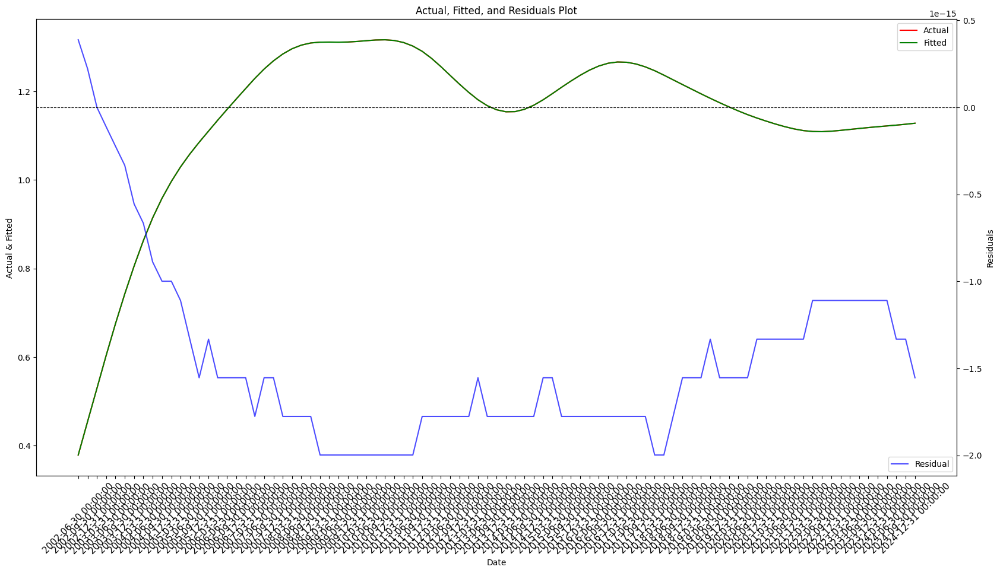

                                 OLS Regression Results                                
Dep. Variable:                   V_SA   R-squared (uncentered):                   1.000
Model:                            OLS   Adj. R-squared (uncentered):              1.000
Method:                 Least Squares   F-statistic:                          1.210e+31
Date:                Tue, 04 Mar 2025   Prob (F-statistic):                        0.00
Time:                        04:51:11   Log-Likelihood:                          2973.8
No. Observations:                  91   AIC:                                     -5940.
Df Residuals:                      87   BIC:                                     -5930.
Df Model:                           4                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

In [73]:
commodity_type = 'Fert'
type_dct = {
    "date": df_transportation_volumes_indexed_adjusted[freq].index,
    "V_SA": df_transportation_volumes_indexed_adjusted[freq][commodity_type],   # Transport Volume Growth Index
    "EXP_T": df_transportation_tariff_indexed_adjusted[freq][commodity_type],   # Tariff growth index
    "M_SA": df_volumes_indexed_adjusted[freq][commodity_type],   # Production growth index
}
# dummy variables
# dct_serial_data = construct_serial_data_by_type(commodity_type, df_volumes, dct_serial)
# for key, value in dct_serial_data.items():
#   type_dct[key] = value

df_type = pd.DataFrame(type_dct)

df_type["V_SA(-1)"] = df_type["V_SA"].shift(1)

df_type = df_type.dropna()

Y = df_type["V_SA"]
lst_data = [i for i in df_type.columns if i != 'Y' and i != 'date']
X = df_type[[i for i in df_type.columns if i in lst_data]]


# Вычисляем VIF для каждой переменной в X
X_vif = X.copy()  # X — это твоя матрица признаков без Y и даты
vif_data = pd.DataFrame()
vif_data["Feature"] = X_vif.columns
vif_data["VIF"] = [variance_inflation_factor(X_vif.values, i) for i in range(len(X_vif.columns))]

print(vif_data)

df_type.set_index('date', inplace=True)
# Adding a constant for regression
#X = sm.add_constant(X)

# Make regression
model = sm.OLS(Y, X).fit()

print("**********************************************************************************")
print("commodity type:", commodity_type)

# Print results
plot_regression_results(model, df_type)
print(model.summary())

In [74]:
commodity_type = 'Fert'
type_dct = {
    "date": df_transportation_volumes_indexed_adjusted[freq].index,
    "V_SA": df_transportation_volumes_indexed_adjusted[freq][commodity_type],   # Transport Volume Growth Index
    "EXP_T": df_transportation_tariff_indexed_adjusted[freq][commodity_type],   # Tariff growth index
    "M_SA": df_volumes_indexed_adjusted[freq][commodity_type],   # Production growth index
}

# Dummy-переменные
# dct_serial_data = construct_serial_data_by_type(commodity_type, df_volumes, dct_serial)
# for key, value in dct_serial_data.items():
#     type_dct[key] = value

df_type = pd.DataFrame(type_dct)

df_type["V_SA(-1)"] = df_type["V_SA"].shift(1)
df_type = df_type.dropna()
df_type.set_index('date', inplace=True)

# Целевая переменная и регрессоры
Y = df_type["V_SA"]
X = df_type.drop(columns=["V_SA"])  # Убираем целевую переменную

# Подбор оптимальных p, d, q
p_values = range(0, 5)
d_values = range(0, 2)
q_values = range(0, 5)

best_aic = float("inf")
best_order = None
best_model = None

for p, d, q in tqdm(itertools.product(p_values, d_values, q_values)):
    try:
        model = sm.tsa.statespace.SARIMAX(Y, exog=X, order=(p, d, q), seasonal_order=(0, 0, 0, 0),
                                          enforce_stationarity=False, enforce_invertibility=False)
        results = model.fit(disp=False)

        # Достаем коэффициент и p-value для "T"
        coef_T = results.params.get("T", None)
        pval_T = results.pvalues.get("T", None)

        # Условие: коэффициент при T должен быть отрицательным и значимым (p < 0.05)
        if coef_T is not None and coef_T < 0 and pval_T is not None and pval_T < 0.05:
            if results.aic < best_aic:
                best_aic = results.aic
                best_order = (p, d, q)
                best_model = results

    except:
        continue

# Вывод результатов
if best_model:
    print(f"Лучшие параметры SARIMAX: {best_order}")
    print(best_model.summary())
    plot_regression_results(best_model, df_type)
else:
    print("Не удалось найти подходящую модель, удовлетворяющую условиям.")

0it [00:00, ?it/s]

Не удалось найти подходящую модель, удовлетворяющую условиям.


### 🐳 nFerr

    Feature           VIF
0      V_SA  13185.524090
1     EXP_T    329.372624
2      M_SA   7997.052202
3  V_SA(-1)  13042.281181
**********************************************************************************
commodity type: nFerr


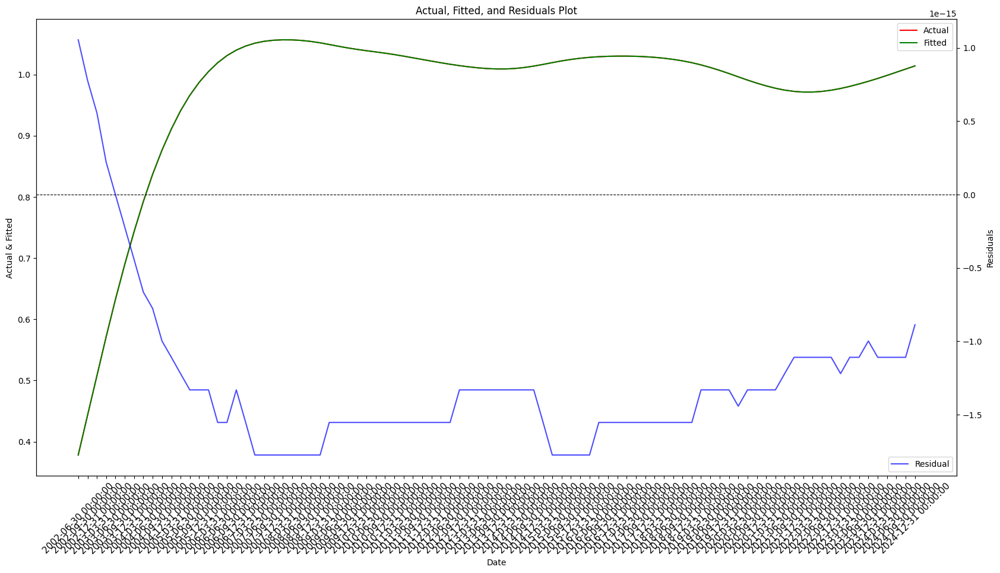

                                 OLS Regression Results                                
Dep. Variable:                   V_SA   R-squared (uncentered):                   1.000
Model:                            OLS   Adj. R-squared (uncentered):              1.000
Method:                 Least Squares   F-statistic:                          1.086e+31
Date:                Tue, 04 Mar 2025   Prob (F-statistic):                        0.00
Time:                        04:58:53   Log-Likelihood:                          2983.9
No. Observations:                  91   AIC:                                     -5960.
Df Residuals:                      87   BIC:                                     -5950.
Df Model:                           4                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

In [76]:
commodity_type = 'nFerr'
type_dct = {
    "date": df_transportation_volumes_indexed_adjusted[freq].index,
    "V_SA": df_transportation_volumes_indexed_adjusted[freq][commodity_type],   # Transport Volume Growth Index
    "EXP_T": df_transportation_tariff_indexed_adjusted[freq][commodity_type],   # Tariff growth index
    "M_SA": df_volumes_indexed_adjusted[freq][commodity_type],   # Production growth index
}
# dummy variables
# dct_serial_data = construct_serial_data_by_type(commodity_type, df_volumes, dct_serial)
# for key, value in dct_serial_data.items():
#   type_dct[key] = value

df_type = pd.DataFrame(type_dct)

df_type["V_SA(-1)"] = df_type["V_SA"].shift(1)

df_type = df_type.dropna()

Y = df_type["V_SA"]
lst_data = [i for i in df_type.columns if i != 'Y' and i != 'date']
X = df_type[[i for i in df_type.columns if i in lst_data]]


# Вычисляем VIF для каждой переменной в X
X_vif = X.copy()  # X — это твоя матрица признаков без Y и даты
vif_data = pd.DataFrame()
vif_data["Feature"] = X_vif.columns
vif_data["VIF"] = [variance_inflation_factor(X_vif.values, i) for i in range(len(X_vif.columns))]

print(vif_data)

df_type.set_index('date', inplace=True)
# Adding a constant for regression
#X = sm.add_constant(X)

# Make regression
model = sm.OLS(Y, X).fit()

print("**********************************************************************************")
print("commodity type:", commodity_type)

# Print results
plot_regression_results(model, df_type)
print(model.summary())

0it [00:00, ?it/s]

0 1 0
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(0, 1, 0)   Log Likelihood                 421.114
Date:                Tue, 04 Mar 2025   AIC                           -836.227
Time:                        04:59:31   BIC                           -828.728
Sample:                    03-31-2002   HQIC                          -833.203
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569      0.060     -2.613      0.009      -0.275      -0.039
M_SA           1.0494      0.049     21.207      0.000       0.952       1.146
sigma2      5.031e-06   9.04e-07      5.567   

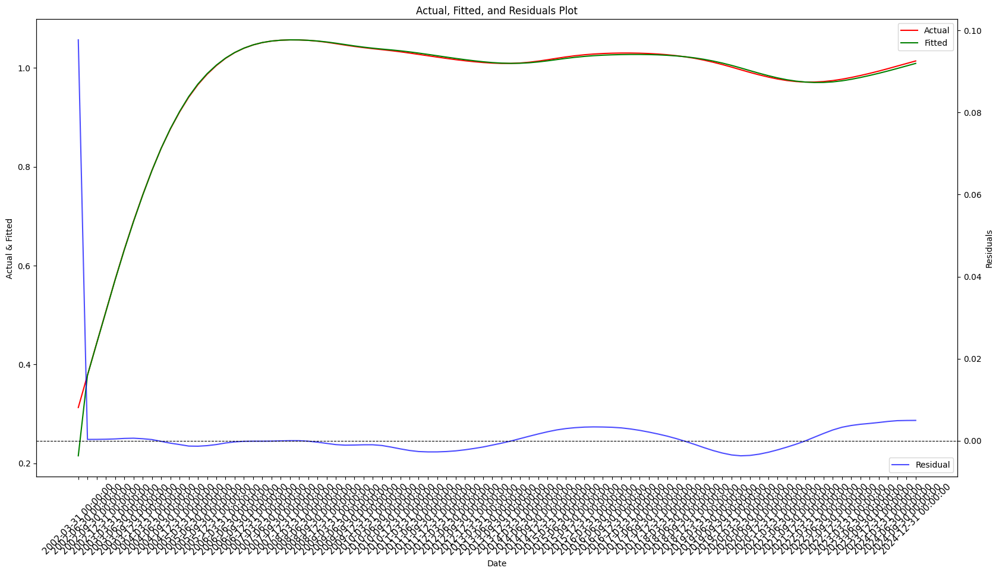

0 1 1
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(0, 1, 1)   Log Likelihood                 456.393
Date:                Tue, 04 Mar 2025   AIC                           -904.787
Time:                        04:59:32   BIC                           -894.832
Sample:                    03-31-2002   HQIC                          -900.774
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569      0.062     -2.530      0.011      -0.278      -0.035
M_SA           1.0494      0.052     20.011      0.000       0.947       1.152
ma.L1          1.6718      0.486      3.440   

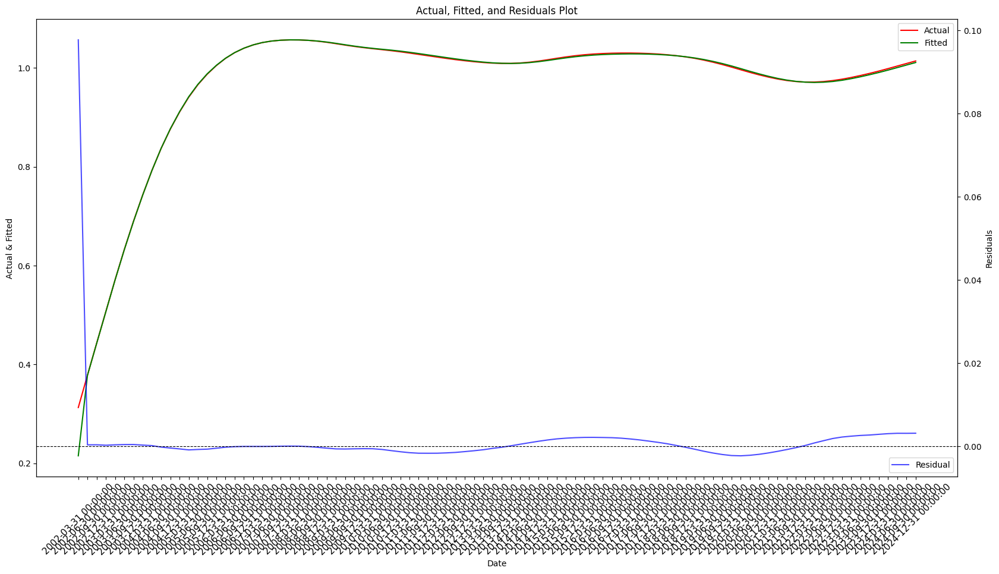

0 1 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(0, 1, 2)   Log Likelihood                 454.419
Date:                Tue, 04 Mar 2025   AIC                           -898.838
Time:                        04:59:33   BIC                           -886.451
Sample:                    03-31-2002   HQIC                          -893.848
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569      0.063     -2.486      0.013      -0.281      -0.033
M_SA           1.0494      0.055     19.052      0.000       0.941       1.157
ma.L1          1.3766      0.434      3.171   

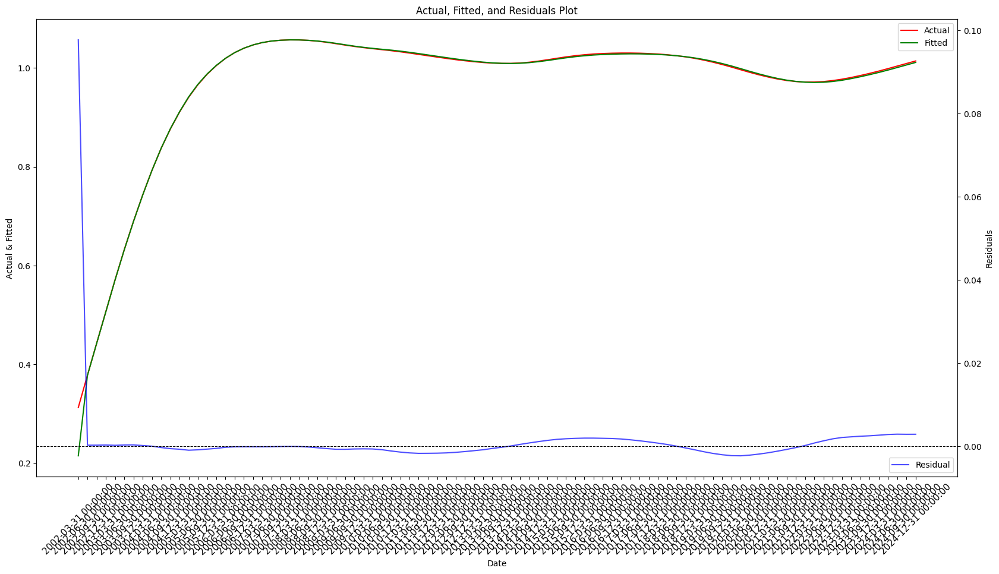

0 1 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(0, 1, 3)   Log Likelihood                 426.493
Date:                Tue, 04 Mar 2025   AIC                           -840.985
Time:                        04:59:35   BIC                           -826.190
Sample:                    03-31-2002   HQIC                          -835.027
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569      0.063     -2.509      0.012      -0.280      -0.034
M_SA           1.0494      0.054     19.396      0.000       0.943       1.155
ma.L1         -1.3457      0.000  -4614.294   

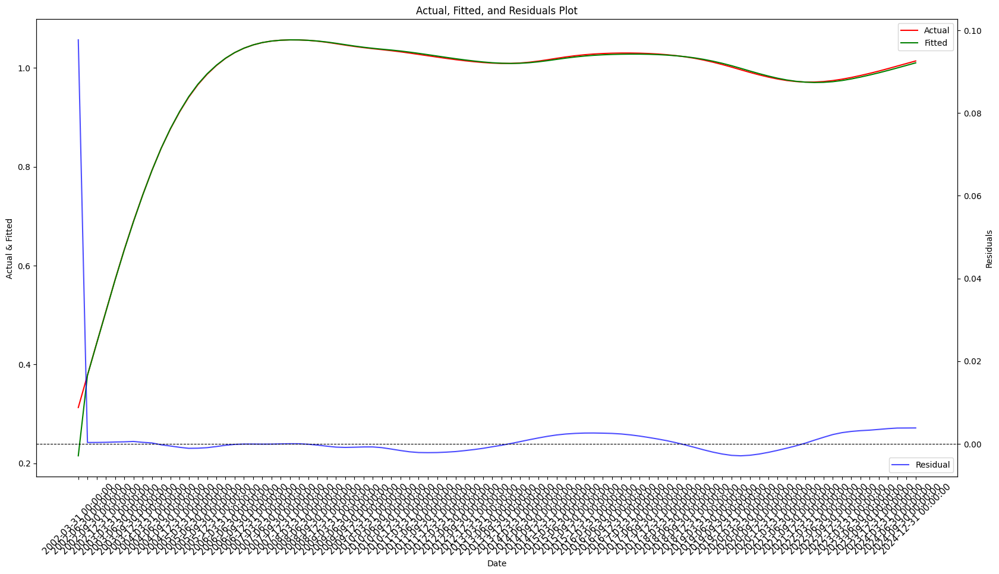

0 1 4
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(0, 1, 4)   Log Likelihood                 443.761
Date:                Tue, 04 Mar 2025   AIC                           -873.522
Time:                        04:59:36   BIC                           -856.342
Sample:                    03-31-2002   HQIC                          -866.608
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569      0.062     -2.536      0.011      -0.278      -0.036
M_SA           1.0494      0.061     17.181      0.000       0.930       1.169
ma.L1         -1.5471      0.000  -3565.426   

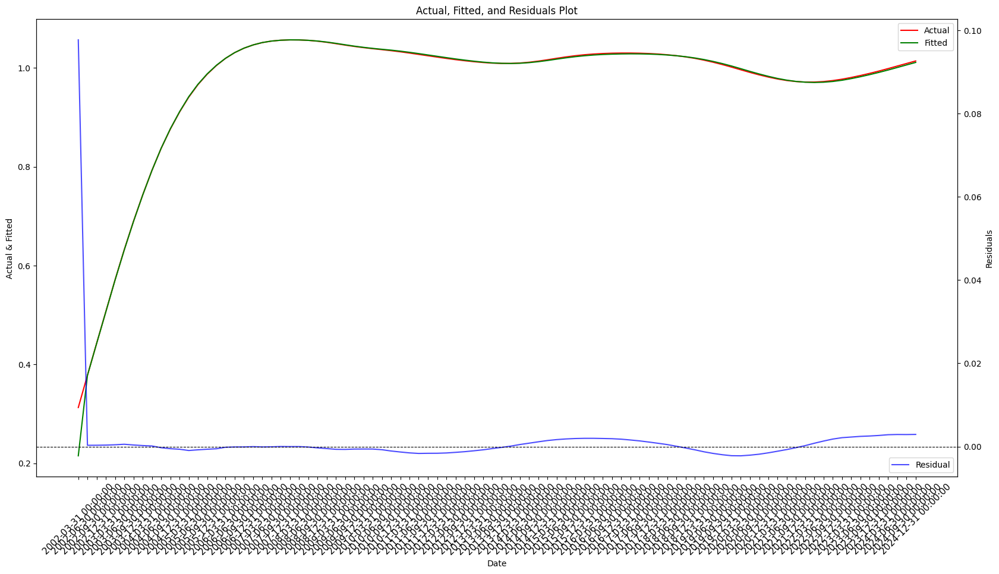

1 0 0
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(1, 0, 0)   Log Likelihood                 426.841
Date:                Tue, 04 Mar 2025   AIC                           -845.683
Time:                        04:59:37   BIC                           -835.639
Sample:                    03-31-2002   HQIC                          -841.631
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1835      0.069     -2.660      0.008      -0.319      -0.048
M_SA           1.0468      0.043     24.548      0.000       0.963       1.130
ar.L1          1.0026      0.002    415.836   

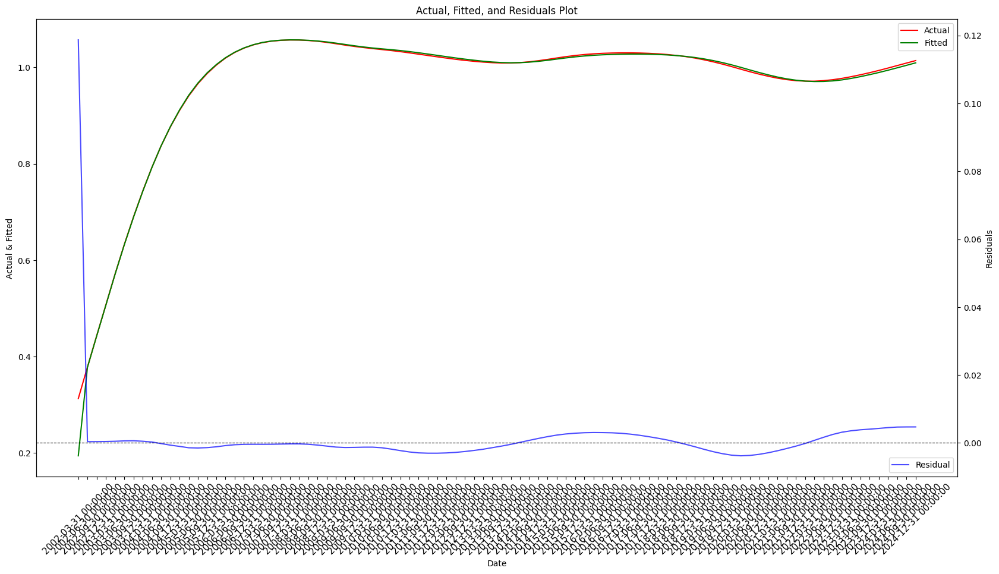

1 1 1
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(1, 1, 1)   Log Likelihood                 612.304
Date:                Tue, 04 Mar 2025   AIC                          -1214.607
Time:                        04:59:39   BIC                          -1202.164
Sample:                    03-31-2002   HQIC                         -1209.592
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569      0.005    -31.062      0.000      -0.167      -0.147
M_SA           1.0494      0.032     32.682      0.000       0.986       1.112
ar.L1          1.0117      0.025     40.941   

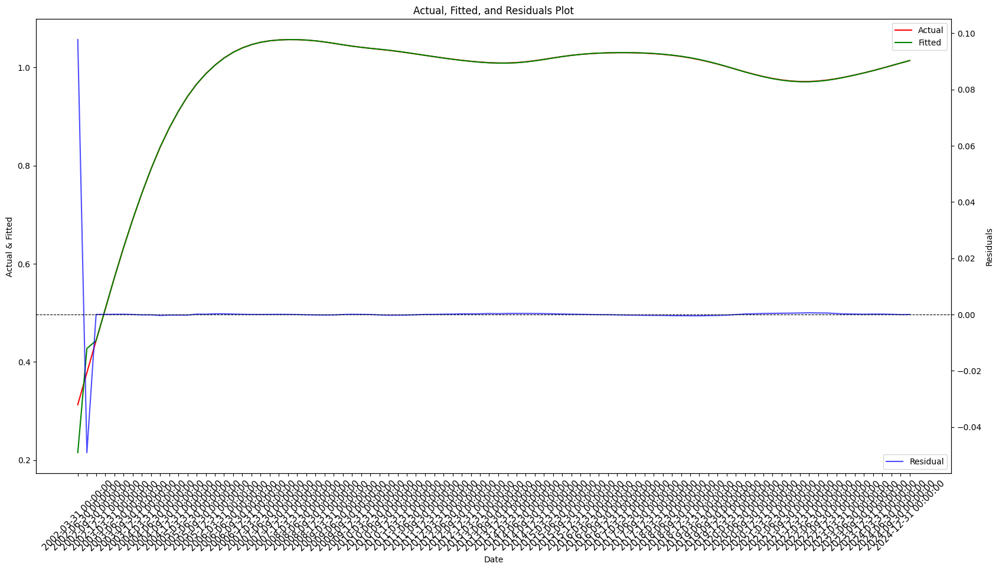

1 1 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(1, 1, 2)   Log Likelihood                 634.238
Date:                Tue, 04 Mar 2025   AIC                          -1256.477
Time:                        04:59:40   BIC                          -1241.613
Sample:                    03-31-2002   HQIC                         -1250.488
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569      0.005    -32.860      0.000      -0.166      -0.148
M_SA           1.0494      0.030     35.427      0.000       0.991       1.107
ar.L1          1.0093      0.026     39.003   

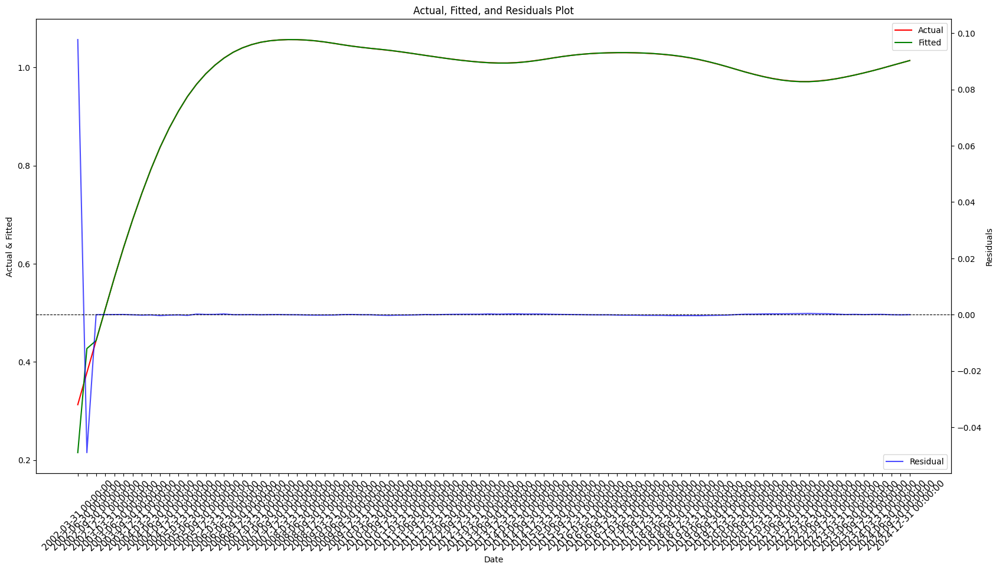

1 1 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(1, 1, 3)   Log Likelihood                 639.661
Date:                Tue, 04 Mar 2025   AIC                          -1265.321
Time:                        04:59:42   BIC                          -1248.060
Sample:                    03-31-2002   HQIC                         -1258.371
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569      0.006    -28.253      0.000      -0.168      -0.146
M_SA           1.0494      0.036     28.966      0.000       0.978       1.120
ar.L1          1.0089      0.030     33.509   

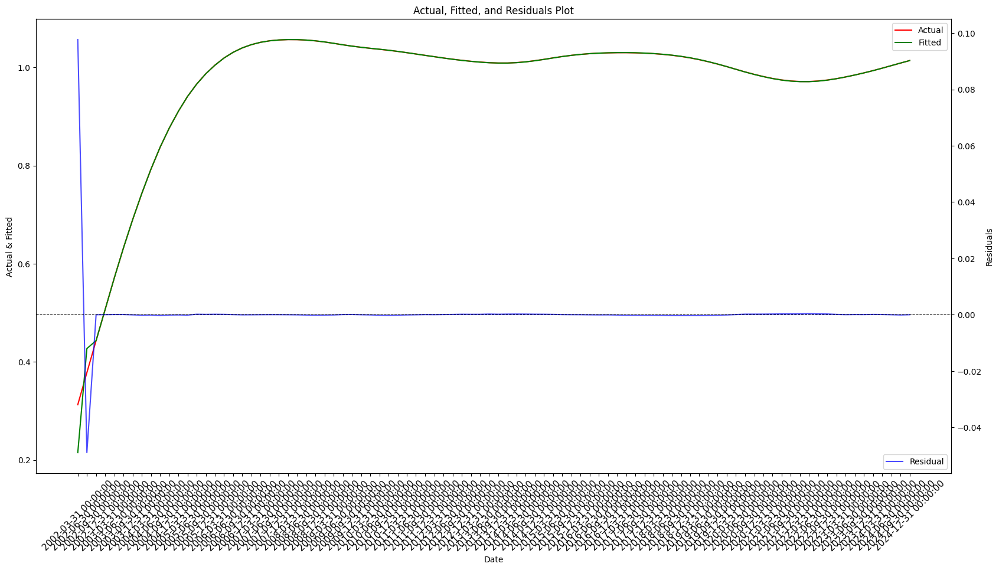

1 1 4
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(1, 1, 4)   Log Likelihood                 663.827
Date:                Tue, 04 Mar 2025   AIC                          -1311.654
Time:                        04:59:43   BIC                          -1292.019
Sample:                    03-31-2002   HQIC                         -1303.752
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569    8.2e-19  -1.91e+17      0.000      -0.157      -0.157
M_SA           1.0494   1.12e-18   9.35e+17      0.000       1.049       1.049
ar.L1          1.0068   1.65e-19    6.1e+18   

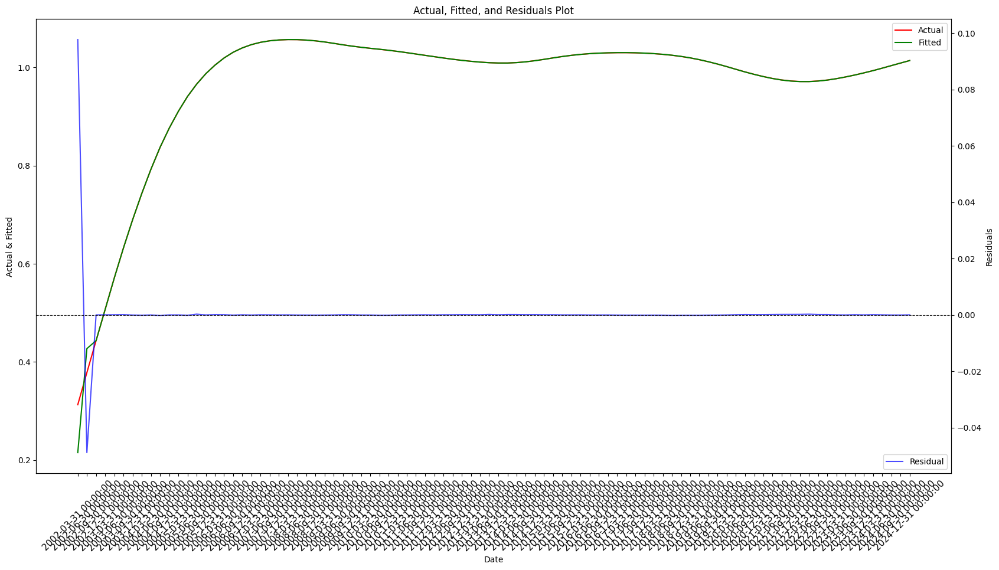

2 0 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(2, 0, 3)   Log Likelihood                 704.744
Date:                Tue, 04 Mar 2025   AIC                          -1393.489
Time:                        04:59:45   BIC                          -1373.670
Sample:                    03-31-2002   HQIC                         -1385.504
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.0039      0.001     -6.159      0.000      -0.005      -0.003
M_SA           1.0079      0.001   1413.892      0.000       1.006       1.009
ar.L1          1.9835      0.001   1421.423   

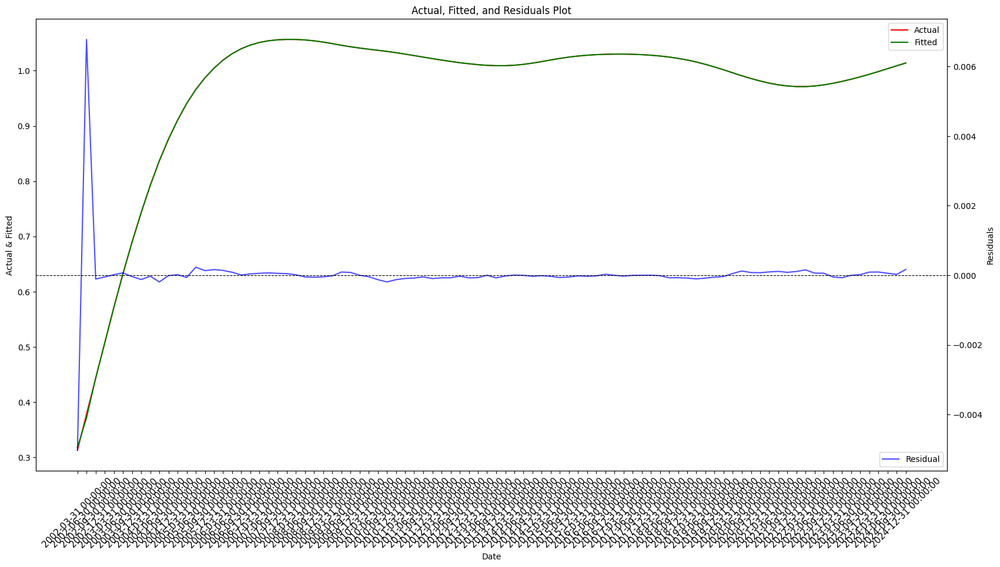

2 0 4
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(2, 0, 4)   Log Likelihood                 695.134
Date:                Tue, 04 Mar 2025   AIC                          -1372.268
Time:                        04:59:47   BIC                          -1350.075
Sample:                    03-31-2002   HQIC                         -1363.332
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.0044      0.001     -3.952      0.000      -0.007      -0.002
M_SA           1.0074      0.001    782.576      0.000       1.005       1.010
ar.L1          1.9874      0.003    785.119   

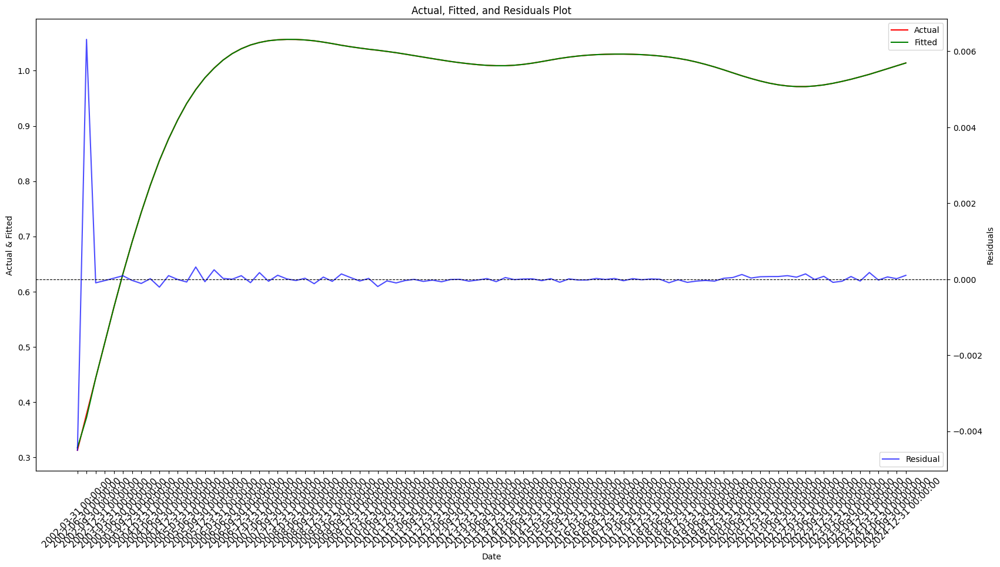

2 1 0
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(2, 1, 0)   Log Likelihood                 704.311
Date:                Tue, 04 Mar 2025   AIC                          -1398.622
Time:                        04:59:48   BIC                          -1386.179
Sample:                    03-31-2002   HQIC                         -1393.606
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569      0.001   -108.519      0.000      -0.160      -0.154
M_SA           1.0494      0.014     77.576      0.000       1.023       1.076
ar.L1          1.9708      0.002    861.999   

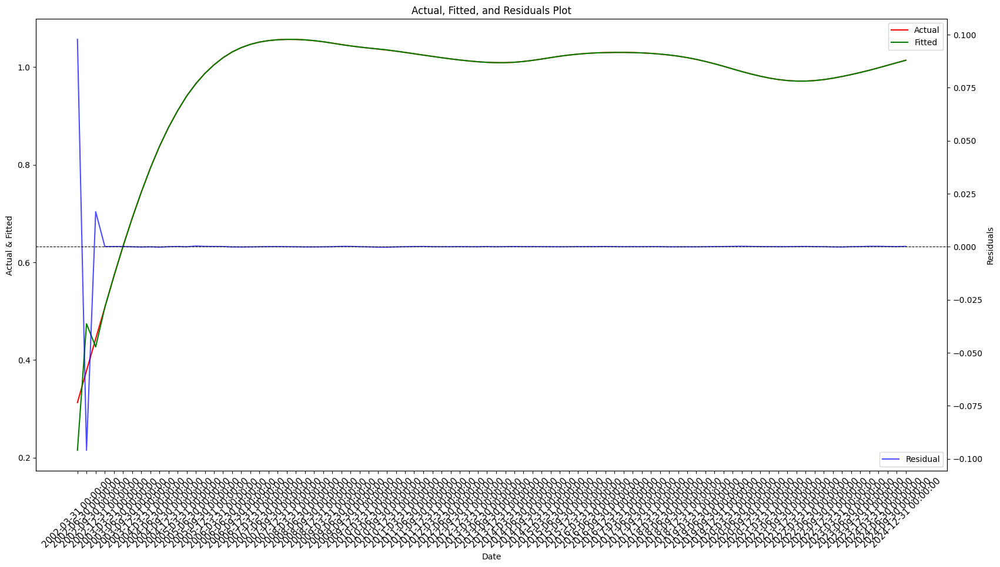

2 1 1
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(2, 1, 1)   Log Likelihood                 721.273
Date:                Tue, 04 Mar 2025   AIC                          -1430.545
Time:                        04:59:49   BIC                          -1415.613
Sample:                    03-31-2002   HQIC                         -1424.527
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569   3.99e-05  -3933.555      0.000      -0.157      -0.157
M_SA           1.0494      0.000   7170.954      0.000       1.049       1.050
ar.L1          1.9402      0.003    615.197   

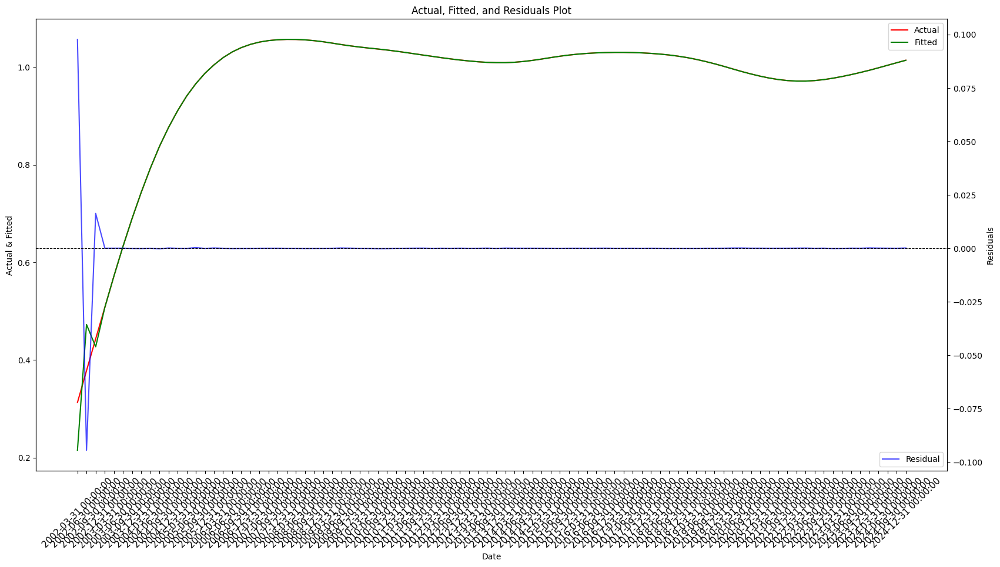

2 1 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(2, 1, 2)   Log Likelihood                 708.399
Date:                Tue, 04 Mar 2025   AIC                          -1402.799
Time:                        04:59:50   BIC                          -1385.457
Sample:                    03-31-2002   HQIC                         -1395.812
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569   4.69e-05  -3346.227      0.000      -0.157      -0.157
M_SA           1.0494      0.000   3984.122      0.000       1.049       1.050
ar.L1          1.9262      0.004    482.902   

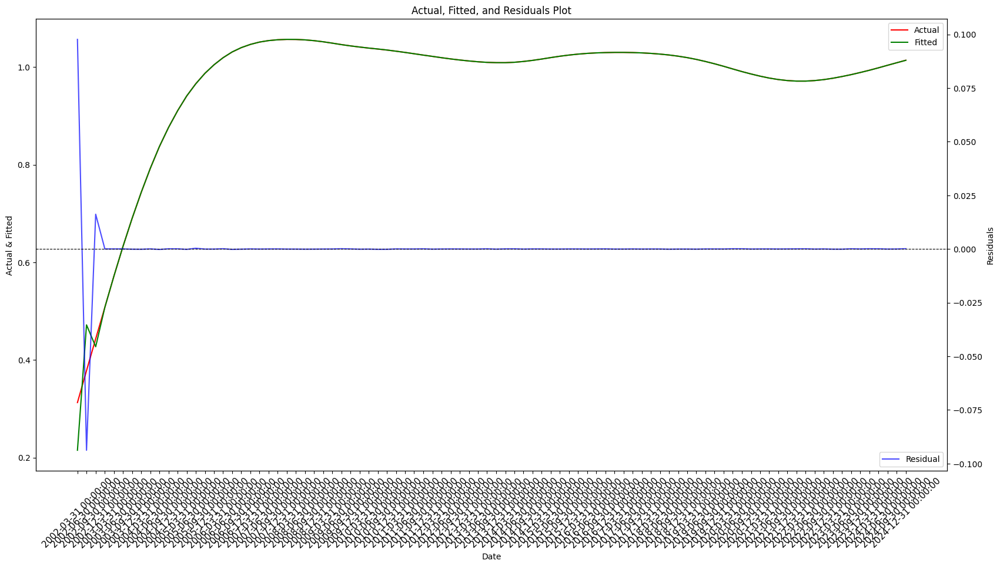

2 1 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(2, 1, 3)   Log Likelihood                 715.211
Date:                Tue, 04 Mar 2025   AIC                          -1414.422
Time:                        04:59:51   BIC                          -1394.695
Sample:                    03-31-2002   HQIC                         -1406.478
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569   5.17e-05  -3035.501      0.000      -0.157      -0.157
M_SA           1.0494      0.000   7242.121      0.000       1.049       1.050
ar.L1          1.9180      0.004    439.798   

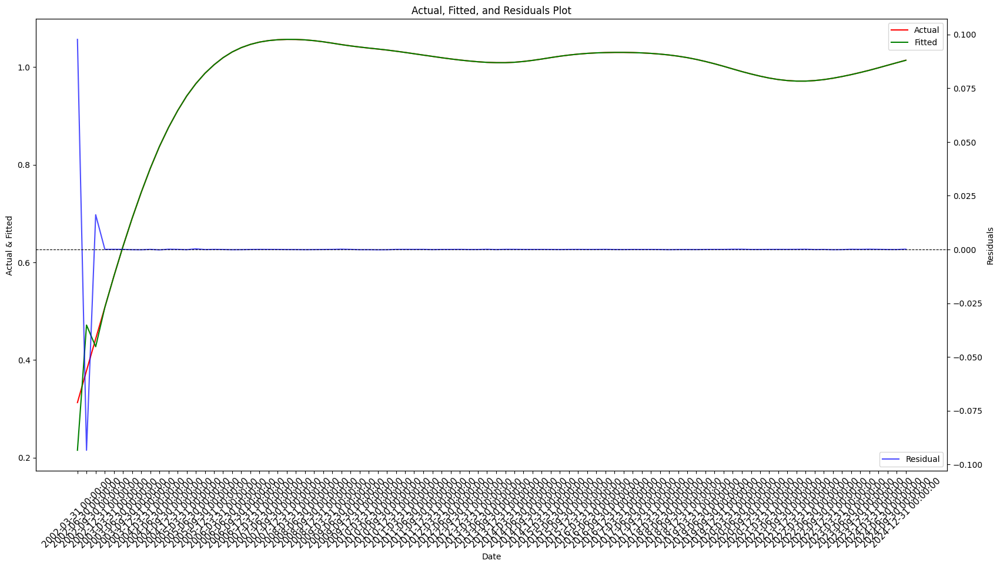

2 1 4
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(2, 1, 4)   Log Likelihood                 716.920
Date:                Tue, 04 Mar 2025   AIC                          -1415.840
Time:                        04:59:53   BIC                          -1393.751
Sample:                    03-31-2002   HQIC                         -1406.950
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569   3.53e-05  -4444.327      0.000      -0.157      -0.157
M_SA           1.0494   9.68e-05   1.08e+04      0.000       1.049       1.050
ar.L1          1.9279      0.003    610.108   

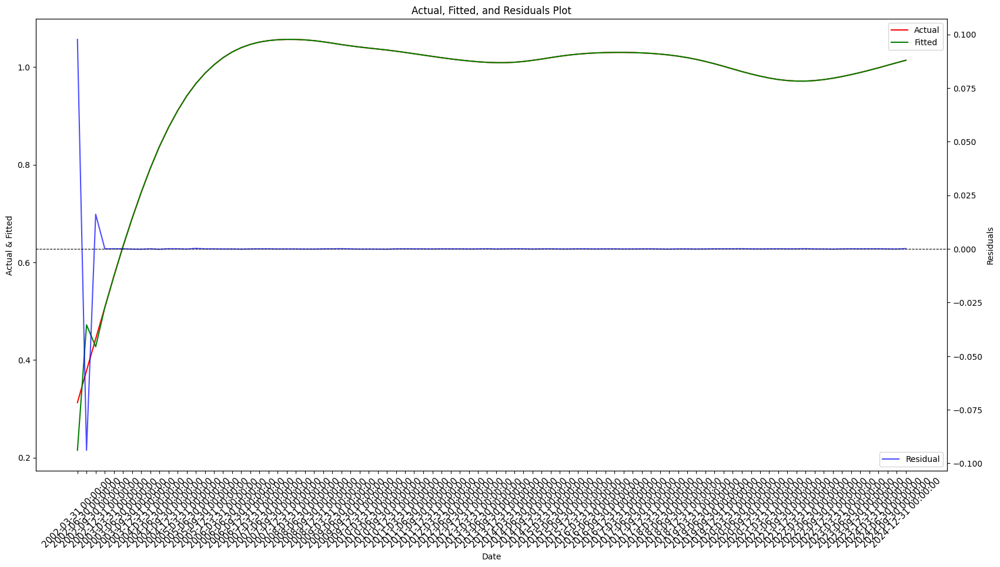

3 0 0
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 0, 0)   Log Likelihood                 707.486
Date:                Tue, 04 Mar 2025   AIC                          -1402.972
Time:                        04:59:54   BIC                          -1388.040
Sample:                    03-31-2002   HQIC                         -1396.953
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.0044      0.002     -1.977      0.048      -0.009   -3.68e-05
M_SA           1.0074      0.003    359.053      0.000       1.002       1.013
ar.L1          2.9119      0.002   1197.563   

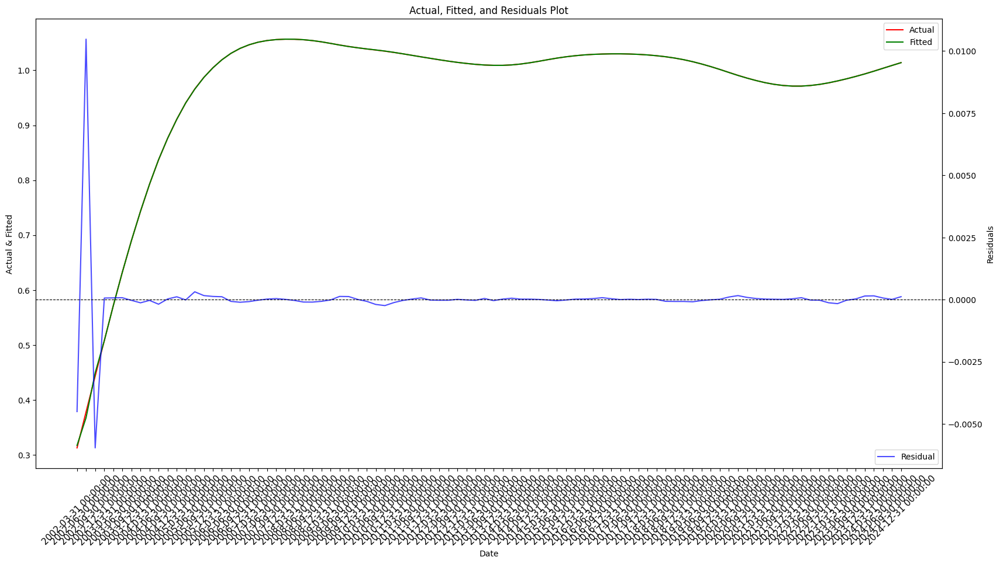

3 0 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 0, 2)   Log Likelihood                 718.216
Date:                Tue, 04 Mar 2025   AIC                          -1420.432
Time:                        04:59:55   BIC                          -1400.523
Sample:                    03-31-2002   HQIC                         -1412.408
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.0044      0.002     -2.714      0.007      -0.008      -0.001
M_SA           1.0074      0.002    530.242      0.000       1.004       1.011
ar.L1          2.7764      0.004    658.400   

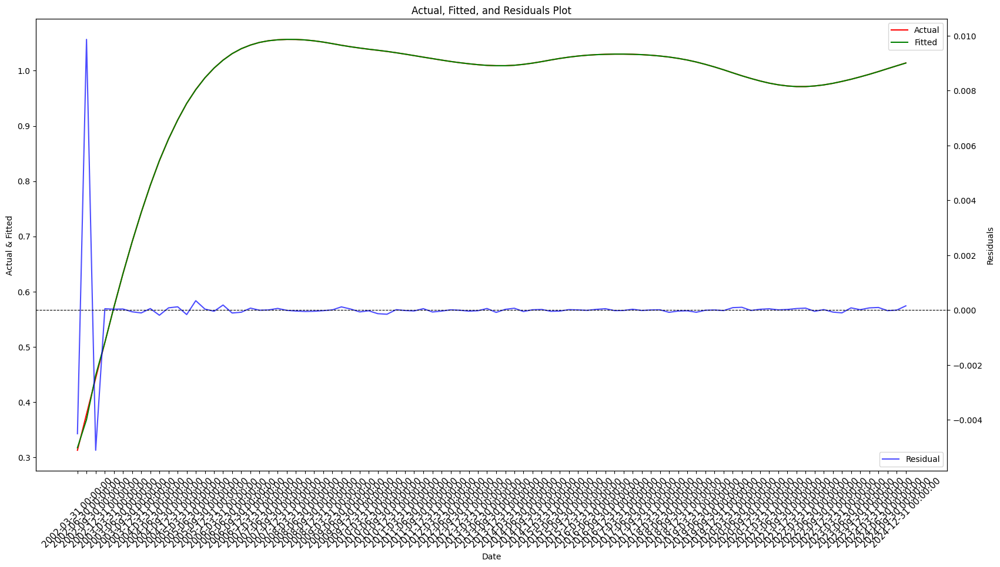

3 0 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 0, 3)   Log Likelihood                 738.377
Date:                Tue, 04 Mar 2025   AIC                          -1458.755
Time:                        04:59:56   BIC                          -1436.459
Sample:                    03-31-2002   HQIC                         -1449.772
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.0044      0.001     -3.865      0.000      -0.007      -0.002
M_SA           1.0074      0.001    793.131      0.000       1.005       1.010
ar.L1          2.6125      0.004    593.987   

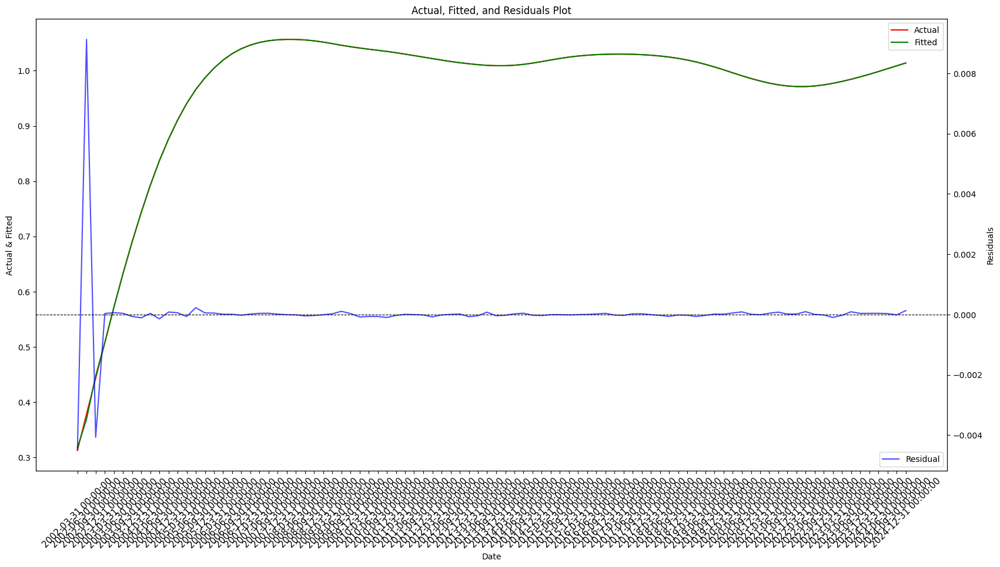

3 0 4
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 0, 4)   Log Likelihood                 730.304
Date:                Tue, 04 Mar 2025   AIC                          -1440.608
Time:                        04:59:58   BIC                          -1415.949
Sample:                    03-31-2002   HQIC                         -1430.679
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.0044      0.001     -3.422      0.001      -0.007      -0.002
M_SA           1.0074      0.001    688.146      0.000       1.005       1.010
ar.L1          2.6961      0.004    712.494   

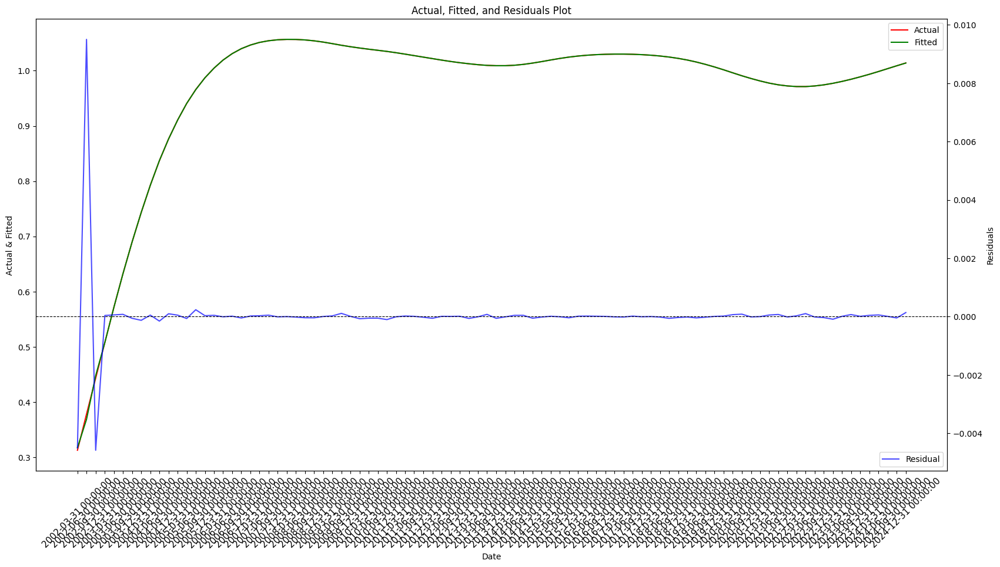

3 1 0
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 1, 0)   Log Likelihood                 714.750
Date:                Tue, 04 Mar 2025   AIC                          -1417.500
Time:                        04:59:59   BIC                          -1402.636
Sample:                    03-31-2002   HQIC                         -1411.512
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569   6.98e-06  -2.25e+04      0.000      -0.157      -0.157
M_SA           1.0494   1.12e-05   9.37e+04      0.000       1.049       1.049
ar.L1          2.5534      0.002   1688.563   

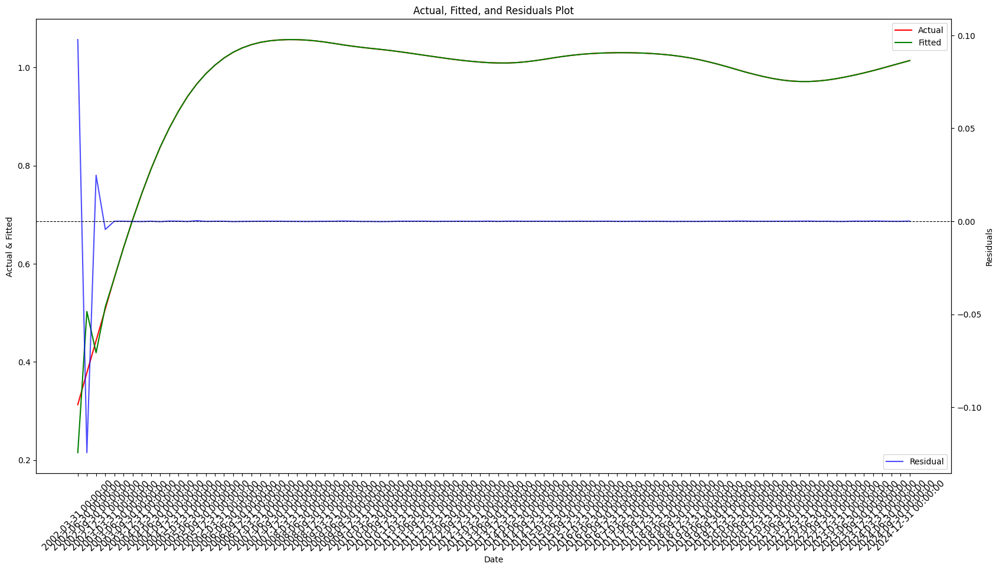

3 1 1
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 1, 1)   Log Likelihood                 710.527
Date:                Tue, 04 Mar 2025   AIC                          -1407.054
Time:                        05:00:01   BIC                          -1389.713
Sample:                    03-31-2002   HQIC                         -1400.068
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569      0.002    -99.022      0.000      -0.160      -0.154
M_SA           1.0494      0.016     64.790      0.000       1.018       1.081
ar.L1          1.4697      0.003    514.346   

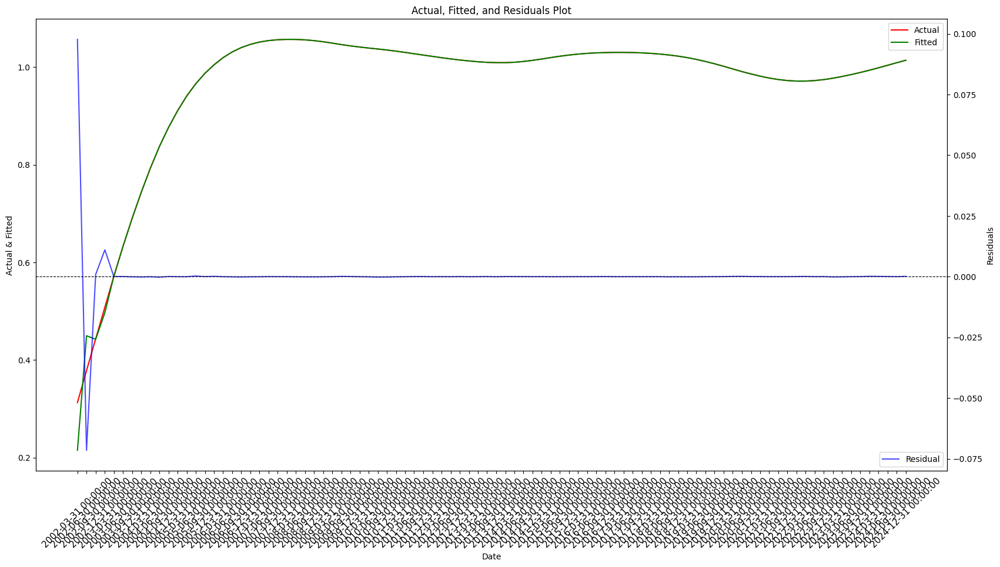

3 1 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 1, 2)   Log Likelihood                 713.369
Date:                Tue, 04 Mar 2025   AIC                          -1410.739
Time:                        05:00:02   BIC                          -1390.920
Sample:                    03-31-2002   HQIC                         -1402.754
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569   2.38e-05  -6580.954      0.000      -0.157      -0.157
M_SA           1.0494    8.5e-05   1.23e+04      0.000       1.049       1.050
ar.L1          2.1415      0.002    876.639   

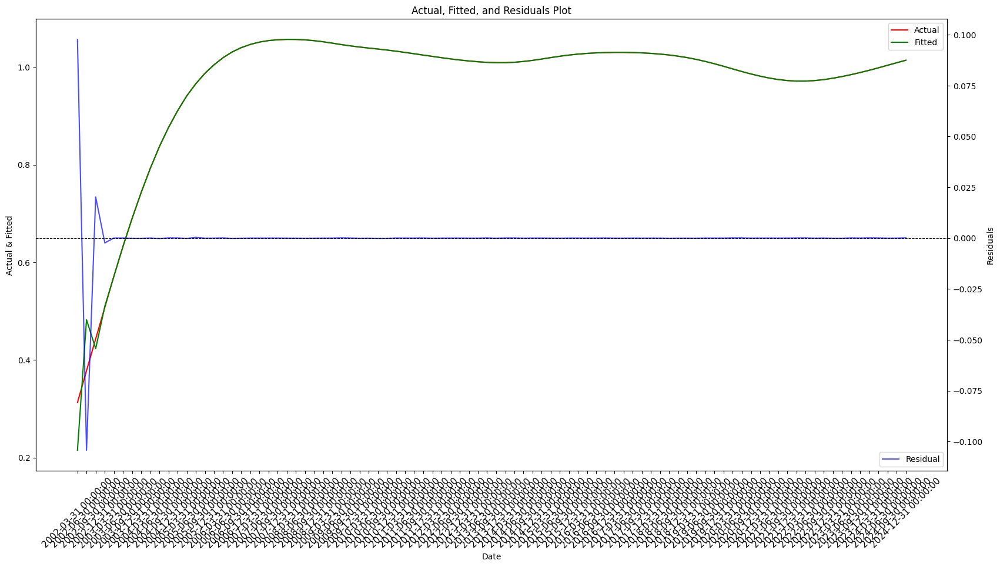

3 1 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 1, 3)   Log Likelihood                 713.574
Date:                Tue, 04 Mar 2025   AIC                          -1409.148
Time:                        05:00:03   BIC                          -1386.955
Sample:                    03-31-2002   HQIC                         -1400.212
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569   1.94e-05  -8077.148      0.000      -0.157      -0.157
M_SA           1.0494   3.38e-05    3.1e+04      0.000       1.049       1.049
ar.L1          2.1843      0.002    942.315   

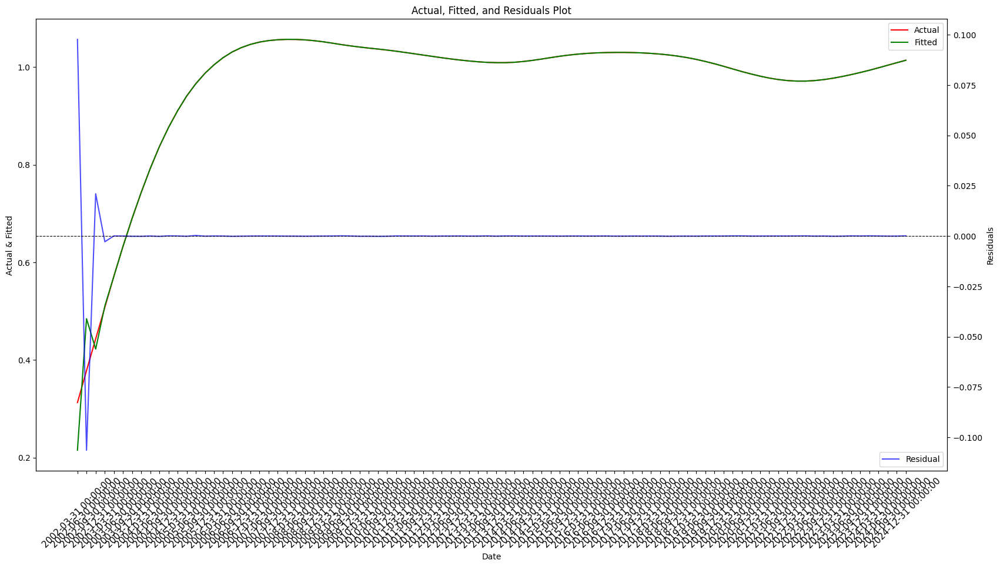

3 1 4
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 1, 4)   Log Likelihood                 717.387
Date:                Tue, 04 Mar 2025   AIC                          -1414.774
Time:                        05:00:06   BIC                          -1390.230
Sample:                    03-31-2002   HQIC                         -1404.896
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569   3.07e-06  -5.12e+04      0.000      -0.157      -0.157
M_SA           1.0494   4.81e-06   2.18e+05      0.000       1.049       1.049
ar.L1          2.5604      0.001   3171.694   

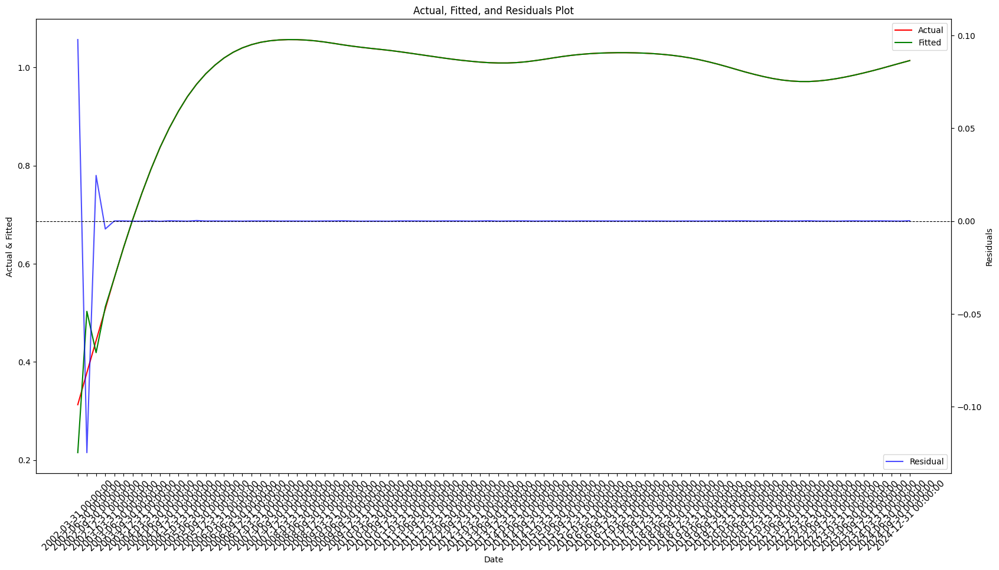

4 0 0
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(4, 0, 0)   Log Likelihood                 721.131
Date:                Tue, 04 Mar 2025   AIC                          -1428.262
Time:                        05:00:07   BIC                          -1410.921
Sample:                    03-31-2002   HQIC                         -1421.276
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.0044      0.001     -3.782      0.000      -0.007      -0.002
M_SA           1.0074      0.001    776.640      0.000       1.005       1.010
ar.L1          3.4921      0.001   3086.815   

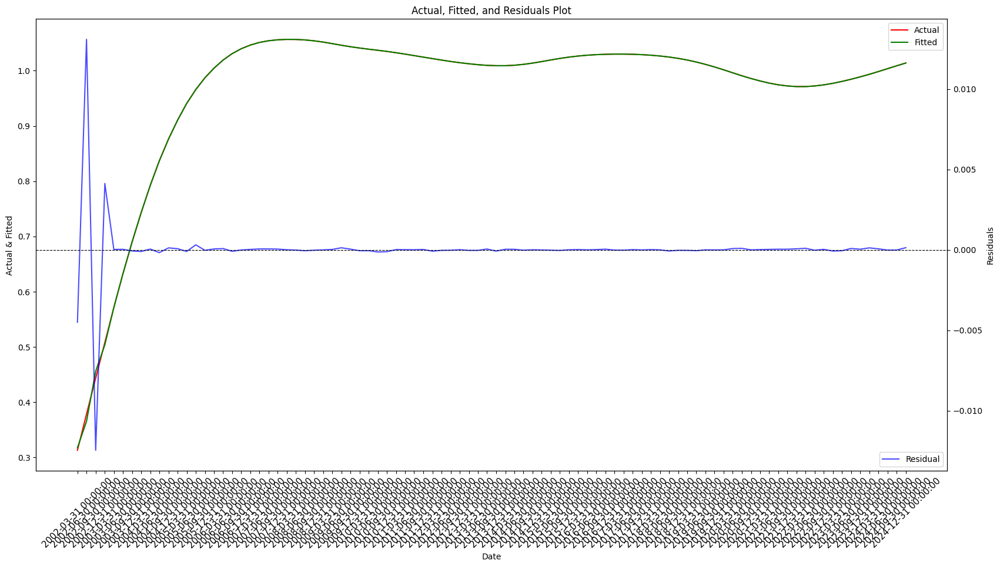

4 0 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(4, 0, 2)   Log Likelihood                 721.715
Date:                Tue, 04 Mar 2025   AIC                          -1425.430
Time:                        05:00:09   BIC                          -1403.134
Sample:                    03-31-2002   HQIC                         -1416.447
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.0044      0.001     -3.327      0.001      -0.007      -0.002
M_SA           1.0074      0.001    676.170      0.000       1.004       1.010
ar.L1          3.3009      0.002   2119.812   

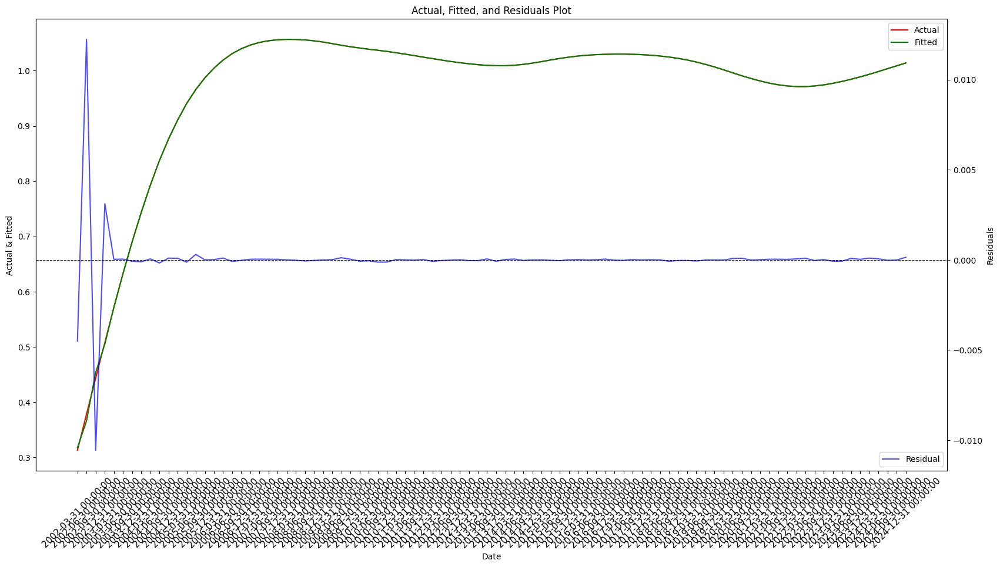

4 0 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(4, 0, 3)   Log Likelihood                 715.766
Date:                Tue, 04 Mar 2025   AIC                          -1411.531
Time:                        05:00:10   BIC                          -1386.758
Sample:                    03-31-2002   HQIC                         -1401.550
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.0044      0.001     -3.510      0.000      -0.007      -0.002
M_SA           1.0074      0.001    700.300      0.000       1.005       1.010
ar.L1          2.0526      0.003    655.854   

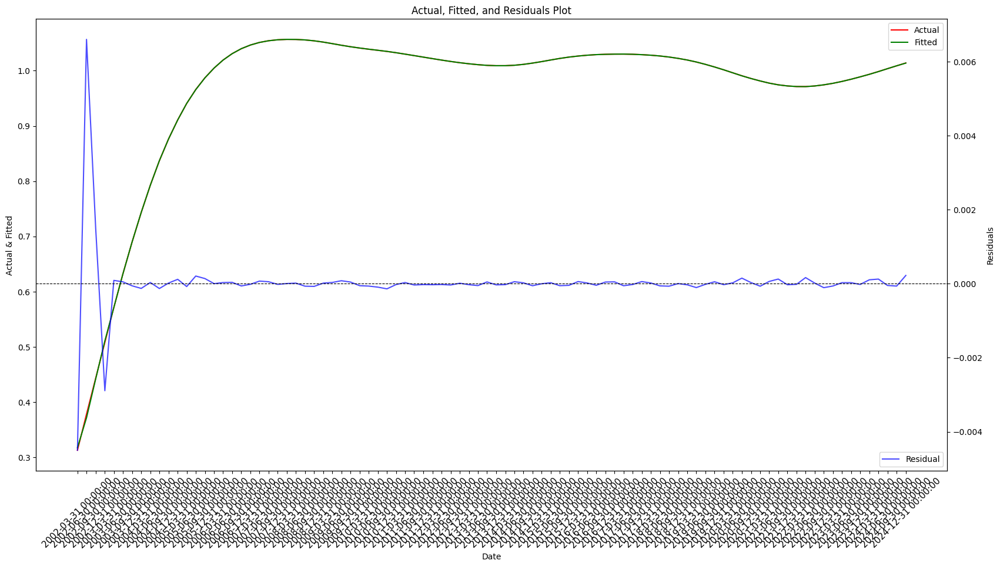

4 0 4
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(4, 0, 4)   Log Likelihood                 732.088
Date:                Tue, 04 Mar 2025   AIC                          -1442.175
Time:                        05:00:12   BIC                          -1415.050
Sample:                    03-31-2002   HQIC                         -1431.253
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.0044      0.002     -2.924      0.003      -0.007      -0.001
M_SA           1.0074      0.002    604.582      0.000       1.004       1.011
ar.L1          3.2292      0.001   2314.492   

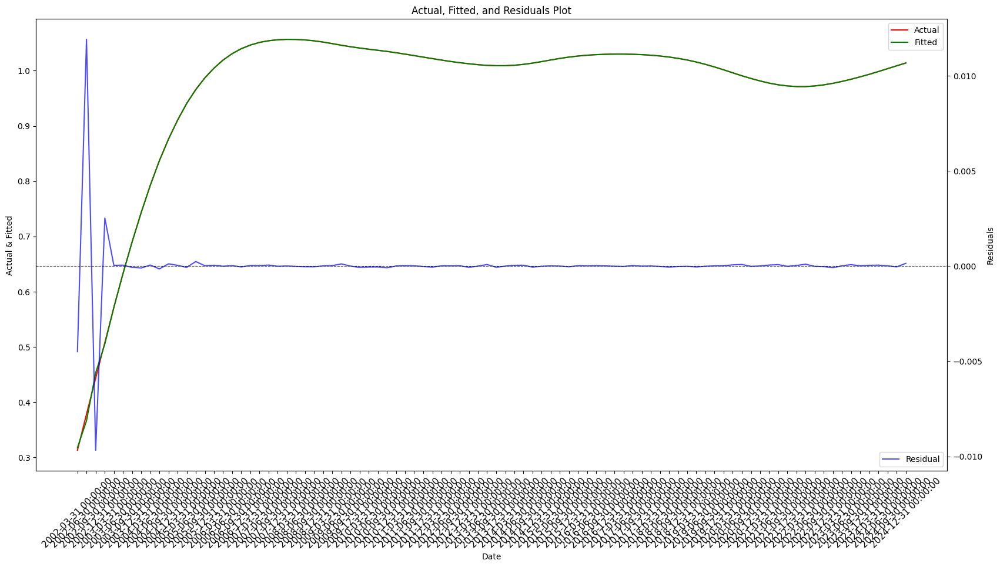

4 1 0
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(4, 1, 0)   Log Likelihood                 706.645
Date:                Tue, 04 Mar 2025   AIC                          -1399.290
Time:                        05:00:14   BIC                          -1382.029
Sample:                    03-31-2002   HQIC                         -1392.340
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569   5.99e-05  -2619.570      0.000      -0.157      -0.157
M_SA           1.0494      0.001    839.043      0.000       1.047       1.052
ar.L1          2.6121      0.007    355.567   

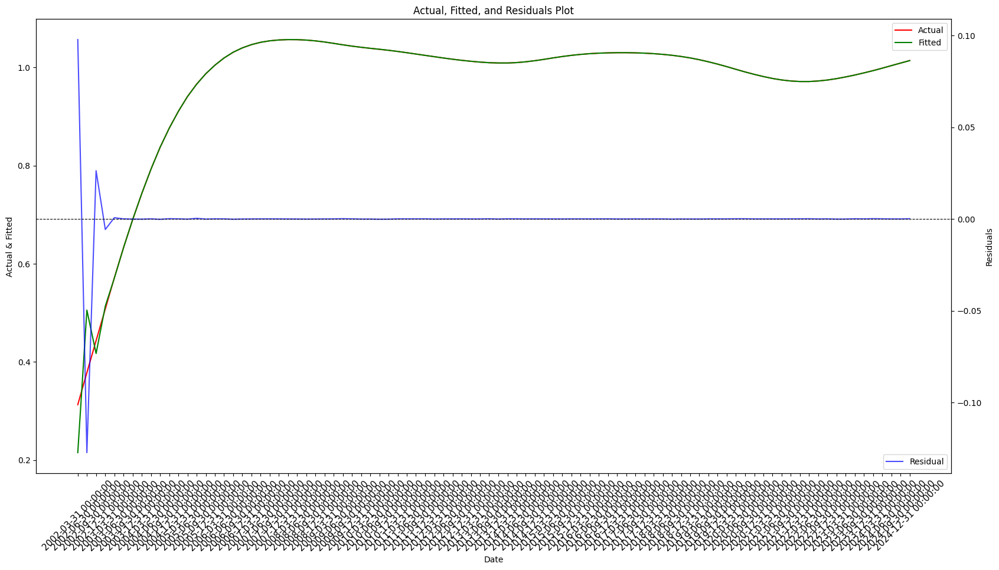

4 1 1
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(4, 1, 1)   Log Likelihood                 696.042
Date:                Tue, 04 Mar 2025   AIC                          -1376.084
Time:                        05:00:15   BIC                          -1356.356
Sample:                    03-31-2002   HQIC                         -1368.140
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569      0.001   -110.732      0.000      -0.160      -0.154
M_SA           1.0494      0.014     76.813      0.000       1.023       1.076
ar.L1          1.4206      0.002    576.232   

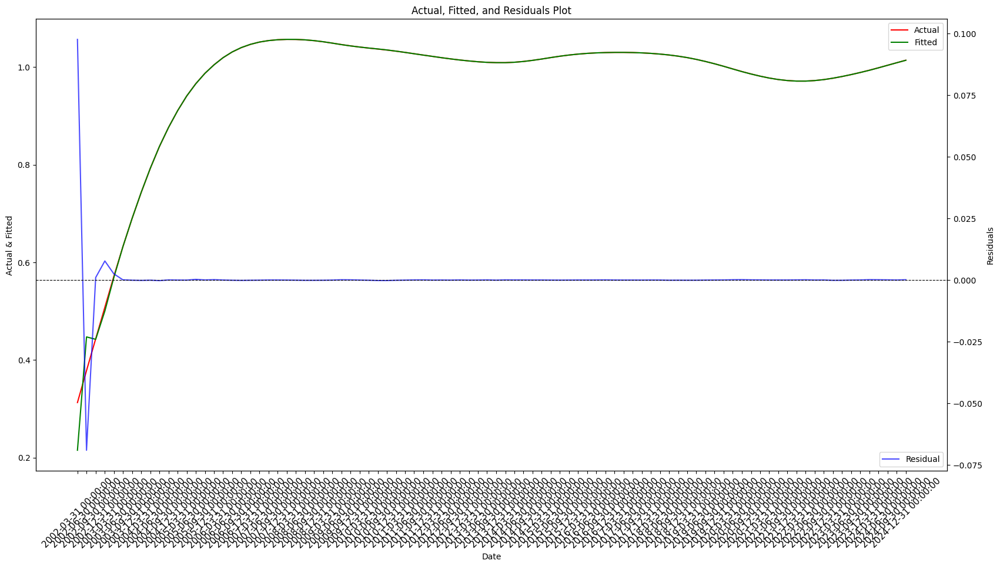

4 1 2
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(4, 1, 2)   Log Likelihood                 412.534
Date:                Tue, 04 Mar 2025   AIC                           -807.068
Time:                        05:00:16   BIC                           -784.875
Sample:                    03-31-2002   HQIC                          -798.132
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569   4.59e-19  -3.42e+17      0.000      -0.157      -0.157
M_SA           1.0494   9.93e-19   1.06e+18      0.000       1.049       1.049
ar.L1         32.0791   2.53e-19   1.27e+20   

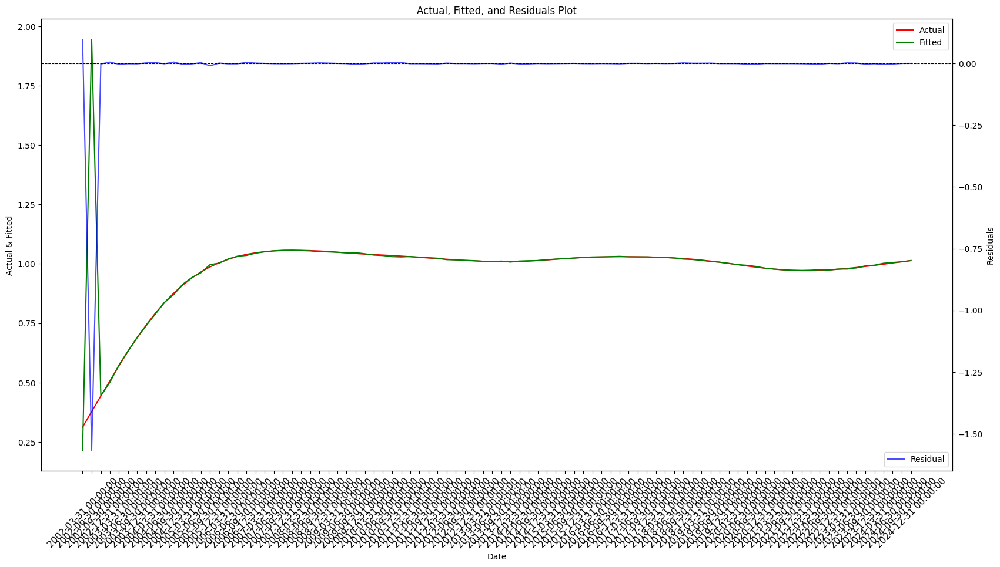

4 1 3
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(4, 1, 3)   Log Likelihood                 715.393
Date:                Tue, 04 Mar 2025   AIC                          -1410.785
Time:                        05:00:17   BIC                          -1386.126
Sample:                    03-31-2002   HQIC                         -1400.856
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569   1.25e-05  -1.26e+04      0.000      -0.157      -0.157
M_SA           1.0494   3.64e-05   2.88e+04      0.000       1.049       1.049
ar.L1          2.4729      0.002   1522.277   

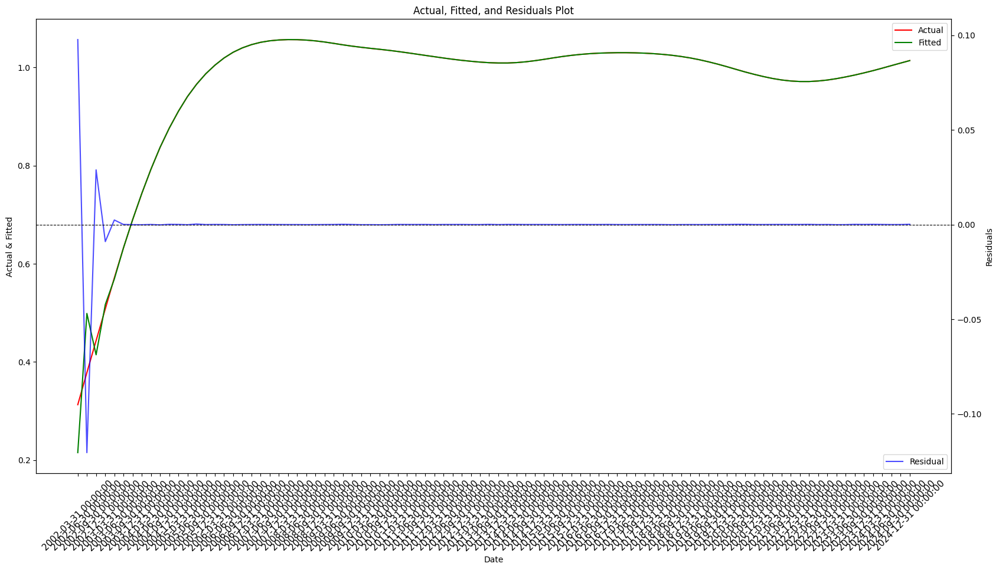

4 1 4
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(4, 1, 4)   Log Likelihood                 720.087
Date:                Tue, 04 Mar 2025   AIC                          -1418.174
Time:                        05:00:19   BIC                          -1391.176
Sample:                    03-31-2002   HQIC                         -1407.308
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.1569   5.83e-05  -2692.089      0.000      -0.157      -0.157
M_SA           1.0494      0.001   1185.739      0.000       1.048       1.051
ar.L1          2.6236      0.005    490.287   

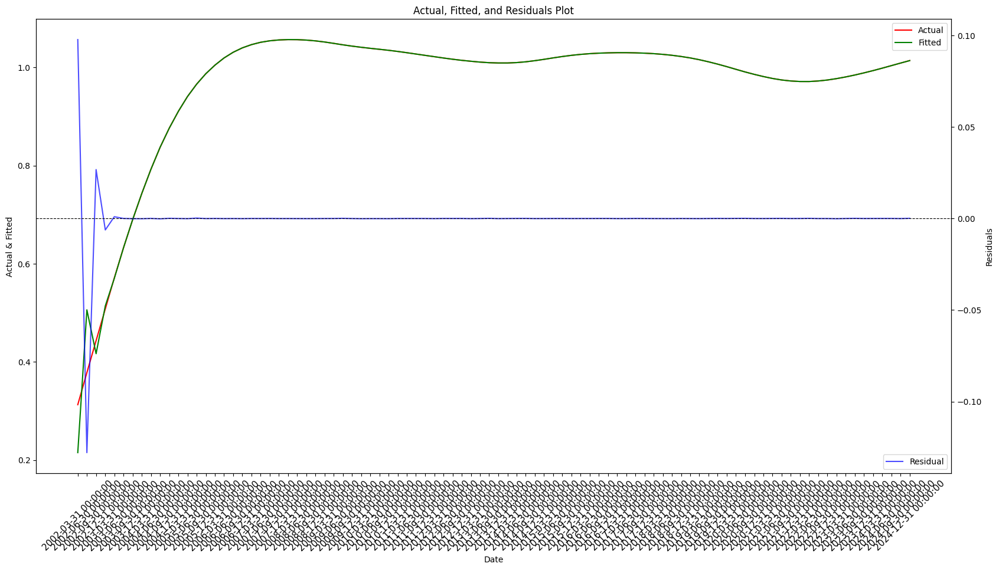

Лучшие параметры SARIMAX: (3, 0, 3)
                               SARIMAX Results                                
Dep. Variable:                   V_SA   No. Observations:                   92
Model:               SARIMAX(3, 0, 3)   Log Likelihood                 738.377
Date:                Tue, 04 Mar 2025   AIC                          -1458.755
Time:                        05:00:20   BIC                          -1436.459
Sample:                    03-31-2002   HQIC                         -1449.772
                         - 12-31-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
EXP_T         -0.0044      0.001     -3.865      0.000      -0.007      -0.002
M_SA           1.0074      0.001    793.131      0.000       1.005       1.010
ar.L1          2

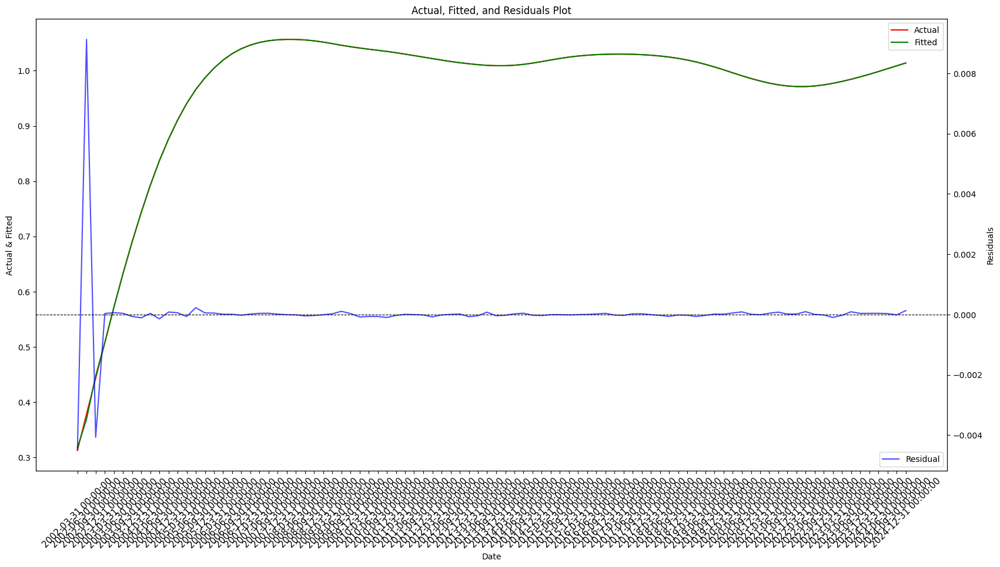

In [77]:
commodity_type = 'nFerr'
type_dct = {
    "date": df_transportation_volumes_indexed_adjusted[freq].index,
    "V_SA": df_transportation_volumes_indexed_adjusted[freq][commodity_type],   # Transport Volume Growth Index
    "EXP_T": df_transportation_tariff_indexed_adjusted[freq][commodity_type],   # Tariff growth index
    "M_SA": df_volumes_indexed_adjusted[freq][commodity_type],   # Production growth index
}

# Dummy-переменные
# dct_serial_data = construct_serial_data_by_type(commodity_type, df_volumes, dct_serial)
# for key, value in dct_serial_data.items():
#     type_dct[key] = value

df_type = pd.DataFrame(type_dct)

df_type.set_index('date', inplace=True)

# Целевая переменная и регрессоры
Y = df_type["V_SA"]
X = df_type.drop(columns=["V_SA"])  # Убираем целевую переменную
# Подбор оптимальных p, d, q
p_values = range(0, 5)
d_values = range(0, 2)
q_values = range(0, 5)

best_aic = float("inf")
best_order = None
best_model = None

for p, d, q in tqdm(itertools.product(p_values, d_values, q_values)):
    try:
        model = sm.tsa.statespace.SARIMAX(Y, exog=X, order=(p, d, q), seasonal_order=(0, 0, 0, 0),
                                          enforce_stationarity=False, enforce_invertibility=False)
        results = model.fit(disp=False)

        # Достаем коэффициент и p-value для "T"
        coef_T = results.params.get("EXP_T", None)
        pval_T = results.pvalues.get("EXP_T", None)

        # Условие: коэффициент при T должен быть отрицательным и значимым (p < 0.05)
        if coef_T is not None and coef_T < 0 and pval_T is not None and pval_T < 0.05:
            if results.aic < best_aic:
                best_aic = results.aic
                best_order = (p, d, q)
                best_model = results
            print(p, d, q)
            print(results.summary())
            plot_regression_results(results, df_type)

    except:
        continue

# Вывод результатов
if best_model:
    print(f"Лучшие параметры SARIMAX: {best_order}")
    print(best_model.summary())
    plot_regression_results(best_model, df_type)
else:
    print("Не удалось найти подходящую модель, удовлетворяющую условиям.")

## 🐆 Plot Results

In [78]:
# "commodity_type": [const, coef(EXP_T), num_points]

dct_model_params = {"уголь": [0, -0.16, 16], "железная руда": [0.41, -3.01, 16], "нефтепродукты": [0.5, -0.45, 16], 'цветные металлы': [0.83, -0.16, 16], 'зерно': [0.0489, -0.05, 16], "химикаты и сода": [0.04, -0.65, 16]}

In [79]:
def calc_elasticity(a, b, T):
    # T - tariff increase
    # a, b - model coefficients
    if a != 0:
        res = b * T / 100 / (a + b * T / 100) * 100
    else:
       res = b * T
    if res < -100 or res > 0:
        return -100
    else:
        return res

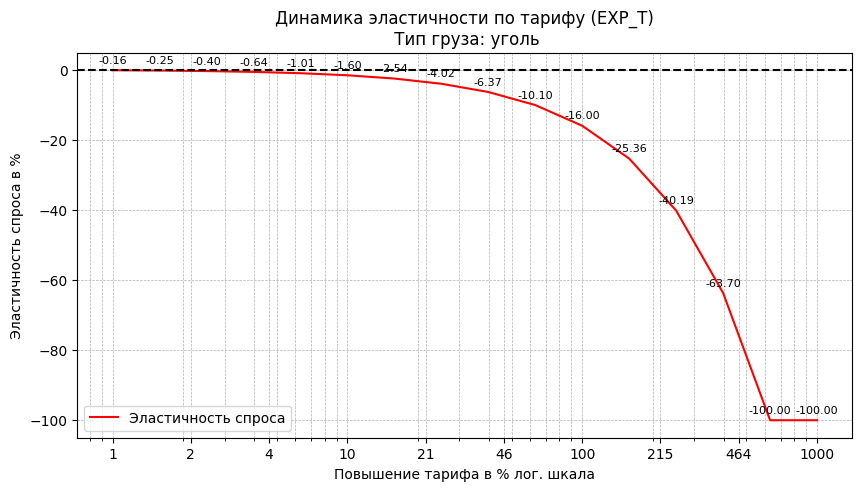

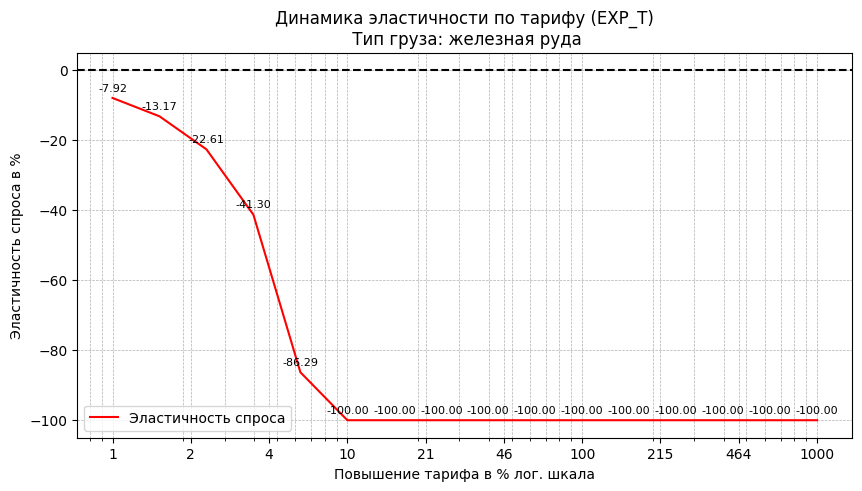

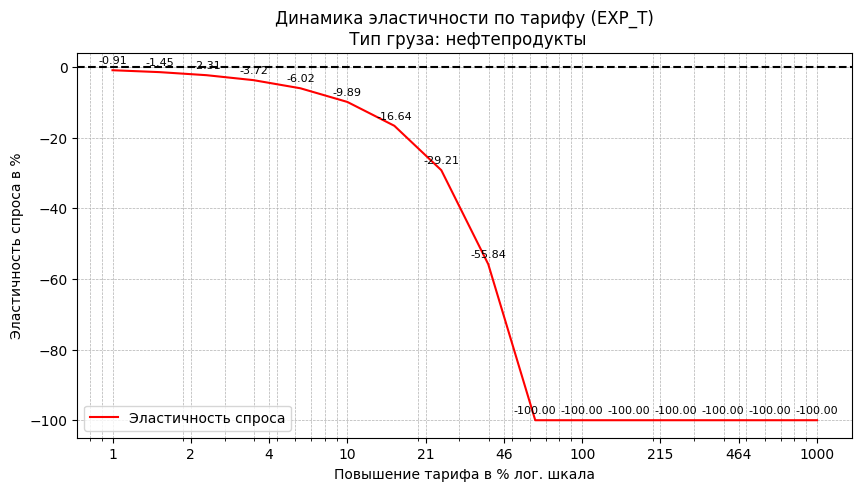

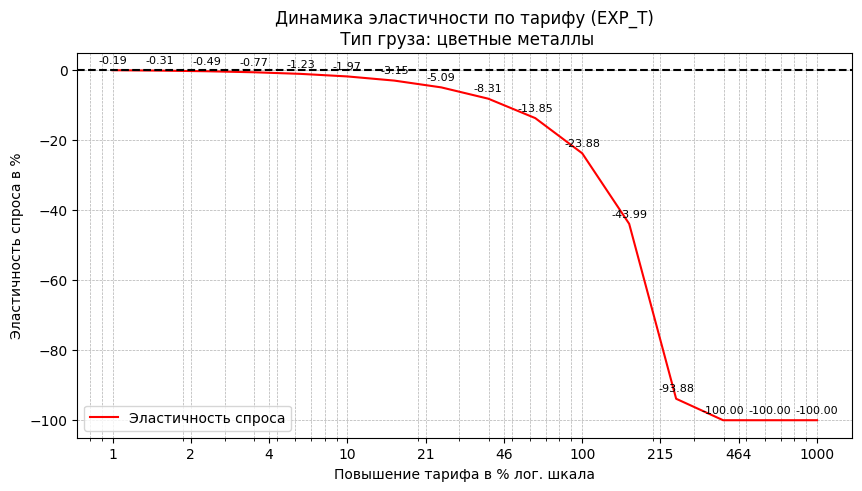

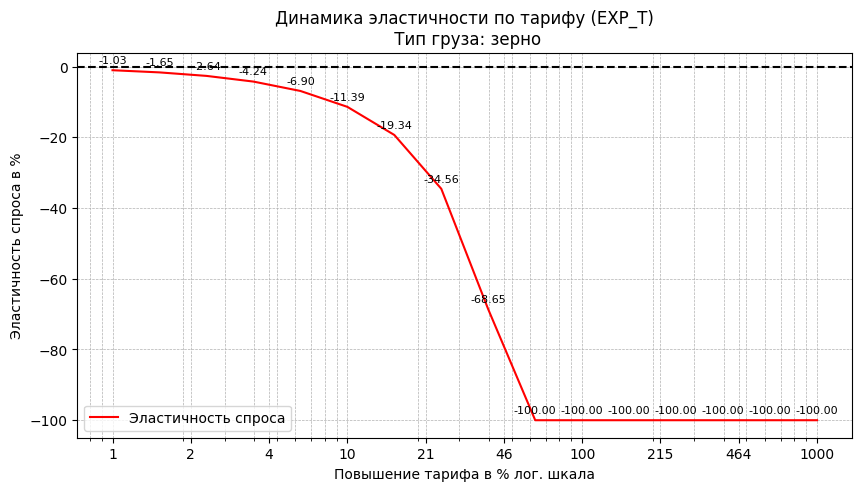

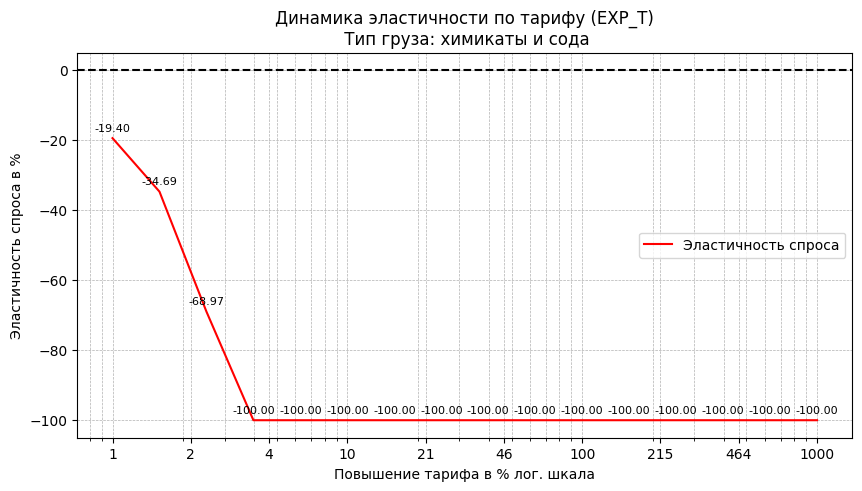

In [80]:
max_val = 1000  # Максимальное значение тарифа

for key, val in dct_model_params.items():
    T_values = np.logspace(0, np.log10(max_val), val[2])  # Генерируем больше значений T
    values = [calc_elasticity(val[0], val[1], T) for T in T_values]
    # print(key)
    # for i in range(len(values)):
    #   print(f'{i} val:', T_values[i], values[i])
    plt.figure(figsize=(10, 5))
    plt.plot(T_values, values, color='red', label="Эластичность спроса")
    plt.axhline(y=0, color='black', linestyle='--')

    # Подписываем **все точки** на кривой
    for i in range(len(values)):
        plt.annotate(f"{values[i]:.2f}", (T_values[i], values[i]),
                     textcoords="offset points", xytext=(0, 5), ha='center', fontsize=8)

    plt.xlabel("Повышение тарифа в % лог. шкала")
    plt.ylabel("Эластичность спроса в %")
    plt.title(f"Динамика эластичности по тарифу (EXP_T)\n Тип груза: {key}")
    plt.xscale('log')  # Логарифмическая шкала для лучшей визуализации
    plt.legend()
    plt.grid(True, which='both', linestyle='--', linewidth=0.5)  # Добавляем сетку

    # ✅ Добавляем **больше подписей** по оси X
    tick_positions = np.logspace(0, np.log10(max_val), 10)  # 10 равномерных точек
    plt.xticks(tick_positions, [f"{int(x)}" for x in tick_positions])

    plt.show()
